In [1]:
import time
import re
import pylab as pl
import numpy as np
import pylab as pl

from datetime import datetime, timedelta

import subprocess
from collections import defaultdict
import os
import pandas as pd

import concurrent.futures

import matplotlib.ticker as mticker

from joblib import Parallel, delayed
import shutil
import math


from concurrent.futures import ThreadPoolExecutor, ProcessPoolExecutor

In [2]:
SMALL_SIZE = 27
MEDIUM_SIZE = 45
BIGGER_SIZE = 22

pl.rc('font', size=BIGGER_SIZE)          # controls default text sizes
pl.rc('axes', titlesize=45)     # fontsize of the axes title
pl.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
pl.rc('xtick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
pl.rc('ytick', labelsize=MEDIUM_SIZE)    # fontsize of the tick labels
pl.rc('legend', fontsize=45)    # legend fontsize
pl.rc('figure', titlesize=BIGGER_SIZE) 



formatter = mticker.ScalarFormatter(useMathText=True)
formatter.set_powerlimits((-3, 2)) 
formatter.set_useOffset(False)

In [3]:
import os

folder_path = "../../../Experiments/O2PRBC_single_collect_test96/dump_files/"  # Change this to your folder path
keywords = ["got", "send new cmd"]

# Iterate through all files in the folder
for filename in os.listdir(folder_path):
    file_path = os.path.join(folder_path, filename)

    # Check if it's a file
    if os.path.isfile(file_path):
        with open(file_path, "r") as file:
            lines = file.readlines()

        # Filter out lines containing keywords
        filtered_lines = [line for line in lines if not any(keyword in line for keyword in keywords)]

        # Overwrite the file with filtered content
        with open(file_path, "w") as file:
            file.writelines(filtered_lines)

print("Lines removed successfully!")

FileNotFoundError: [Errno 2] No such file or directory: '../../../Experiments/O2PRBC_single_collect_test96/dump_files/'

In [3]:

def str2datetime(s):
    parts = s.split('.')
    dt = datetime.strptime(parts[0], "%Y-%m-%d %H:%M:%S")
    return dt.replace(microsecond=int(parts[1]))


def remove_outliers(x, outlierConstant = 1.5):
    a = np.array(x)
    upper_quartile = np.percentile(a, 75)
    lower_quartile = np.percentile(a, 25)
    IQR = (upper_quartile - lower_quartile) * outlierConstant
    quartileSet = (lower_quartile - IQR, upper_quartile + IQR)
    resultList = []
    removedList = []
    for y in a.tolist():
        if y >= quartileSet[0] and y <= quartileSet[1]:
            resultList.append(y)
        else:
            removedList.append(y)
    return (resultList, removedList)
def getThroughput(experiment):
    
    temp_lines = []

    result = subprocess.check_output('cat ../'+experiment+'/dump_files/nohup_client_*', shell=True)


    result = result.decode("utf-8") 

    lines = result.split('\n')

    commit_pat = re.compile(r'([^[].*) \[hotstuff info\] ([0-9.]*)$')
#     commit_pat = re.compile('([^[].*) \[hotstuff info\] got*')

    Times = []
    lats = []

    for line in lines:
        m = commit_pat.match(line)
        if m:
            try:
                temp_lines.append(line)
                time_item = float((line.split(' ')[1]).split(':')[0])*3600 + float((line.split(' ')[1]).split(':')[1])*60 + \
                float((line.split(' ')[1]).split(':')[2])
                Times.append(time_item)        

                lats.append(float(m.group(2)))
            except:
                continue


    begin_time = None
    values = []
    interval = 1
    cnt = 0
    
    # Get sorted indices
    sorted_indices = np.argsort(Times)

    # Apply sorting to both arrays
    
    
    Times = np.array(Times)[sorted_indices.astype(np.int32)]
    lats_sorted = np.array(lats)[sorted_indices.astype(np.int32)]
    
    for timestamp in Times:
        if begin_time is None:
            begin_time = timestamp
            next_begin_time = timestamp +interval

        while timestamp >= next_begin_time:
            begin_time = next_begin_time
            next_begin_time += interval
            values.append(cnt)
            cnt = 0
        cnt += 1
    values.append(cnt)

#     lats, _ = remove_outliers(lats)
#     print(len(values))


    return np.arange(len(values))*interval,np.array(values)/interval, lats_sorted, temp_lines, Times


In [4]:
# X

../../Experiments/O2PRBC_lc


/tmp/ipykernel_93599/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_93599/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

8319.4
folder is  O2PRBC_lc


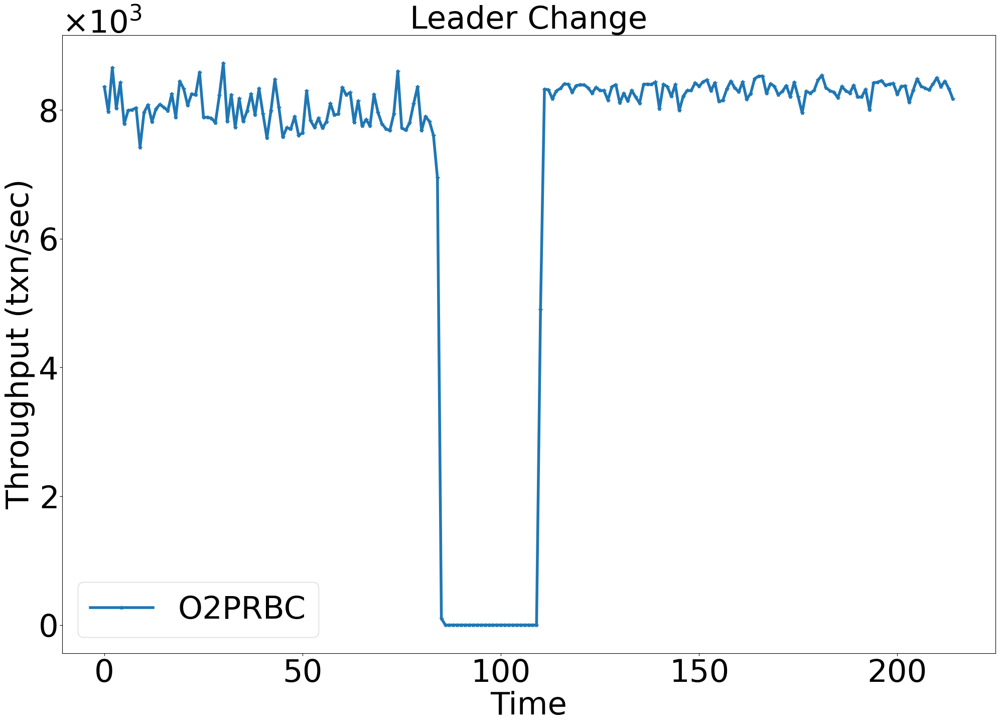

<Figure size 640x480 with 0 Axes>

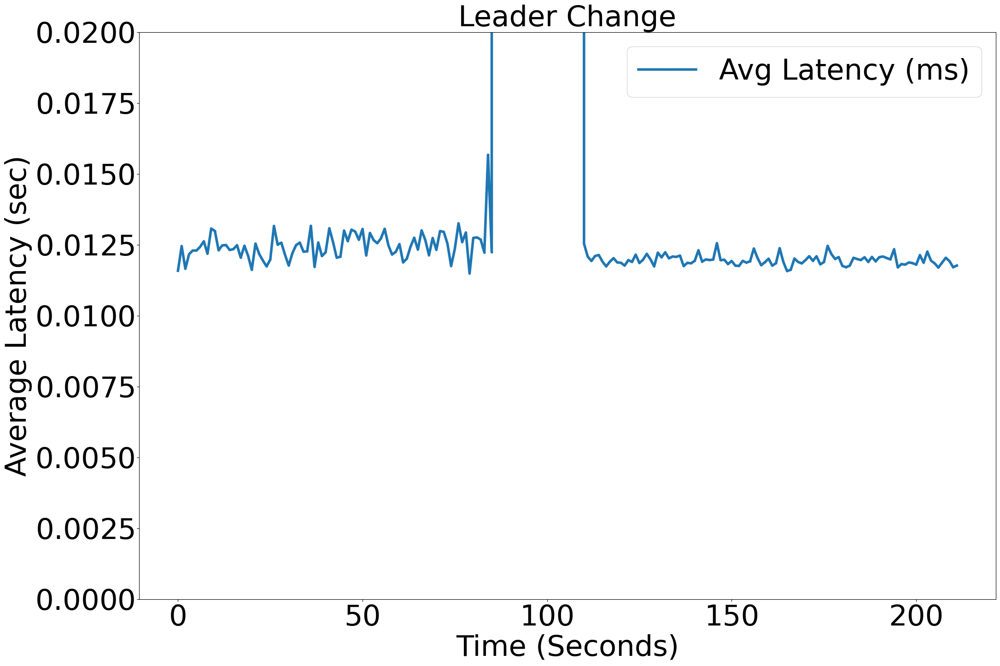

In [5]:
for folder in os.listdir('../../../Experiments/'):
    if   folder == 'O2PRBC_lc':
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Leader Change')
        pl.savefig('/home/tejas/Desktop/O2PRBC/lcthputs.png', dpi = 150, bbox_inches='tight' )

#         pl.ylim(7000,12000)
#         pl.savefig('../../../Experiments/hs_'+experiment+ '/thput.png', dpi =150, bbox_inches = 0 )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds[:-5], avg_latency_per_sec[:-5], marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (sec)")
        pl.ylim(0.,0.02)
        pl.title('Leader Change')
        pl.legend()
        pl.savefig('/home/tejas/Desktop/O2PRBC/lclats.png', dpi = 150, bbox_inches='tight' )

        # pl.grid()
        pl.show()

../../Experiments/O2PRBC_normaltxns


/tmp/ipykernel_5185/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_5185/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Depre

8633.28
folder is  O2PRBC_normaltxns


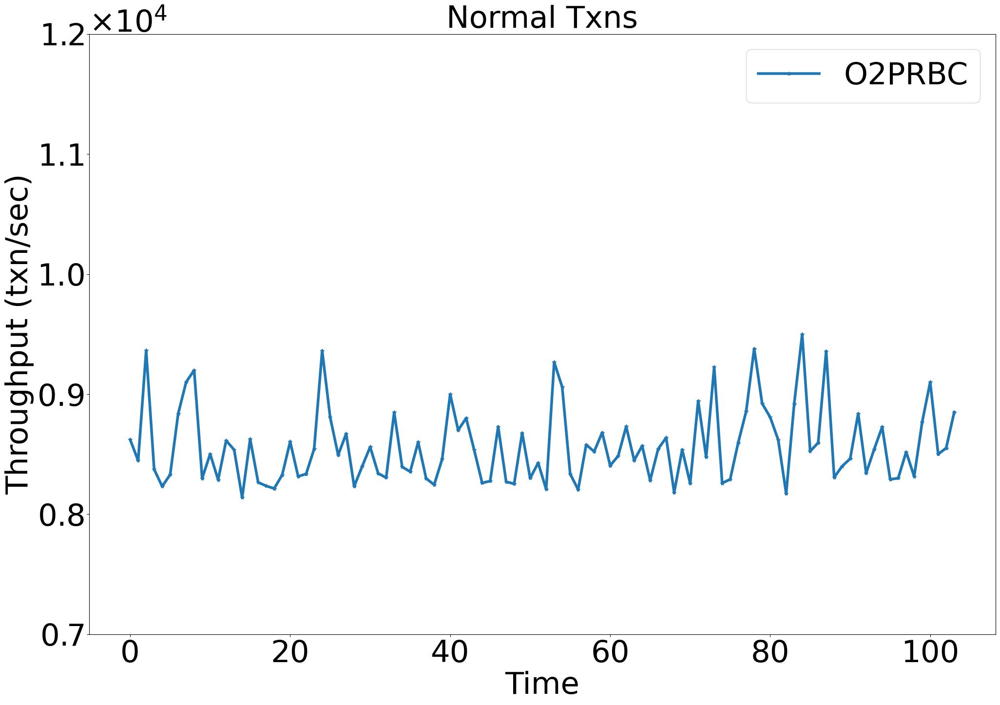

<Figure size 640x480 with 0 Axes>

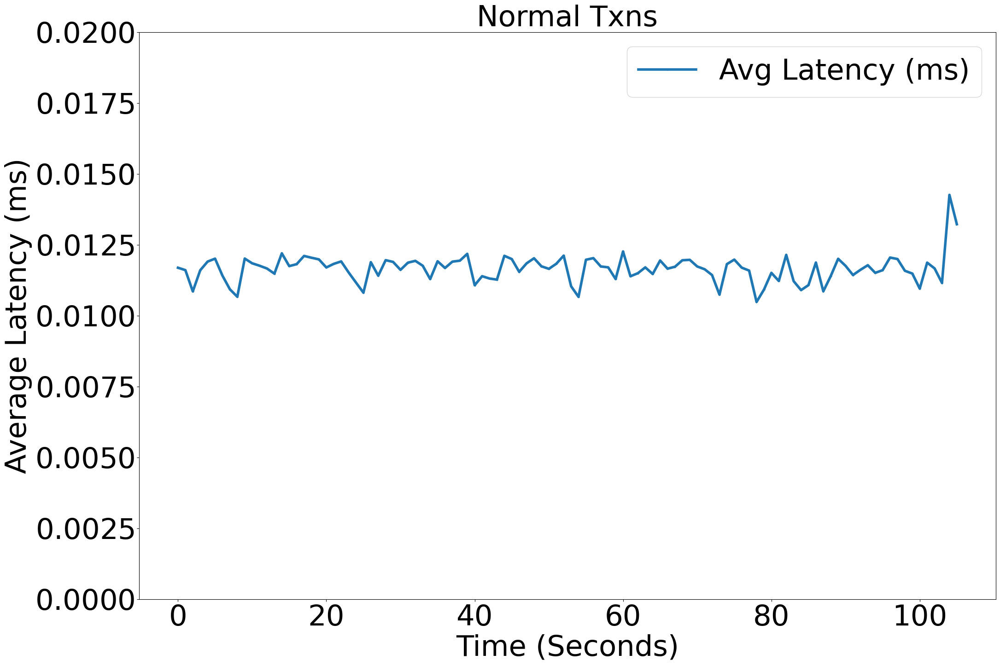

In [9]:
# for folder in os.listdir('../../../Experiments/'):
#     if   folder == 'O2PRBC_normaltxns':
        
        
        
#         experiment = '../../Experiments/' + folder 
#         print(experiment)
#         X,Y, lats, temp, Times = getThroughput(experiment)



# #         cluster_number = 

#         # Y = Y * cluster_number

#         lats

#         np.sum(Y)

#         s1, s2 = X[:-2],Y[:-2]

#         print(np.average(s2[-30:-5]))
#         np.average(lats[-33:-3])

#         len(lats)

#         2*18923.433333333334


#         experiment = folder
#         print('folder is ', folder)

#         if not os.path.exists('../../../Experiments/'+experiment):
#             os.mkdir('../../../Experiments/'+experiment)


#         fig,ax = pl.subplots(figsize = (24, 16))
#         fig.patch.set_facecolor('white')
#         fig.patch.set_facecolor('white')
#         pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
#         ax.yaxis.set_major_formatter(formatter)

#         pl.legend()
#         pl.xlabel('Time')
#         pl.ylabel('Throughput (txn/sec)')
#         pl.title('Normal Txns')

#         pl.ylim(7000,12000)
#         pl.savefig('/home/tejas/Desktop/O2PRBC/nthputs.png', dpi = 150, bbox_inches='tight' )
#         pl.show()
#         pl.clf()


#         int_times = Times.astype(int)

#         # Find the range of seconds
#         min_time, max_time = int_times.min(), int_times.max()
#         num_seconds = max_time - min_time + 1

#         # Compute sum of latencies per second
#         latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

#         # Compute count per second
#         counts = np.bincount(int_times - min_time, minlength=num_seconds)

#         # Avoid division by zero and compute average latency per second
#         avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

#         # Generate second timestamps
#         seconds = np.arange(min_time, max_time + 1)
#         seconds = seconds - seconds[0]
#         # Plot the results
#         fig,ax = pl.subplots(figsize = (24, 16))
#         fig.patch.set_facecolor('white')
#         pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
#                 label="Avg Latency (ms)", linewidth = 4)
        
#         ax.yaxis.set_major_formatter(formatter)

#         pl.xlabel("Time (Seconds)")
#         pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
#         pl.title('Normal Txns')
#         pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/nlats.png', dpi = 150, bbox_inches='tight' )

#         pl.show()

../../Experiments/O2PRBC_test


/tmp/ipykernel_80866/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_80866/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

10098.6
folder is  O2PRBC_test


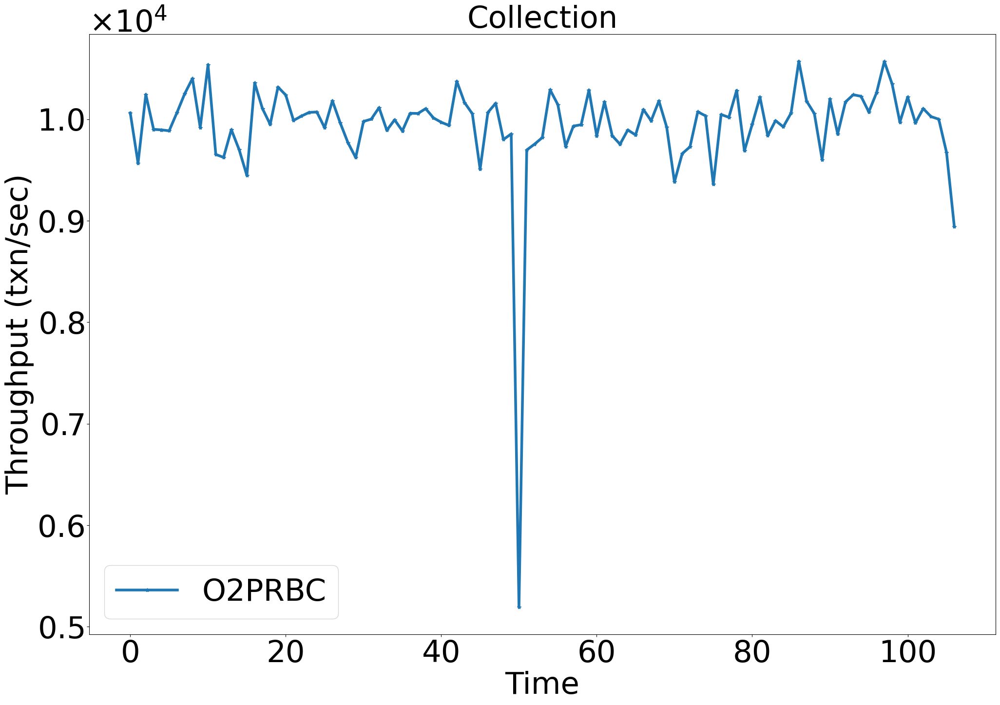

<Figure size 640x480 with 0 Axes>

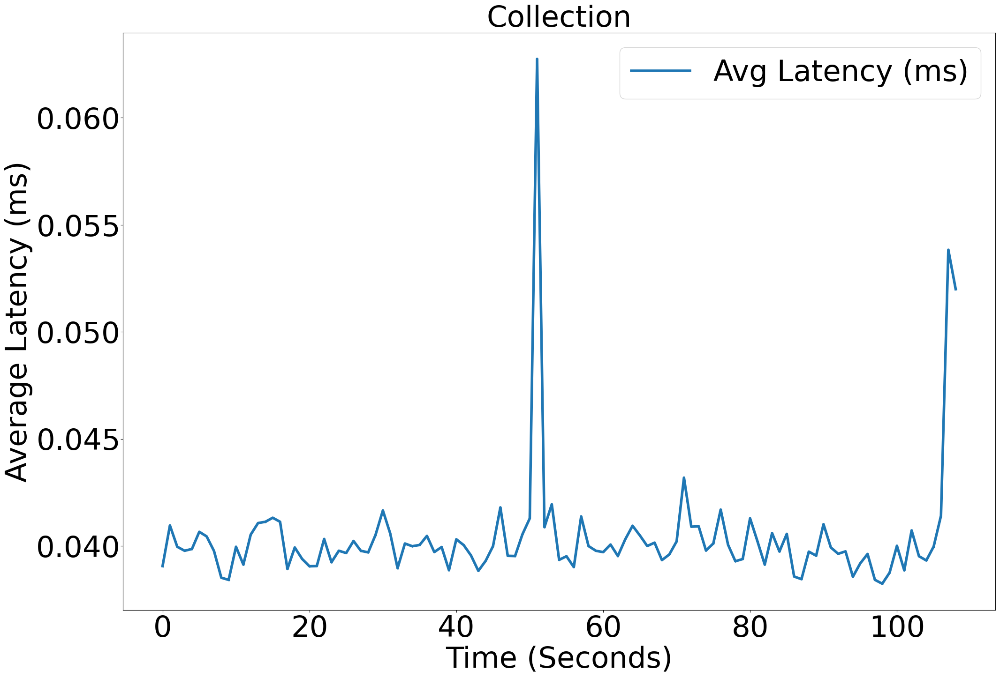

In [12]:
for folder in os.listdir('../../../Experiments/'):
    if   folder == 'O2PRBC_test':
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()

../../Experiments/O2PRBC_test


/tmp/ipykernel_80866/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_80866/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

9932.4
folder is  O2PRBC_test


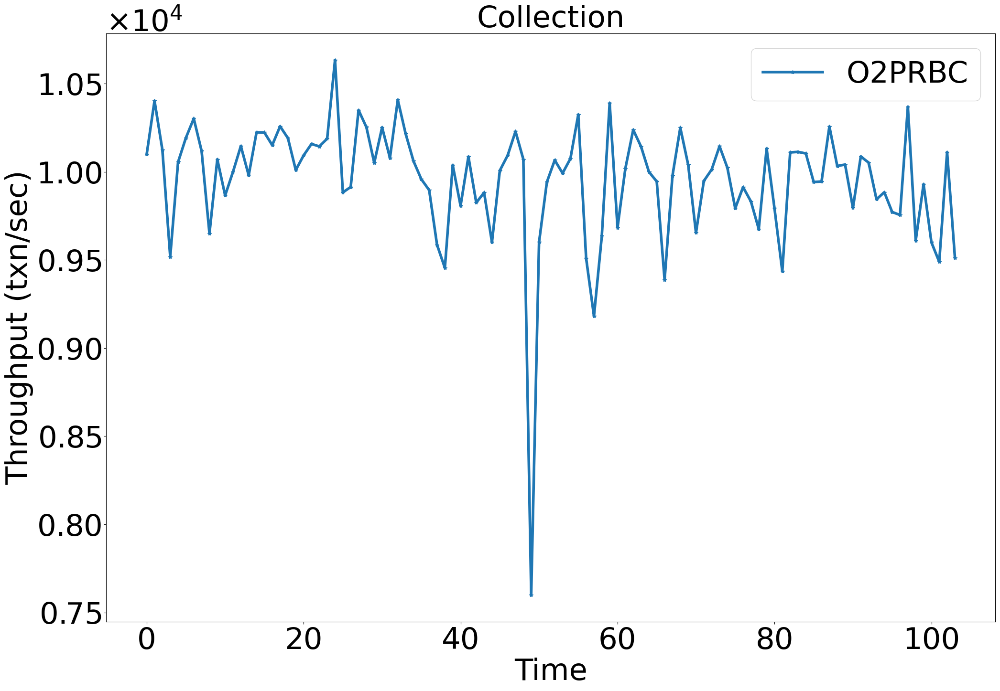

<Figure size 640x480 with 0 Axes>

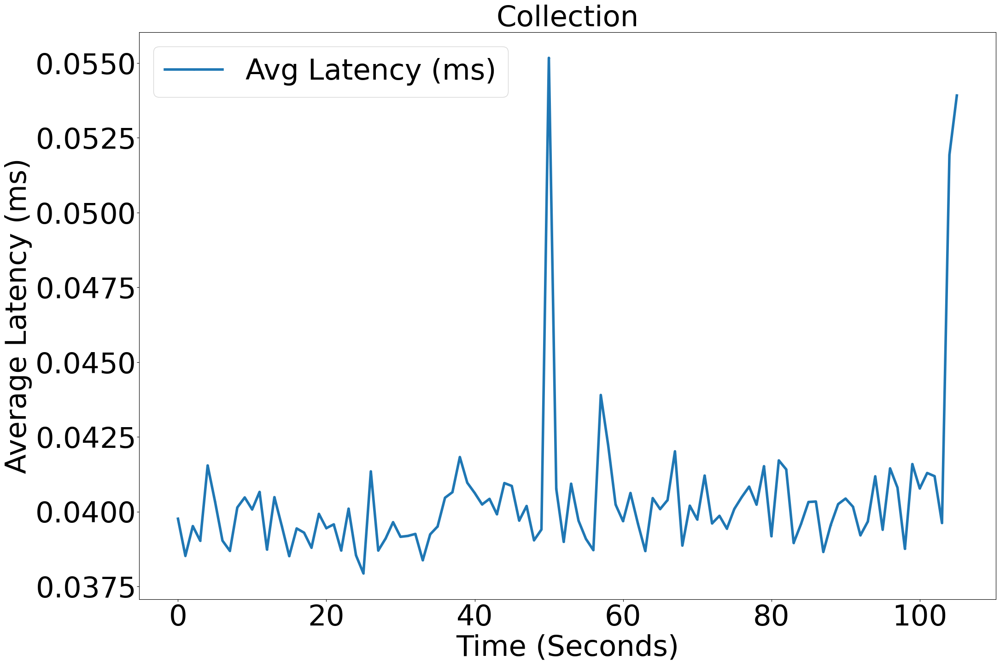

In [13]:
for folder in os.listdir('../../../Experiments/'):
    if   folder == 'O2PRBC_test':
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()

../../Experiments/O2PRBC_4node


/tmp/ipykernel_43122/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_43122/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

folder is  O2PRBC_4node


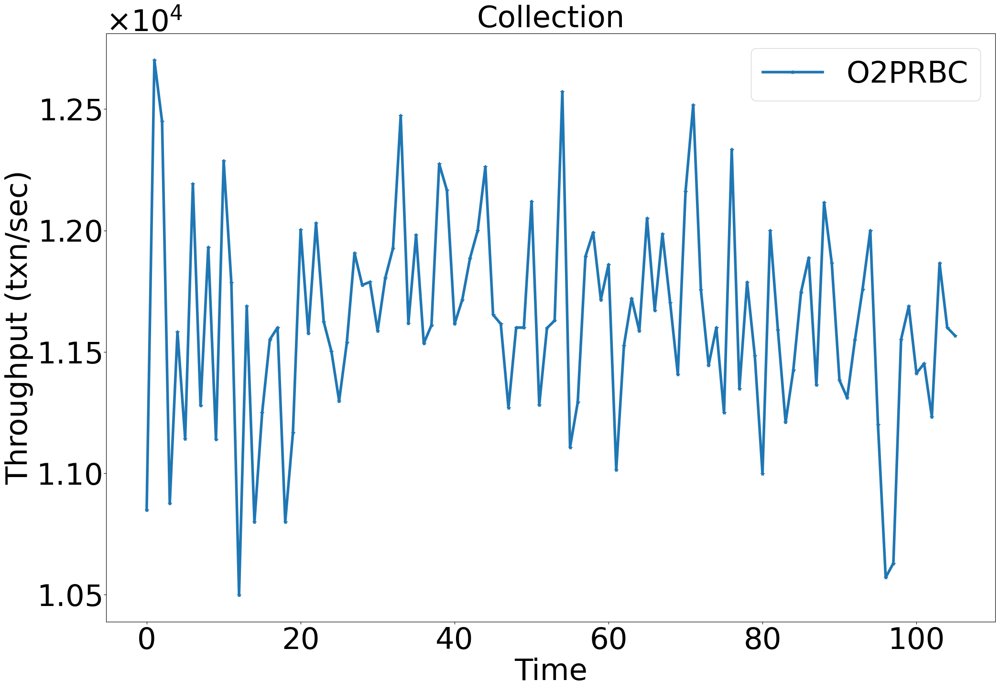

<Figure size 640x480 with 0 Axes>

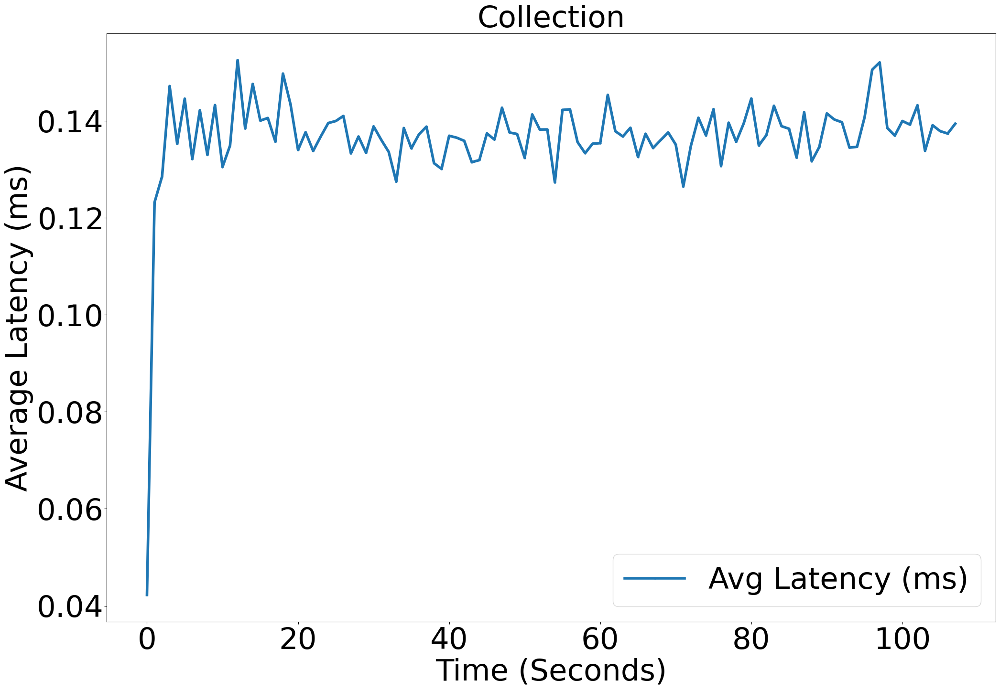

11613.381818181819 0.1378778749677145


In [10]:
for folder in os.listdir('../../../Experiments/'):
    if   folder == 'O2PRBC_4node':
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
    

../../Experiments/O2PRBC_single_collect_test48


/tmp/ipykernel_93599/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_93599/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

3368.0
folder is  O2PRBC_single_collect_test48


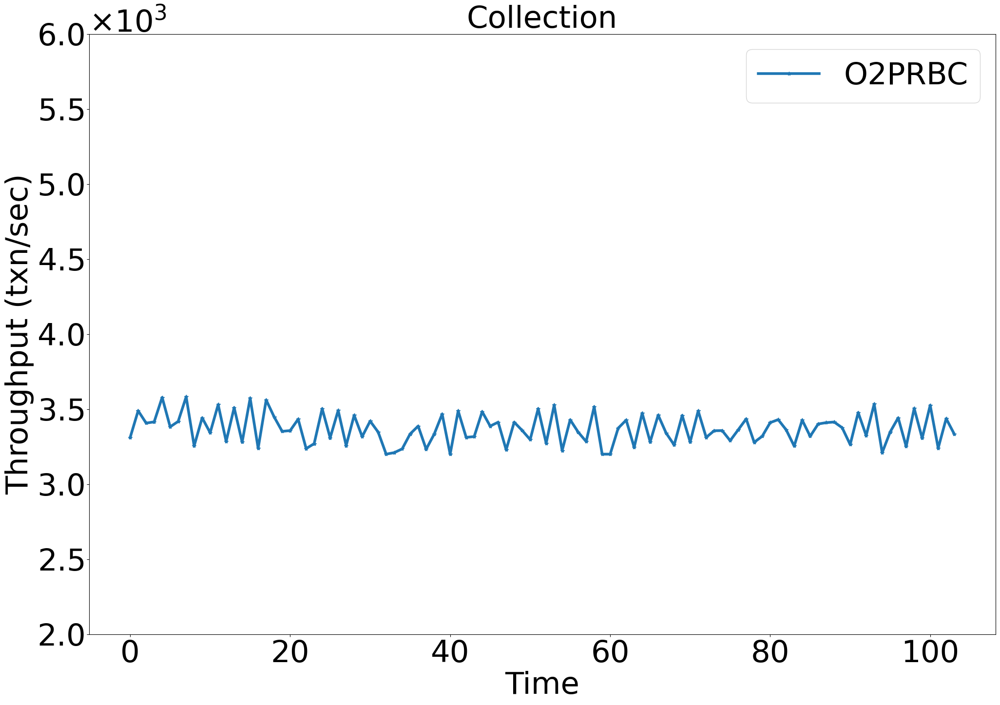

<Figure size 640x480 with 0 Axes>

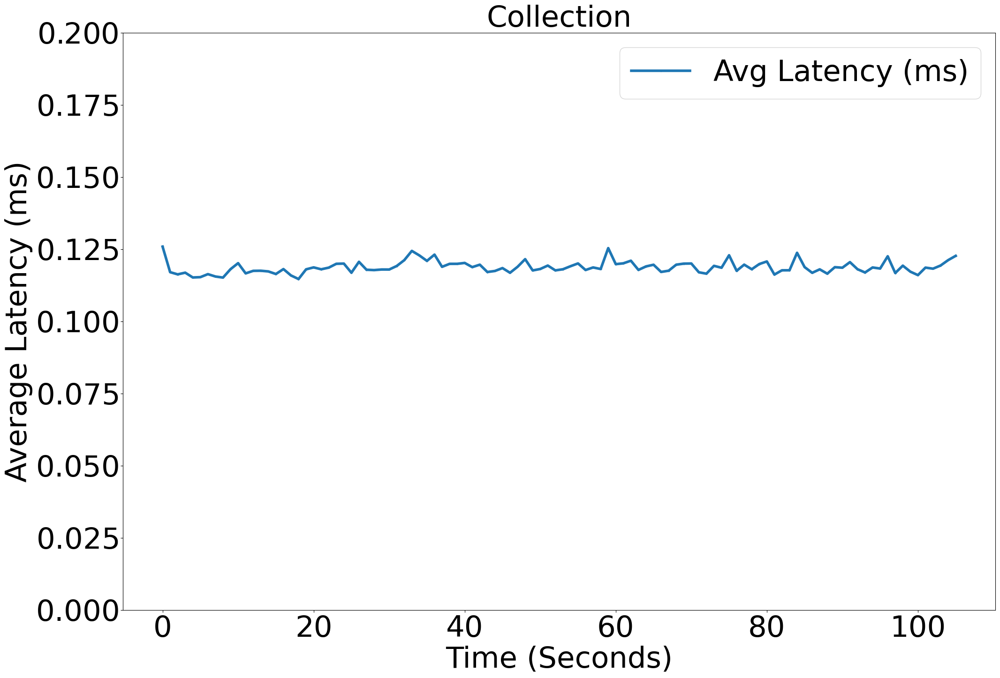

3364.3454545454547 0.11882083035646451


In [17]:
for folder in os.listdir('../../../Experiments/'):
    if   folder == 'O2PRBC_single_collect_test48':
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

        pl.ylim(2000,6000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/singlecollect48t.pdf', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
        pl.ylim(0,0.2)
        pl.title('Collection')
        pl.legend()
        pl.savefig('/home/tejas/Desktop/O2PRBC/singlecollect48l.pdf', dpi = 150, bbox_inches='tight' )

        pl.show()
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
    

../../Experiments/ho_4node
9312.76
folder is  ho_4node


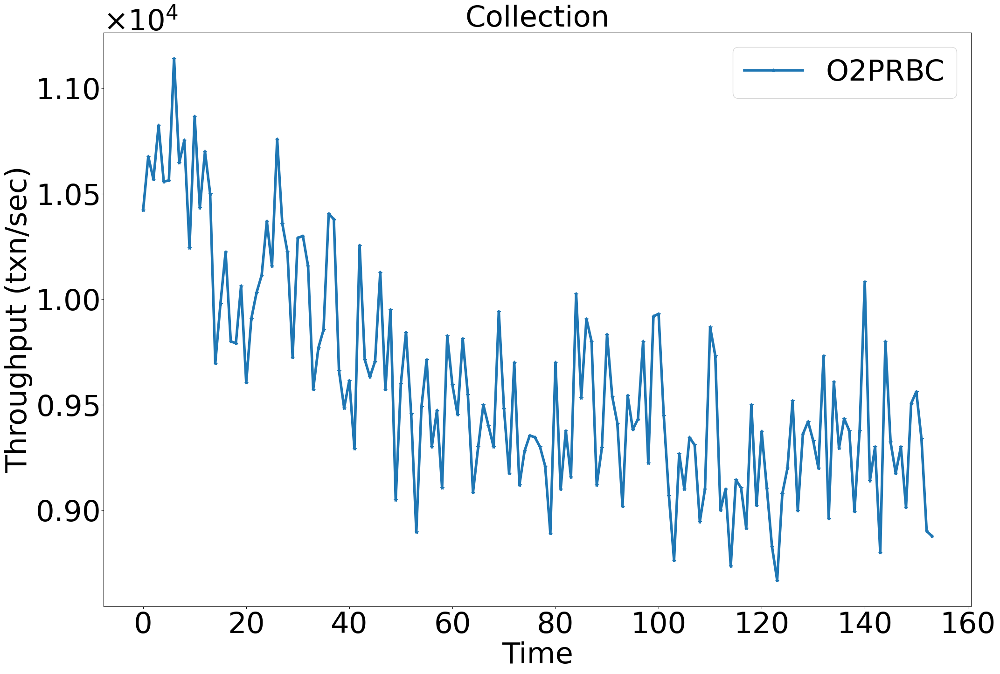

<Figure size 640x480 with 0 Axes>

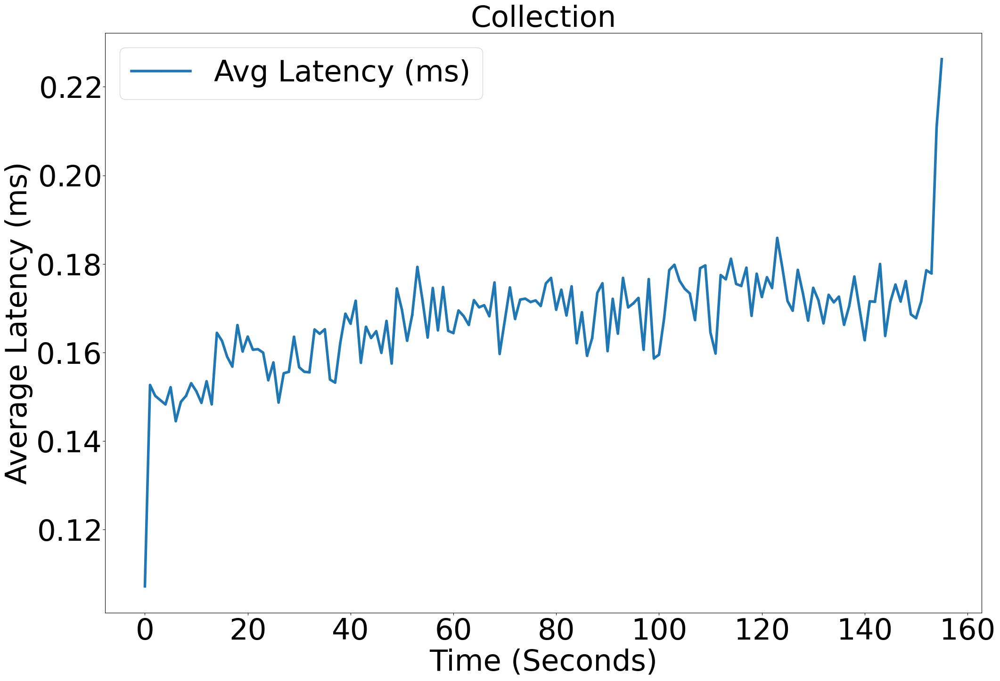

9281.763636363636 0.17240881504943503


In [17]:
for folder in ['ho_4node', ]:
    # if   folder == 'ho_16node':
        
        
    
    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
    # pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)
    
    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
    

In [ ]:
7689, 4460, 3467
0.20, 0.36, 0.46



In [12]:
# # 8017.12 0.1997513637104733
# # 5948.4 0.26894577839036377
# # 3780.5733333333333 0.42318951933311444


# #7457.16 0.05375720590442043
# #5761.333333333333 0.069
# #3634.76 0.1101742299362535

# node_count = [4, 8, 16]
# thputs = [9916,7797,5119]
# lats = [0.16,0.20, 0.31]
# node_count_ho = [4,8, 16]
# thputs_ho = [7800,?, 6358]
# lats_ho = [0.20, 0.?, 0.25]

# fig,ax = pl.subplots(figsize = (24, 16))
# pl.plot(node_count, thputs, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
# pl.plot(node_count_ho, thputs_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

# ax.yaxis.set_major_formatter(formatter)
# pl.ylabel('Throughput (txns/sec)')
# pl.xlabel('Node Count')
# pl.legend()

# pl.savefig('/home/tejas/Desktop/thputs_vs_nodecountV4.pdf', dpi = 150, bbox_inches='tight')
# pl.show()
# pl.clf()



# fig,ax = pl.subplots(figsize = (24, 16))
# pl.plot(node_count, lats, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
# pl.plot(node_count_ho, lats_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

# ax.yaxis.set_major_formatter(formatter)
# pl.ylabel('Latency (sec)')
# pl.xlabel('Node Count')
# pl.legend()
# pl.savefig('/home/tejas/Desktop/lats_vs_nodecountV4.pdf', dpi = 150, bbox_inches='tight')

# pl.show()
# pl.clf()



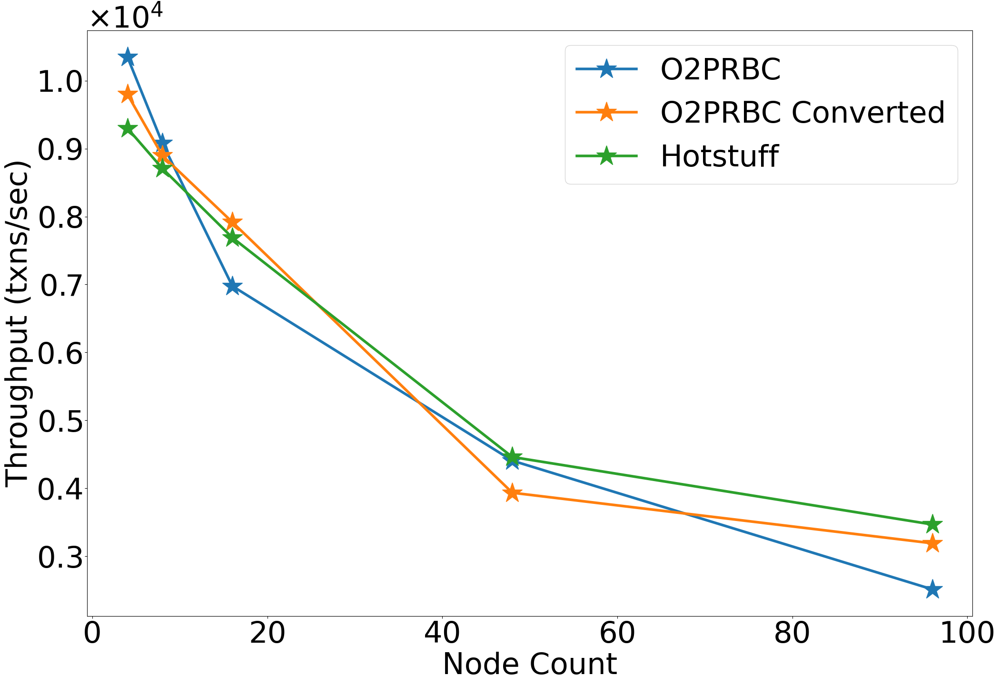

<Figure size 640x480 with 0 Axes>

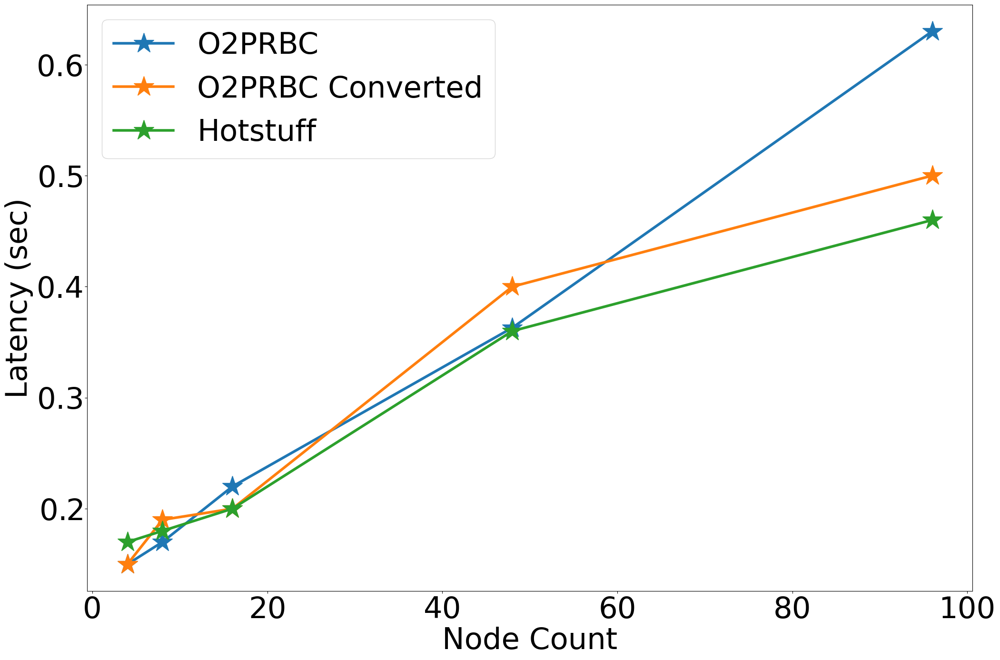

<Figure size 640x480 with 0 Axes>

In [18]:
# 8017.12 0.1997513637104733
# 5948.4 0.26894577839036377
# 3780.5733333333333 0.42318951933311444


#7457.16 0.05375720590442043
#5761.333333333333 0.069
#3634.76 0.1101742299362535

7689, 4460, 3467
0.20, 0.36, 0.46



node_count = [4, 8, 16, 48, 96]
thputs = [10350,9079,6976, 4406, 2512]
lats = [0.15,0.17, 0.22, 0.363, 0.63]

thputsv2 = [9800,8897,7917, 3934,  3190]
latsv2 = [0.15,0.19, 0.20, 0.40, 0.50]

node_count_ho = [4,8, 16, 48, 96]
thputs_ho = [9300,8707, 7689, 4460, 3467 ]
lats_ho = [0.17, 0.18, 0.20, 0.36, 0.46]

fig,ax = pl.subplots(figsize = (24, 16))
pl.plot(node_count, thputs, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
pl.plot(node_count, thputsv2, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC Converted')

pl.plot(node_count_ho, thputs_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

ax.yaxis.set_major_formatter(formatter)
pl.ylabel('Throughput (txns/sec)')
pl.xlabel('Node Count')
pl.legend()

pl.savefig('/home/tejas/Desktop/thputs_vs_nodecountV5.pdf', dpi = 150, bbox_inches='tight')
pl.show()
pl.clf()



fig,ax = pl.subplots(figsize = (24, 16))
pl.plot(node_count, lats, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
pl.plot(node_count, latsv2, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC Converted')

pl.plot(node_count_ho, lats_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

ax.yaxis.set_major_formatter(formatter)
pl.ylabel('Latency (sec)')
pl.xlabel('Node Count')
pl.legend()
pl.savefig('/home/tejas/Desktop/lats_vs_nodecountV5.pdf', dpi = 150, bbox_inches='tight')

pl.show()
pl.clf()



../../Experiments/O2PRBC_b100_8node


/tmp/ipykernel_7093/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_7093/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Depre

7384.52
folder is  O2PRBC_b100_8node


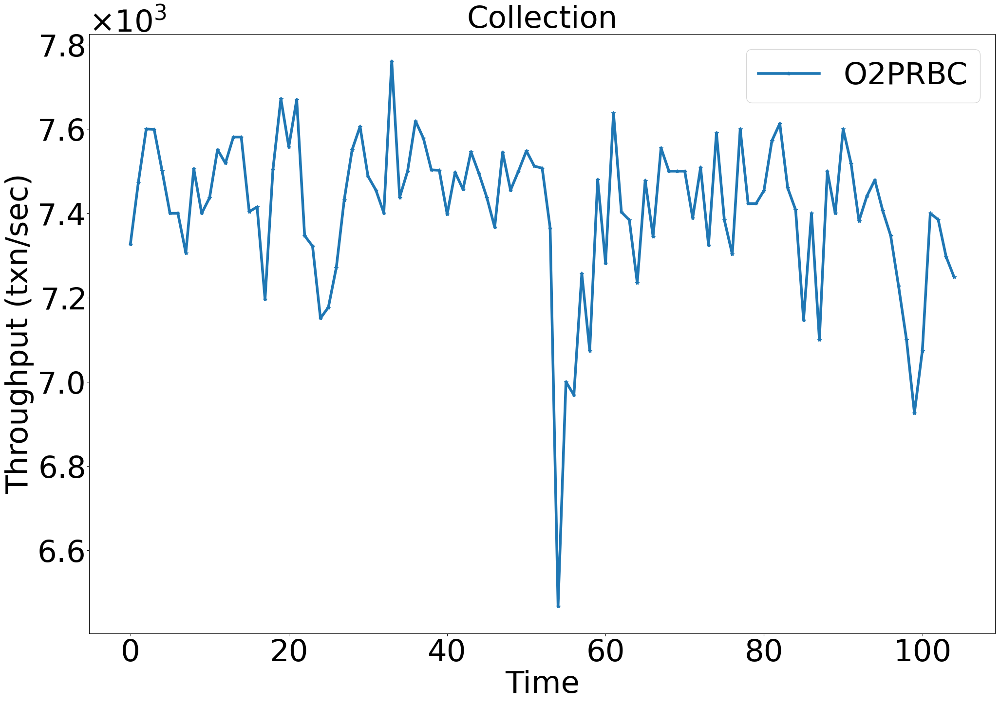

<Figure size 640x480 with 0 Axes>

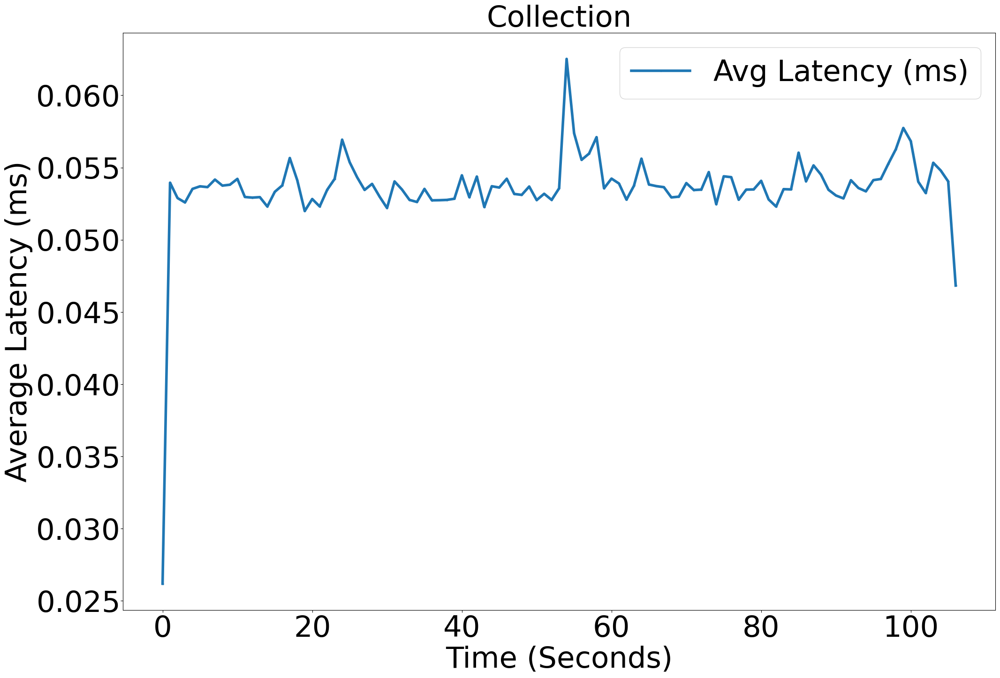

7376.927272727273 0.054231672406912276
../../Experiments/O2PRBC_b100_4node
7362.92
folder is  O2PRBC_b100_4node


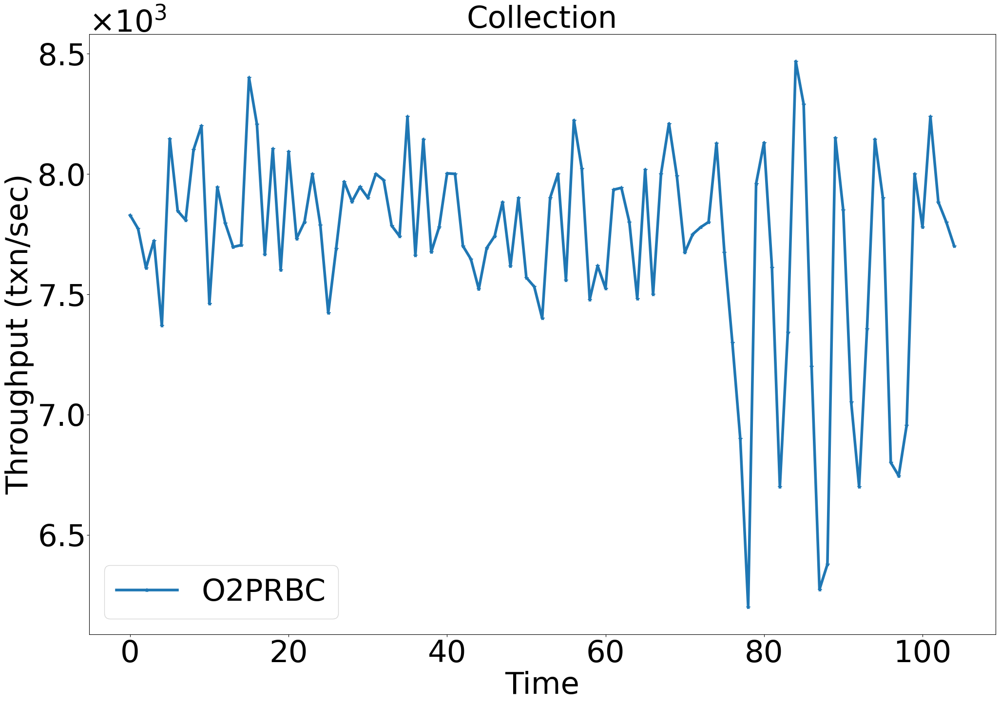

<Figure size 640x480 with 0 Axes>

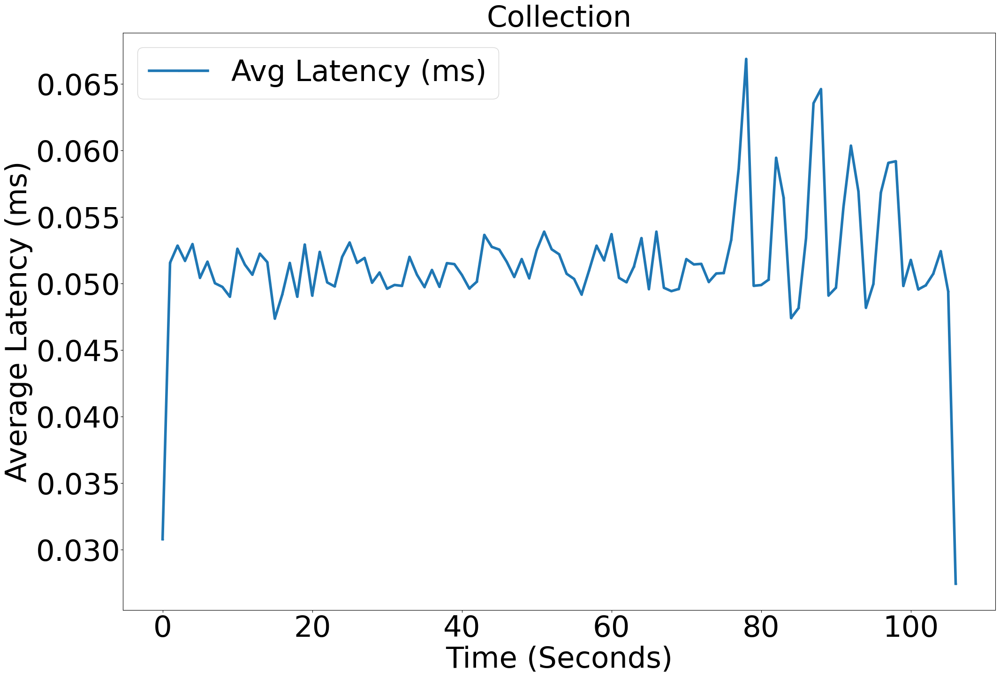

7595.145454545454 0.052826954495155724
../../Experiments/O2PRBC_b100_16node
7372.0
folder is  O2PRBC_b100_16node


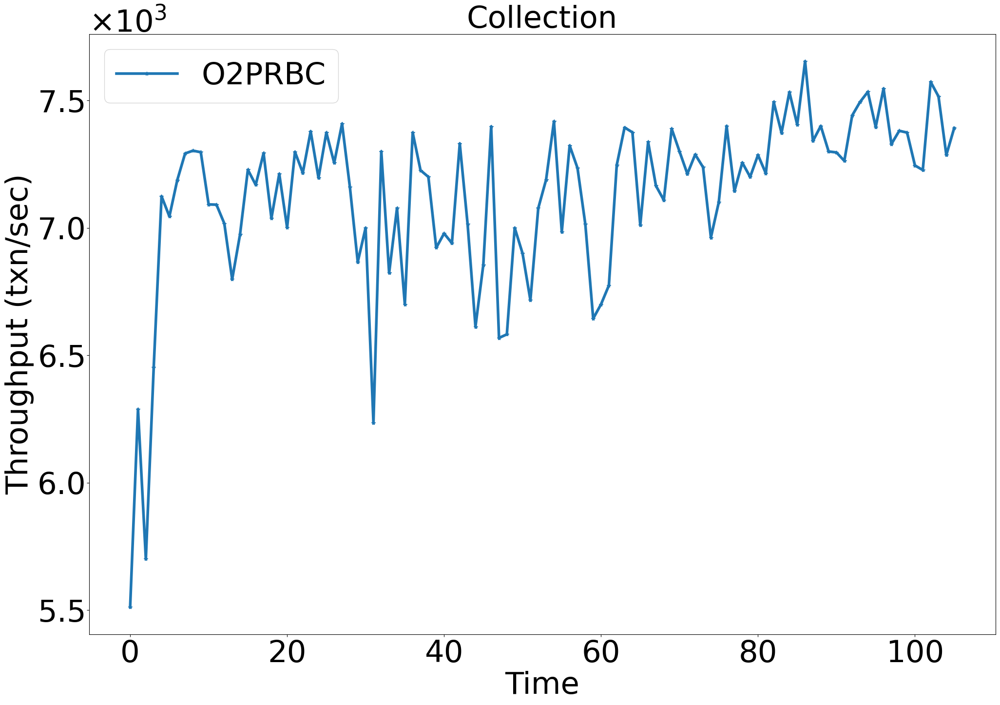

<Figure size 640x480 with 0 Axes>

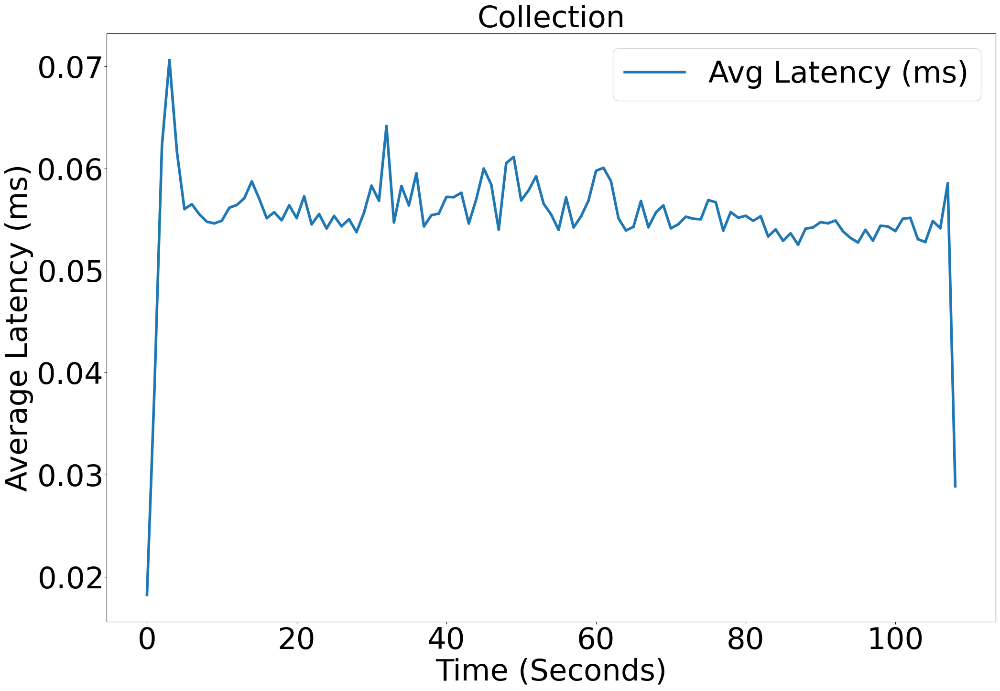

7217.236363636363 0.055271371776983325


In [13]:
for folder in os.listdir('../../../Experiments/'):
    if   'O2PRBC_b' in folder:
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
    

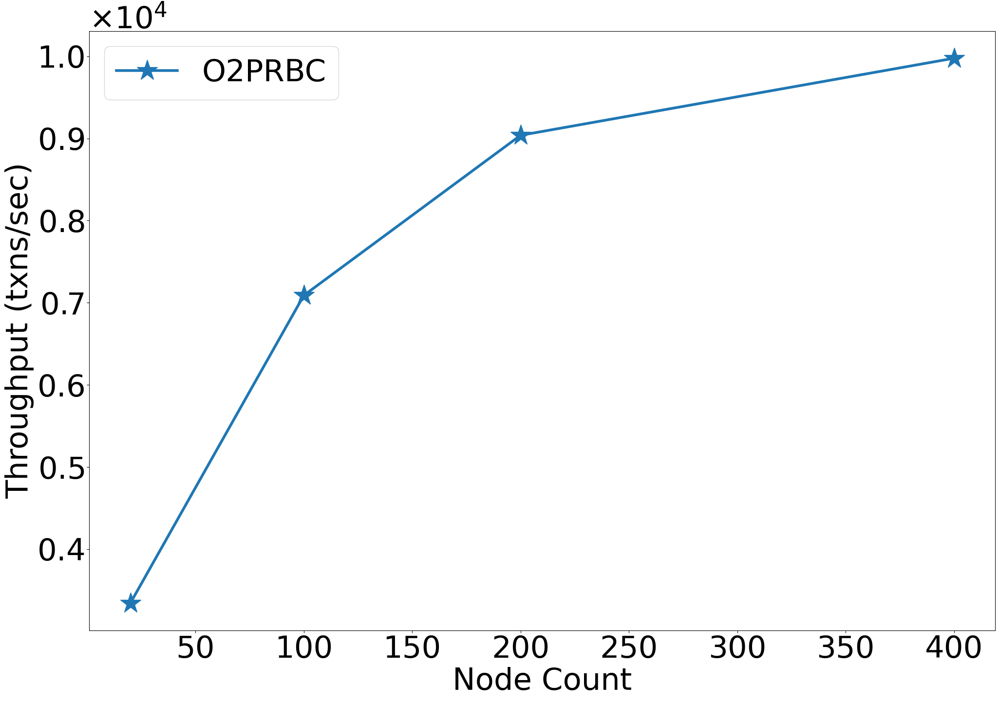

<Figure size 640x480 with 0 Axes>

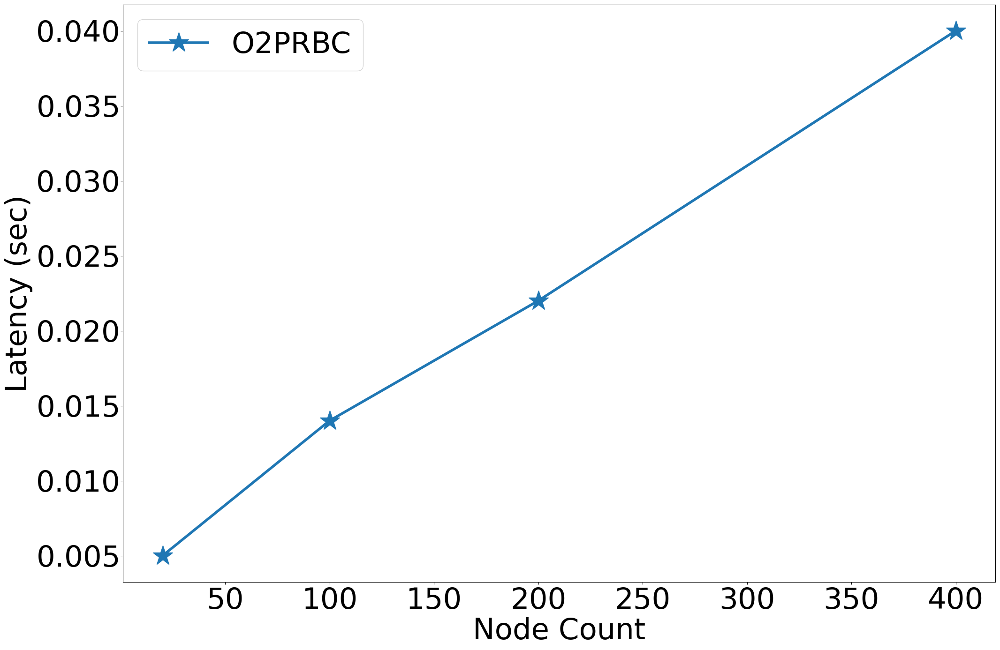

<Figure size 640x480 with 0 Axes>

In [8]:
batch_sizes = [20, 100, 200, 400]
thputs = [3344,7089,9038, 9976]
lats = [0.005,0.014, 0.022, 0.04]

fig,ax = pl.subplots(figsize = (24, 16))
pl.plot(batch_sizes, thputs, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')

ax.yaxis.set_major_formatter(formatter)
pl.ylabel('Throughput (txns/sec)')
pl.xlabel('Node Count')
pl.legend()

pl.savefig('/home/tejas/Desktop/O2PRBC/thputs_vs_batchsize.pdf', dpi = 150, bbox_inches='tight')
pl.show()
pl.clf()



fig,ax = pl.subplots(figsize = (24, 16))
pl.plot(batch_sizes, lats, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')

ax.yaxis.set_major_formatter(formatter)
pl.ylabel('Latency (sec)')
pl.xlabel('Node Count')
pl.legend()
pl.savefig('/home/tejas/Desktop/O2PRBC/lats_vs_batchsize.pdf', dpi = 150, bbox_inches='tight')

pl.show()
pl.clf()



In [9]:
# node_count = [4, 8, 16]
# thputs = [7595,7376,7217]
# lats = [0.052,0.054, 0.055]
# node_count_ho = [4,8, 16]
# thputs_ho = [6350,6300, 5691]
# lats_ho = [0.252, 0.25, 0.28]

# fig,ax = pl.subplots(figsize = (24, 16))
# pl.plot(node_count, thputs, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
# pl.plot(node_count_ho, thputs_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

# ax.yaxis.set_major_formatter(formatter)
# pl.ylabel('Throughput (txns/sec)')
# pl.xlabel('Node Count')
# pl.legend()

# pl.savefig('/home/tejas/Desktop/thputs_vs_nodecount.pdf', dpi = 150, bbox_inches='tight')
# pl.show()
# pl.clf()



# fig,ax = pl.subplots(figsize = (24, 16))
# pl.plot(node_count, lats, '-*', linewidth = 4, markersize = 32, label = 'O2PRBC')
# pl.plot(node_count_ho, lats_ho, '-*', linewidth = 4, markersize = 32, label = 'Hotstuff')

# ax.yaxis.set_major_formatter(formatter)
# pl.ylabel('Latency (sec)')
# pl.xlabel('Node Count')
# pl.legend()
# pl.savefig('/home/tejas/Desktop/lats_vs_nodecount.pdf', dpi = 150, bbox_inches='tight')

# pl.show()
# pl.clf()



../../Experiments/O2PRBC_single_collect_test


/tmp/ipykernel_7093/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_7093/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Depre

10860.6
folder is  O2PRBC_single_collect_test


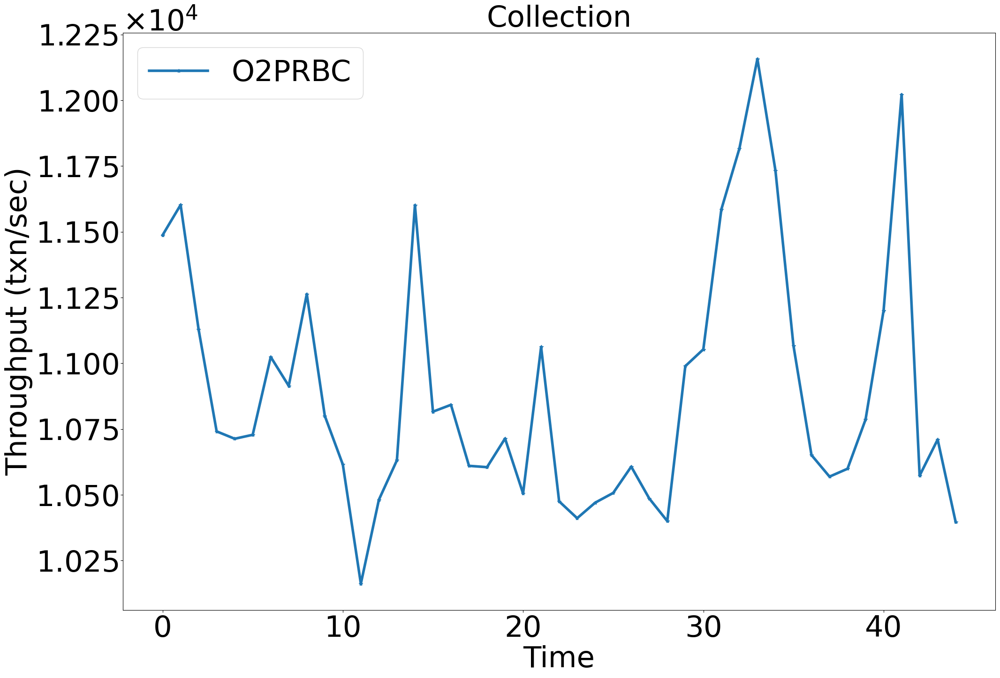

<Figure size 640x480 with 0 Axes>

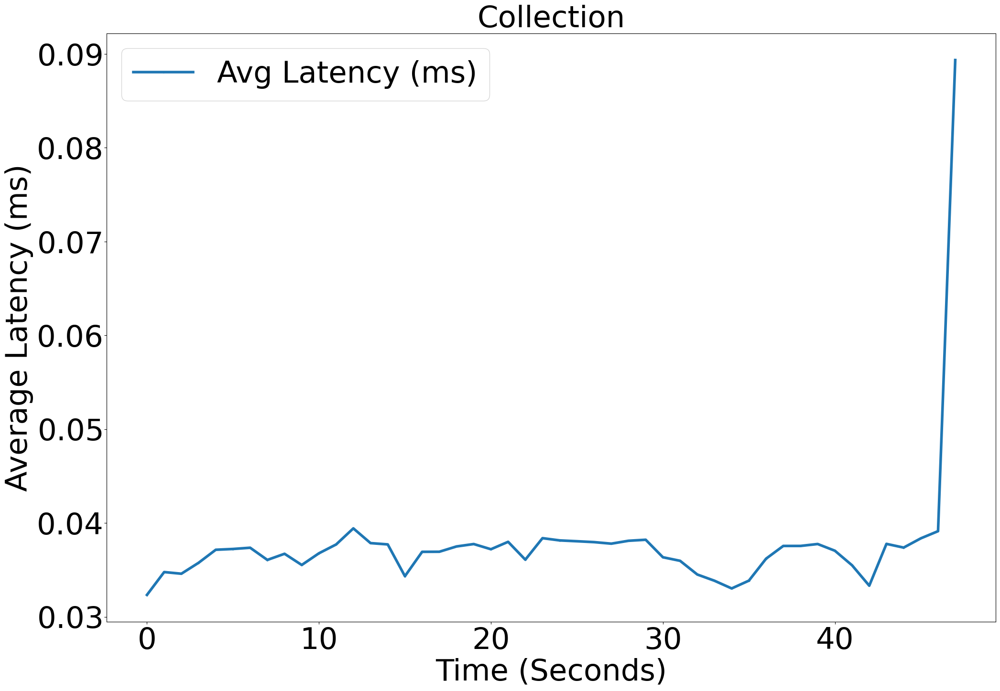

10885.125 0.03652920142639125


In [16]:
for folder in os.listdir('../../../Experiments/'):
    if   'O2PRBC_single_collect_test' in folder:
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
    

../../Experiments/O2PRBC_single_collect_4node


/tmp/ipykernel_75110/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_75110/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

11408.0
folder is  O2PRBC_single_collect_4node


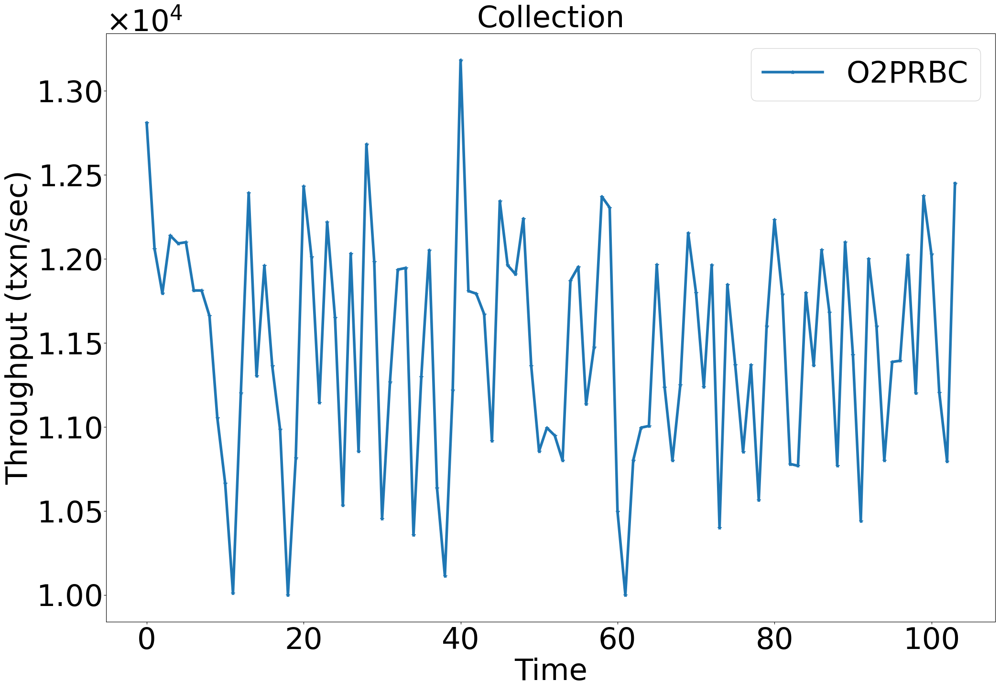

<Figure size 640x480 with 0 Axes>

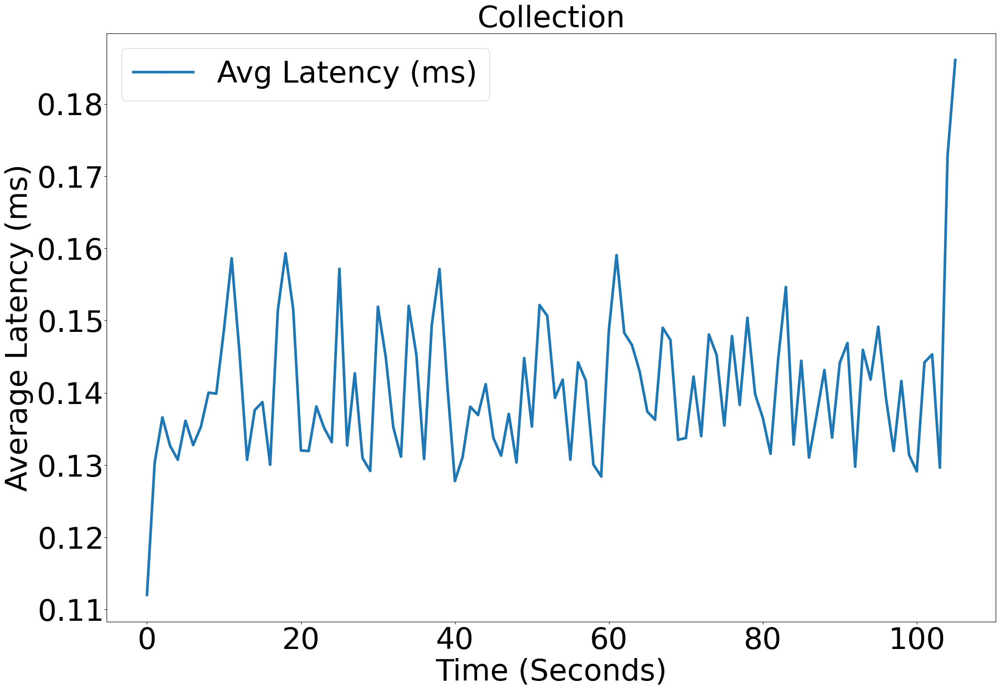

11395.072727272727 0.1404181395521873
../../Experiments/O2PRBC_single_collect_8node
10349.08
folder is  O2PRBC_single_collect_8node


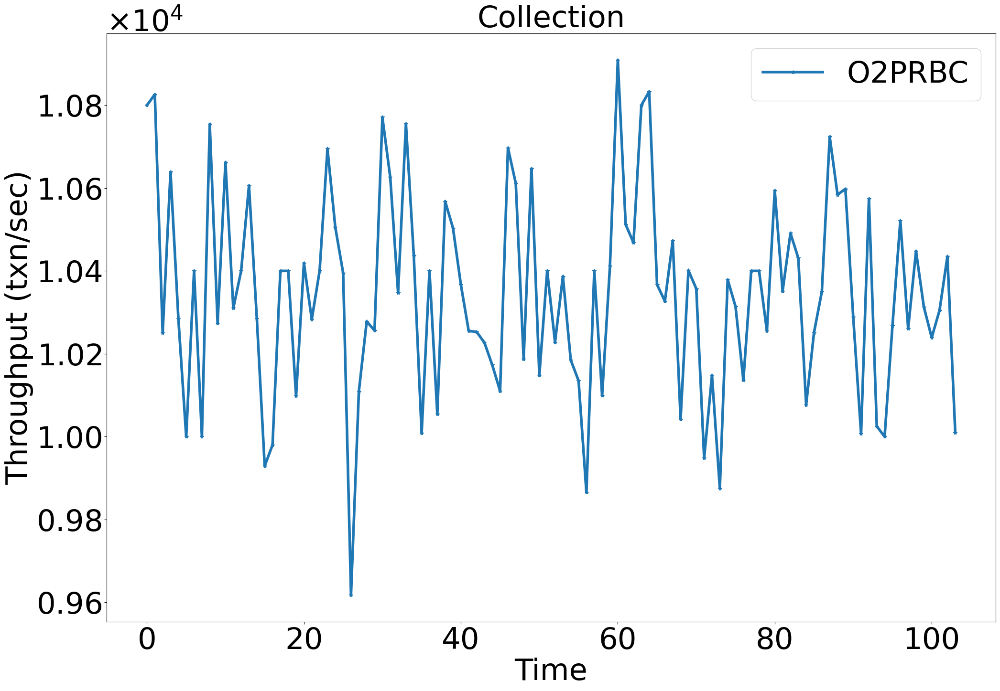

<Figure size 640x480 with 0 Axes>

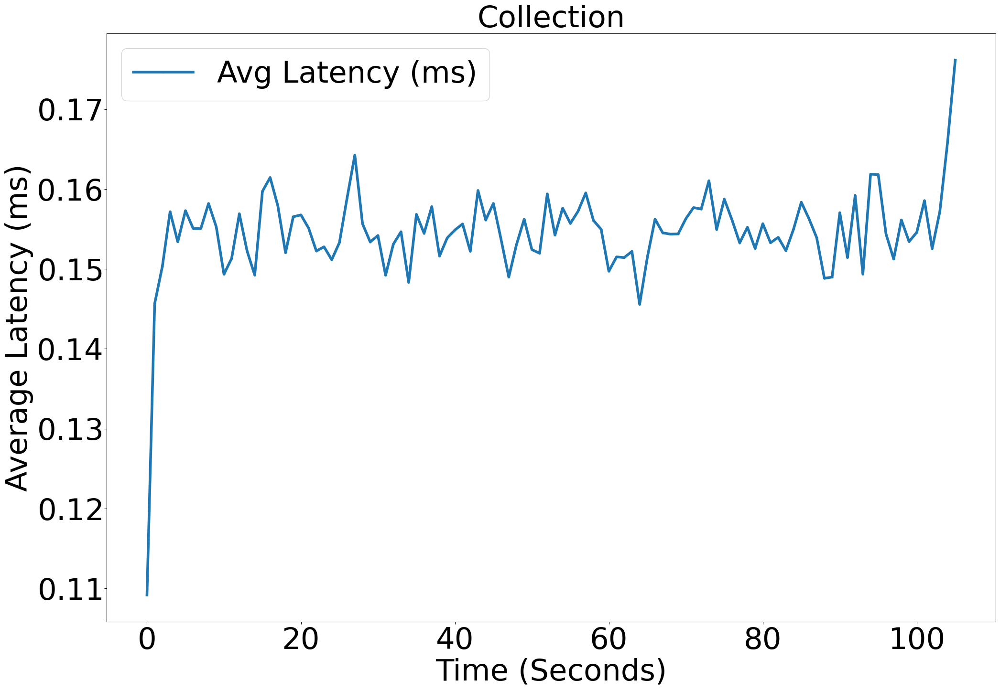

10343.10909090909 0.15459030433686183
../../Experiments/O2PRBC_single_collect_16node
8766.6
folder is  O2PRBC_single_collect_16node


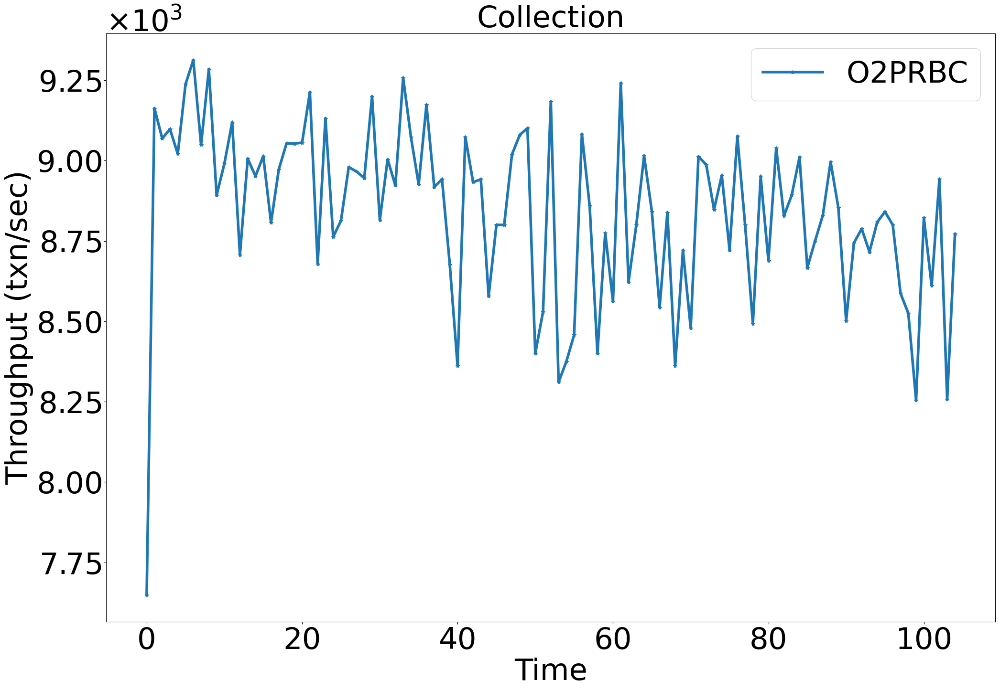

<Figure size 640x480 with 0 Axes>

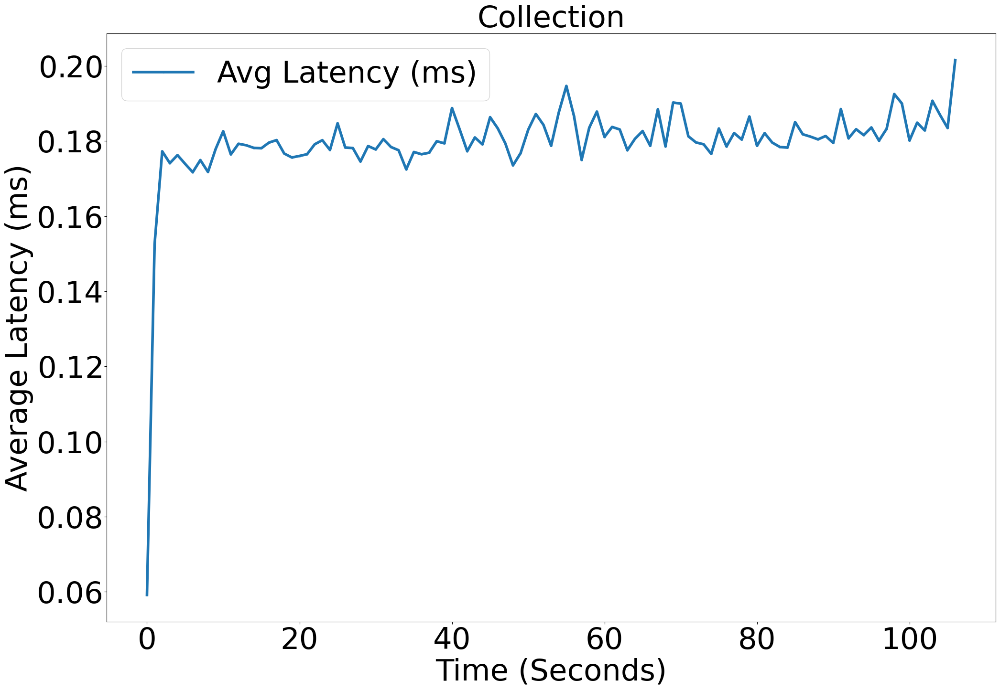

8766.672727272728 0.1824741681095849
../../Experiments/O2PRBC_single_collect_test48
5373.76
folder is  O2PRBC_single_collect_test48


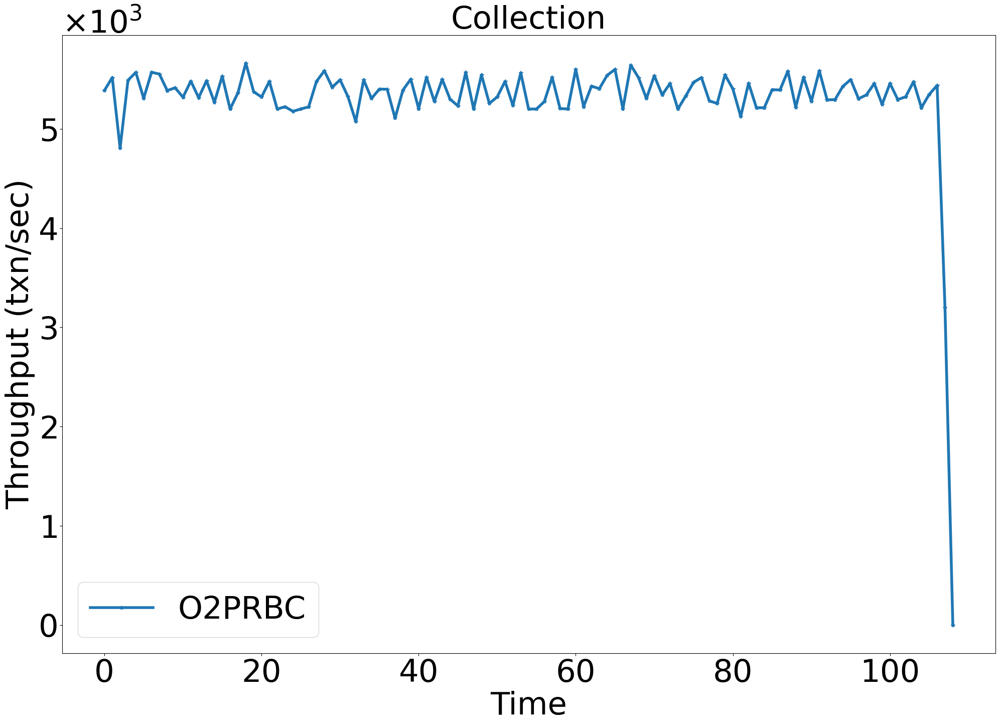

<Figure size 640x480 with 0 Axes>

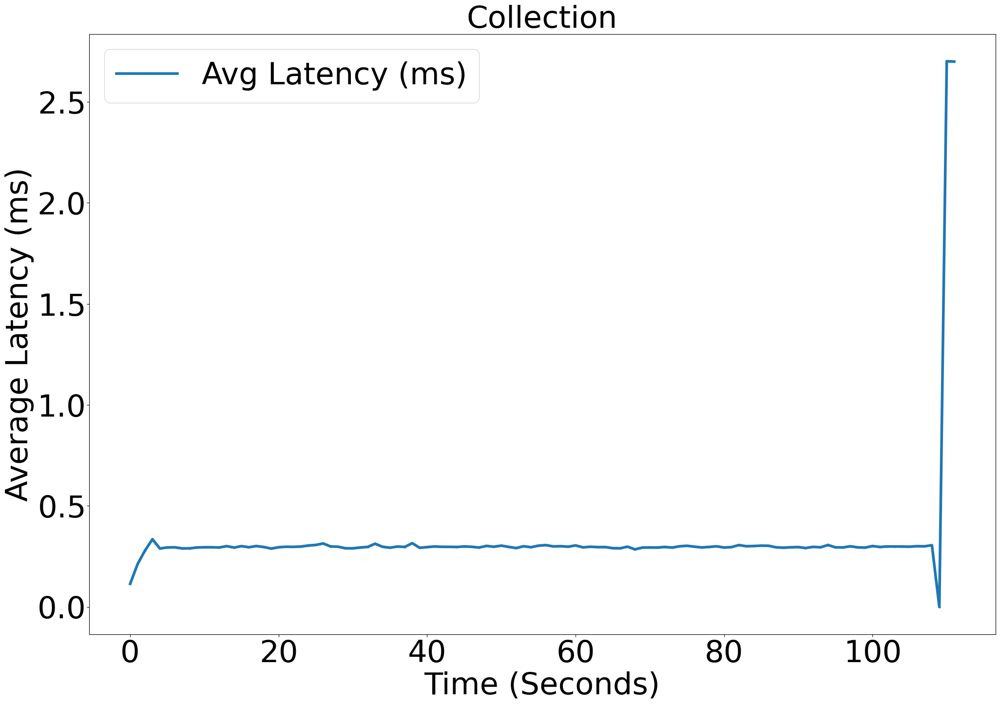

5375.563636363637 0.2974829640060947
../../Experiments/O2PRBC_single_collect_test96
5104.0
folder is  O2PRBC_single_collect_test96


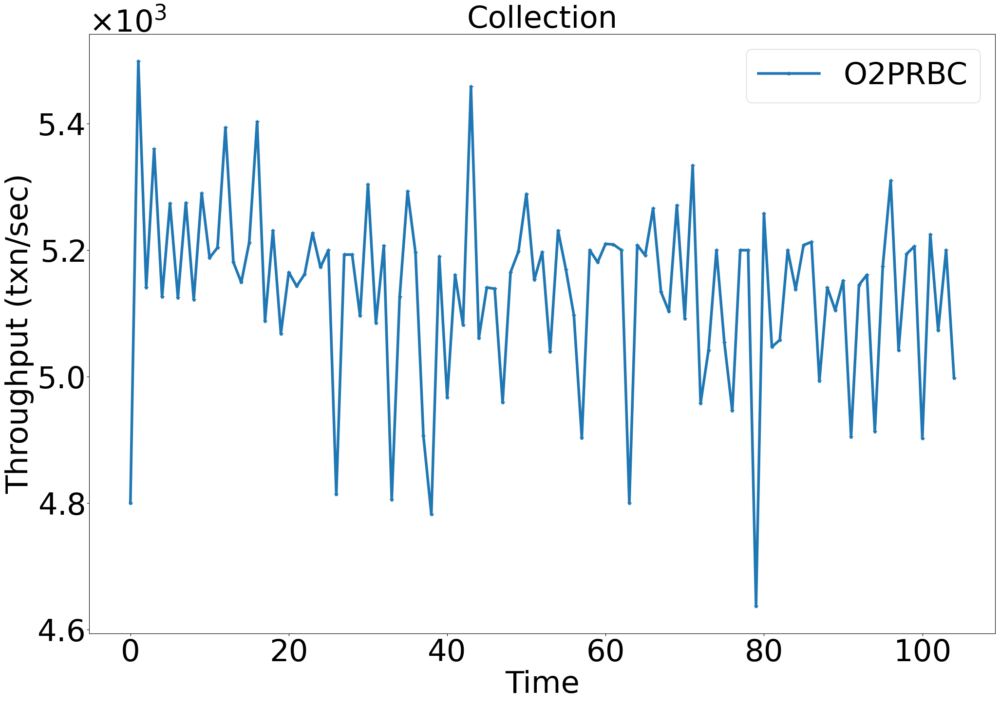

<Figure size 640x480 with 0 Axes>

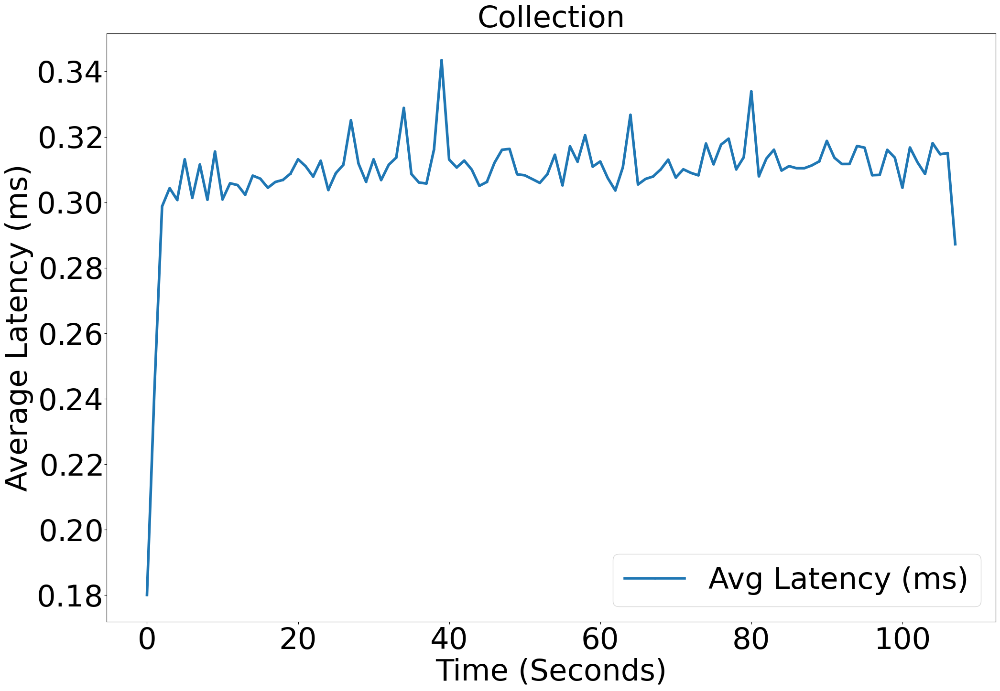

5125.090909090909 0.3122013083113172


In [4]:
all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

for folder in ['O2PRBC_single_collect_4node', 'O2PRBC_single_collect_8node', \
               'O2PRBC_single_collect_16node', 'O2PRBC_single_collect_test48',\
              'O2PRBC_single_collect_test96']:
    if   'O2PRBC_single_collect' in folder:
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()
        
        all_times_1.append(s1)
        all_thputs.append(s2)


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
        
        
        all_times_2.append(seconds)
        all_lats.append(avg_latency_per_sec)
        
    

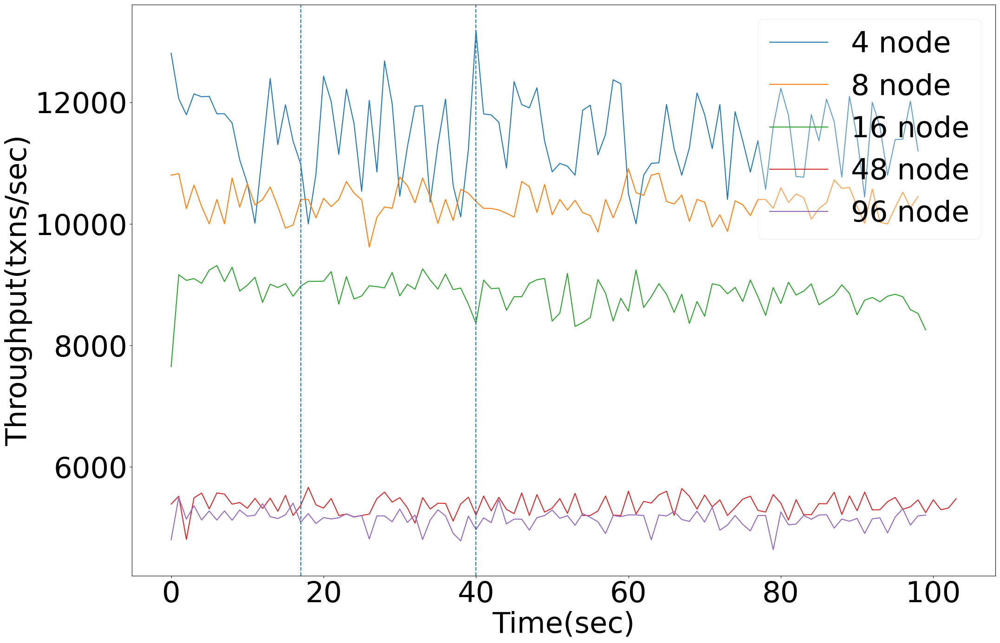

<Figure size 640x480 with 0 Axes>

In [34]:
fig,ax = pl.subplots(figsize = (24, 16))
fig.patch.set_facecolor('white')
pl.plot(all_times_1[0][:-5], all_thputs[0][:-5], label = '4 node')
pl.plot(all_times_1[1][:-5], all_thputs[1][:-5], label = '8 node')
pl.plot(all_times_1[2][:-5], all_thputs[2][:-5], label = '16 node')
pl.plot(all_times_1[3][:-5], all_thputs[3][:-5], label = '48 node')
pl.plot(all_times_1[4][:-5], all_thputs[4][:-5], label = '96 node')
pl.xlabel('Time(sec)')
pl.ylabel('Throughput(txns/sec)')
pl.axvline(107-67, ls ='--')
pl.axvline(105-88, ls ='--')


pl.legend(framealpha = 0.3)

pl.show()
pl.clf()

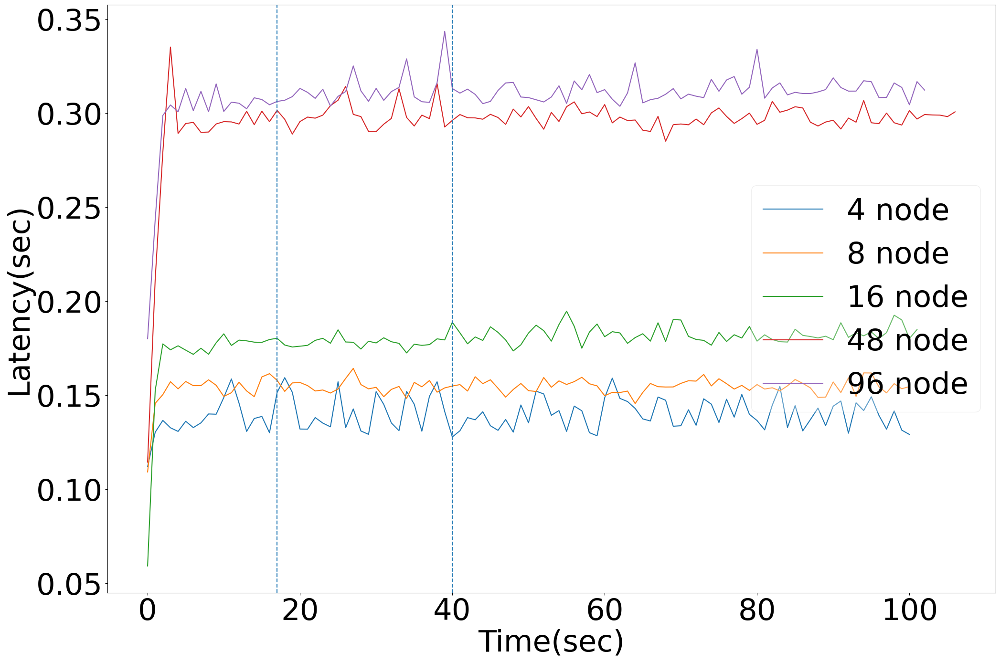

<Figure size 640x480 with 0 Axes>

In [35]:
fig,ax = pl.subplots(figsize = (24, 16))
fig.patch.set_facecolor('white')
pl.plot(all_times_2[0][:-5], all_lats[0][:-5], label = '4 node')
pl.plot(all_times_2[1][:-5], all_lats[1][:-5], label = '8 node')
pl.plot(all_times_2[2][:-5], all_lats[2][:-5], label = '16 node')
pl.plot(all_times_2[3][:-5], all_lats[3][:-5], label = '48 node')
pl.plot(all_times_2[4][:-5], all_lats[4][:-5], label = '96 node')
pl.xlabel('Time(sec)')
pl.ylabel('Latency(sec)')
pl.axvline(107-67, ls ='--')
pl.axvline(105-88, ls ='--')

# pl.axvline(111-70, ls ='--',label = '48')

pl.legend(loc = 'right', framealpha = 0.3)
pl.show()
pl.clf()

In [11]:
all_times_2

[array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105]),
 array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69

In [18]:
pl.axvline?


In [ ]:
# all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

for folder in ['all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

for folder in ['O2PRBC_single_collect_4node', 'O2PRBC_single_collect_8node', \
               'O2PRBC_single_collect_16node', 'O2PRBC_single_collect_test48',\
              'O2PRBC_single_collect_test96']:
    if   'O2PRBC_single_collect' in folder:
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()
        
        all_times_1.append(s1)
        all_thputs.append(s2)


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
        
        
        all_times_2.append(seconds)
        all_lats.append(avg_latency_per_sec)
        
    ']:
    if   'O2PRBC_single_collect' in folder:
        
        
        
        experiment = '../../Experiments/' + folder 
        print(experiment)
        X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

        # Y = Y * cluster_number

        lats

        np.sum(Y)

        s1, s2 = X[:-2],Y[:-2]

        print(np.average(s2[-30:-5]))
        np.average(lats[-33:-3])

        len(lats)

        2*18923.433333333334


        experiment = folder
        print('folder is ', folder)

        if not os.path.exists('../../../Experiments/'+experiment):
            os.mkdir('../../../Experiments/'+experiment)


        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        fig.patch.set_facecolor('white')
        pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
        ax.yaxis.set_major_formatter(formatter)

        pl.legend()
        pl.xlabel('Time')
        pl.ylabel('Throughput (txn/sec)')
        pl.title('Collection')

#         pl.ylim(8000,14000)
        pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
        pl.show()
        pl.clf()
        


        int_times = Times.astype(int)

        # Find the range of seconds
        min_time, max_time = int_times.min(), int_times.max()
        num_seconds = max_time - min_time + 1

        # Compute sum of latencies per second
        latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

        # Compute count per second
        counts = np.bincount(int_times - min_time, minlength=num_seconds)

        # Avoid division by zero and compute average latency per second
        avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

        # Generate second timestamps
        seconds = np.arange(min_time, max_time + 1)
        seconds = seconds - seconds[0]
        # Plot the results
        fig,ax = pl.subplots(figsize = (24, 16))
        fig.patch.set_facecolor('white')
        pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
                label="Avg Latency (ms)", linewidth = 4)
        
        ax.yaxis.set_major_formatter(formatter)

        pl.xlabel("Time (Seconds)")
        pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
        pl.title('Collection')
        pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

        pl.show()
    
        print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))
        
        
        
    

../../Experiments/O2PRBC_multi_collect_16node1round


/tmp/ipykernel_37412/2425067424.py:63: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  Times = np.array(Times)[sorted_indices.astype(np.int)]
/tmp/ipykernel_37412/2425067424.py:64: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Dep

8888.48
folder is  O2PRBC_multi_collect_16node1round


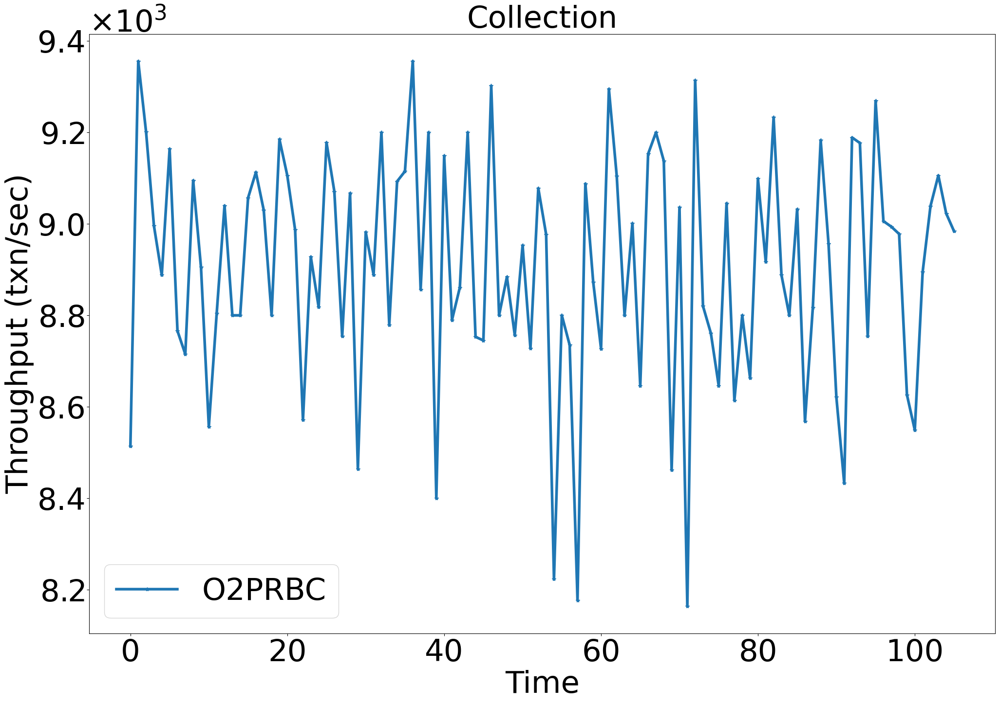

<Figure size 640x480 with 0 Axes>

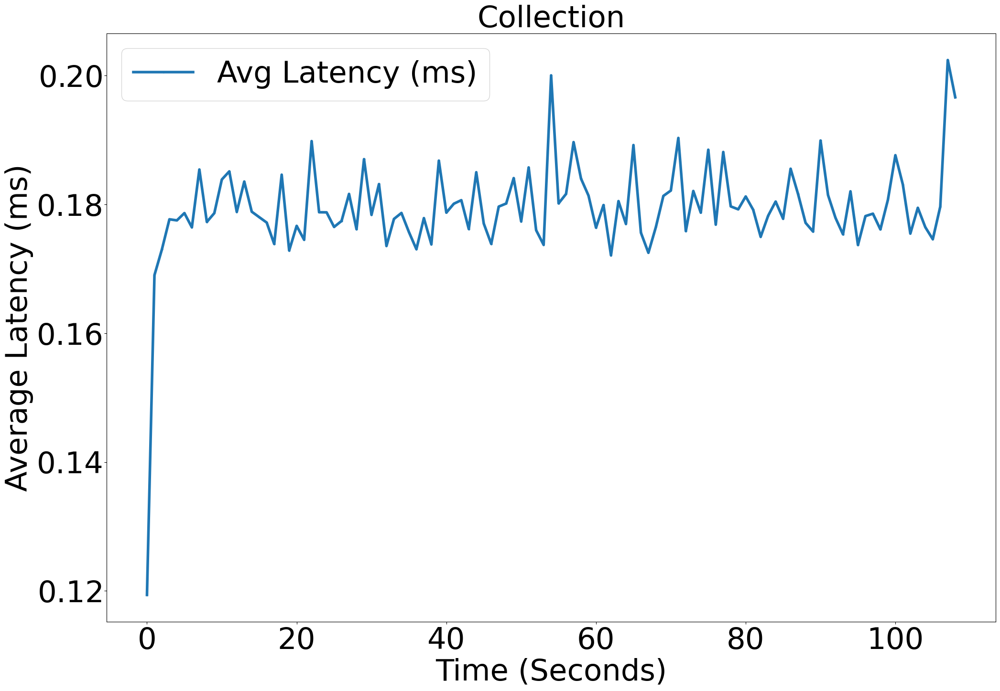

8870.09090909091 0.18049315150329195
../../Experiments/O2PRBC_multi_collect_16node10round
8945.24
folder is  O2PRBC_multi_collect_16node10round


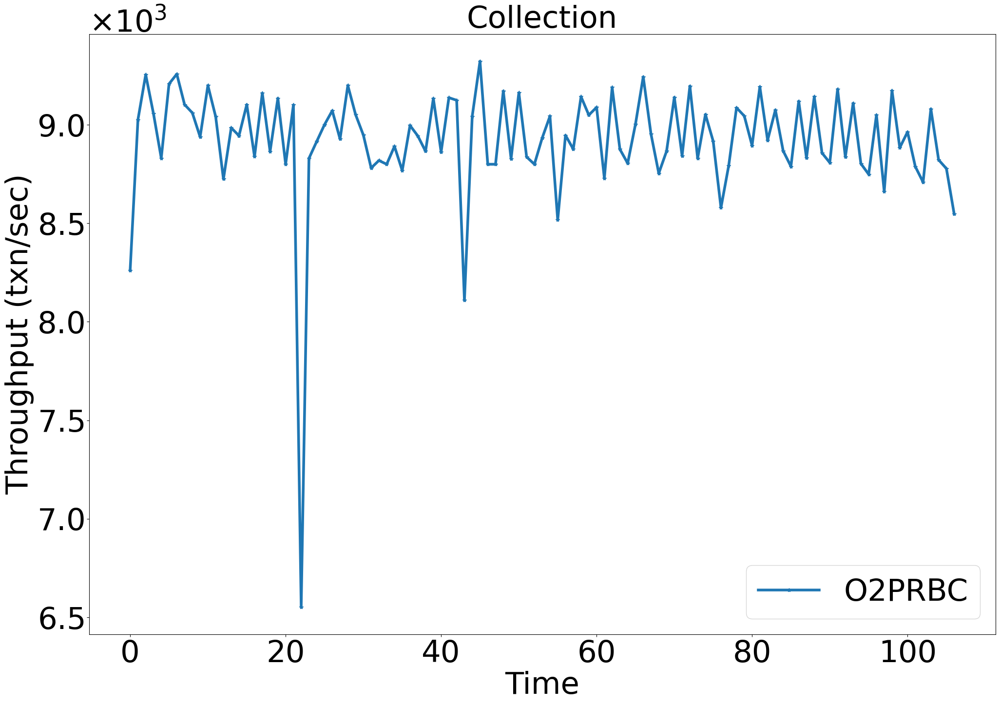

<Figure size 640x480 with 0 Axes>

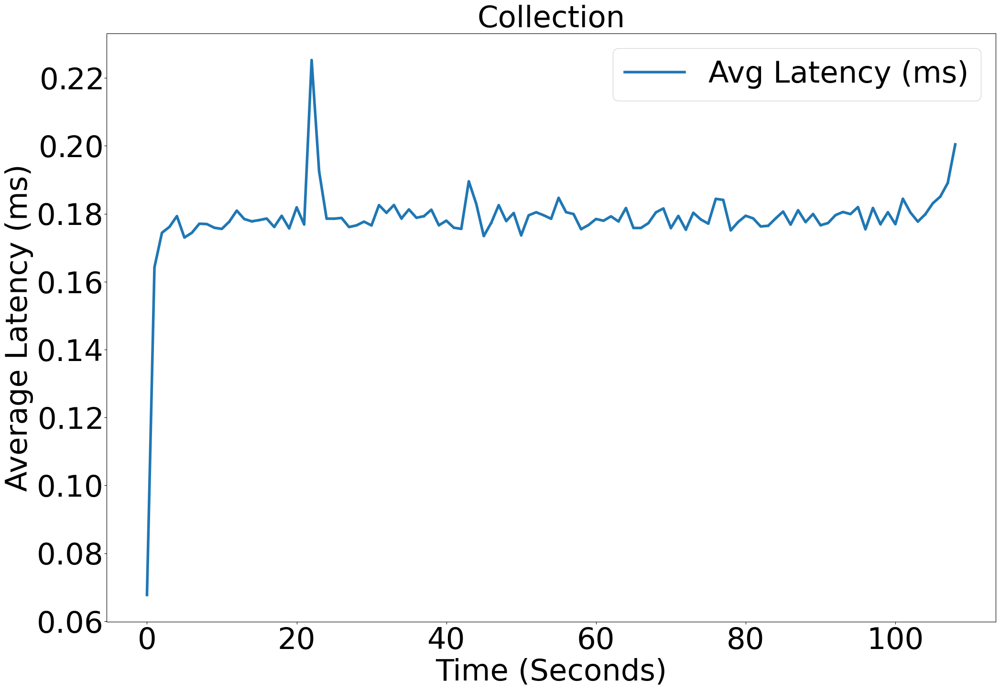

8942.0 0.17886585187303897
../../Experiments/O2PRBC_multi_collect_16node50round
8980.64
folder is  O2PRBC_multi_collect_16node50round


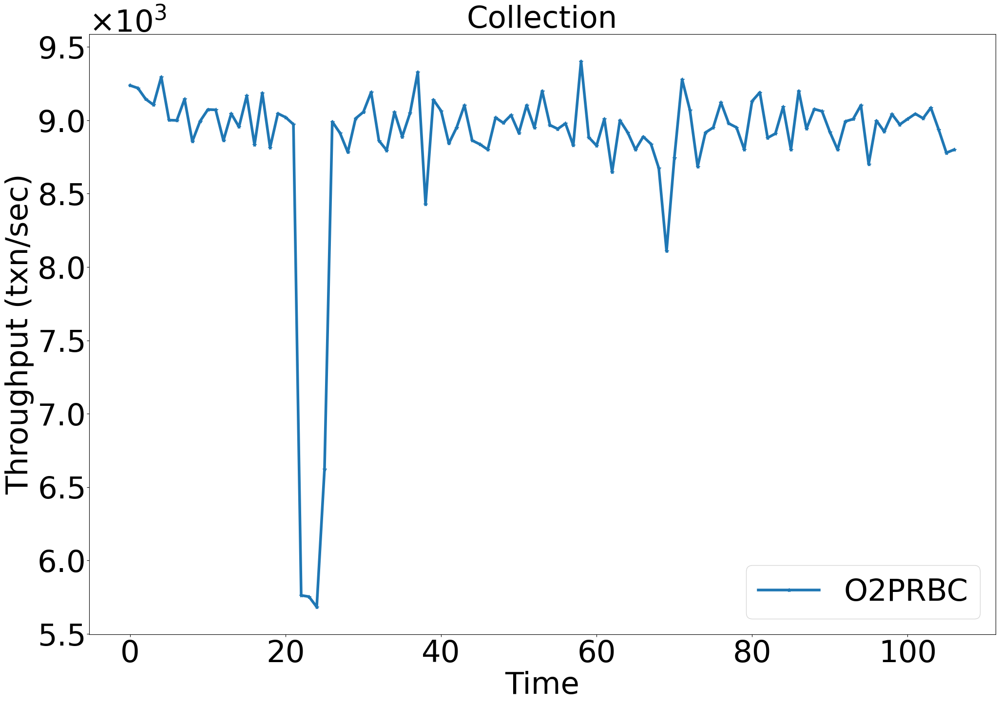

<Figure size 640x480 with 0 Axes>

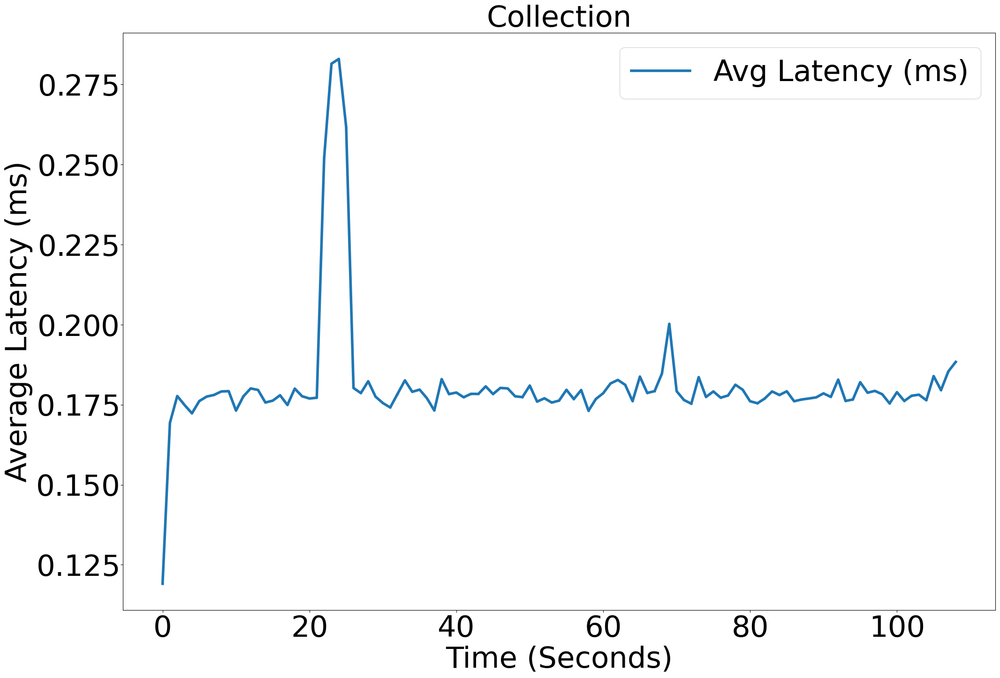

8948.854545454546 0.17874851706711342
../../Experiments/O2PRBC_multi_collect_16node100round
8917.48
folder is  O2PRBC_multi_collect_16node100round


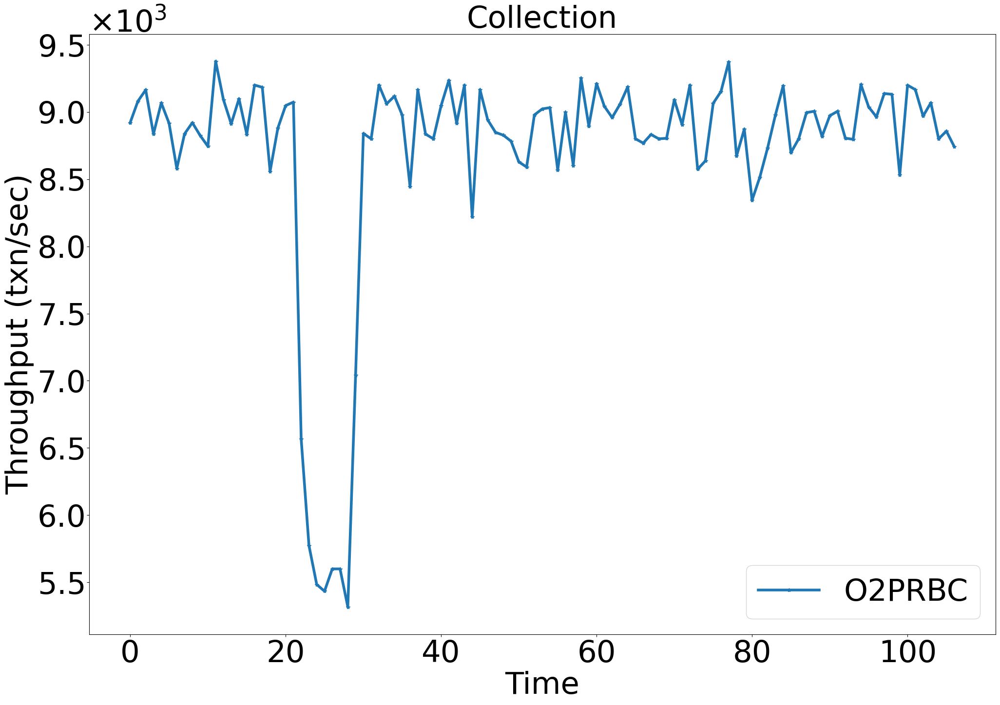

<Figure size 640x480 with 0 Axes>

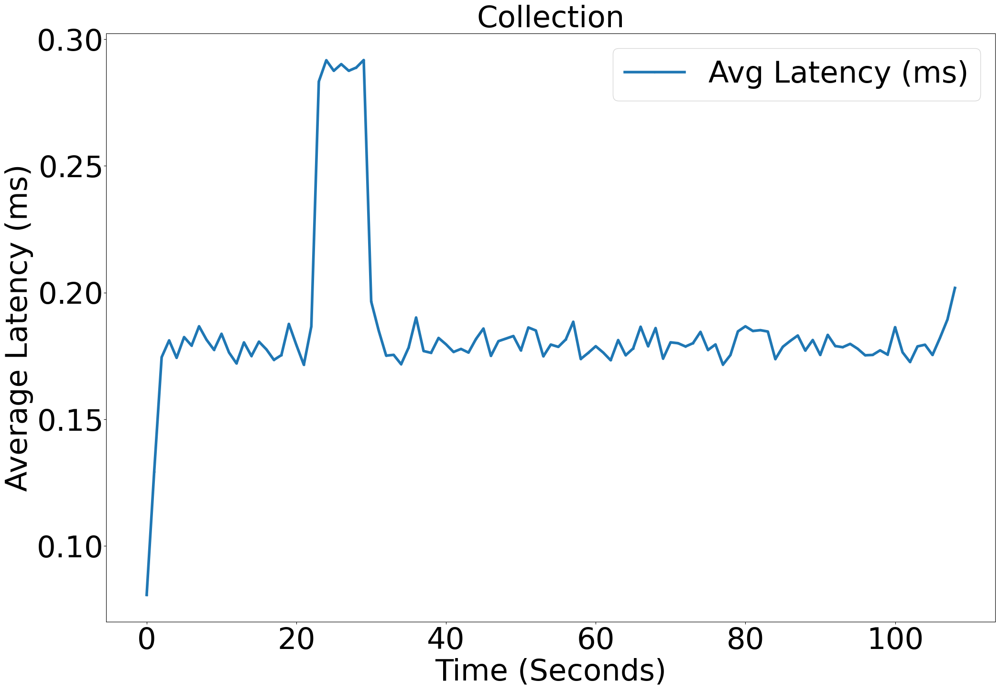

8909.781818181818 0.17944760047751582


In [17]:
all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

# for folder in ['all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

for folder in ['O2PRBC_multi_collect_16node1round',\
              'O2PRBC_multi_collect_16node10round',\
              'O2PRBC_multi_collect_16node50round',\
              'O2PRBC_multi_collect_16node100round']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)

    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))


    all_times_2.append(seconds)
    all_lats.append(avg_latency_per_sec)


        
    

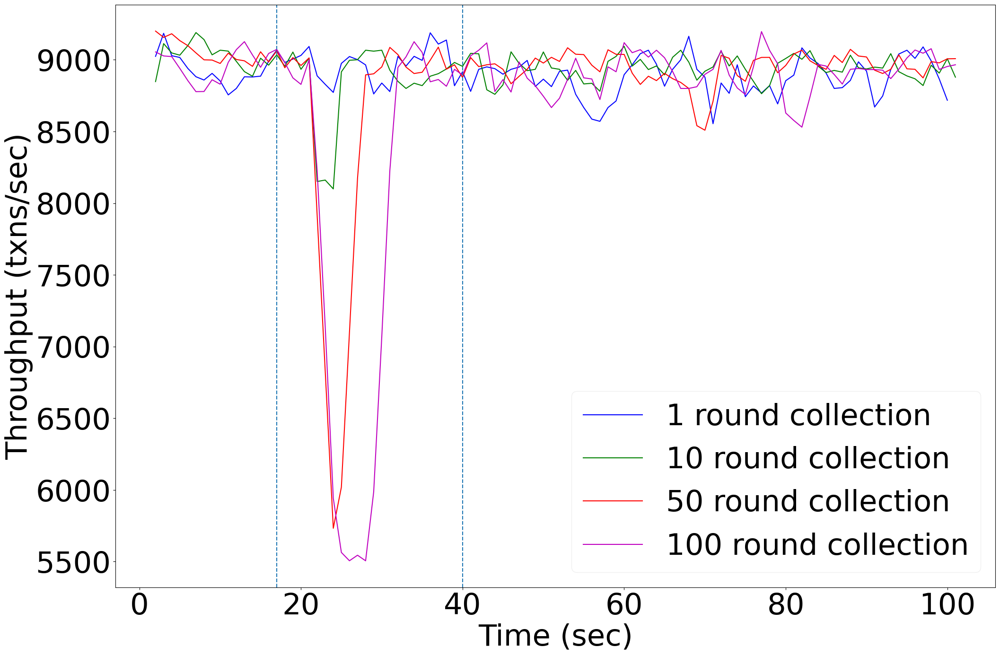

<Figure size 640x480 with 0 Axes>

In [28]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['1 round collection', '10 round collection', '50 round collection', '100 round collection']

for i in range(4):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.axvline(107 - 67, ls='--')
pl.axvline(105 - 88, ls='--')
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


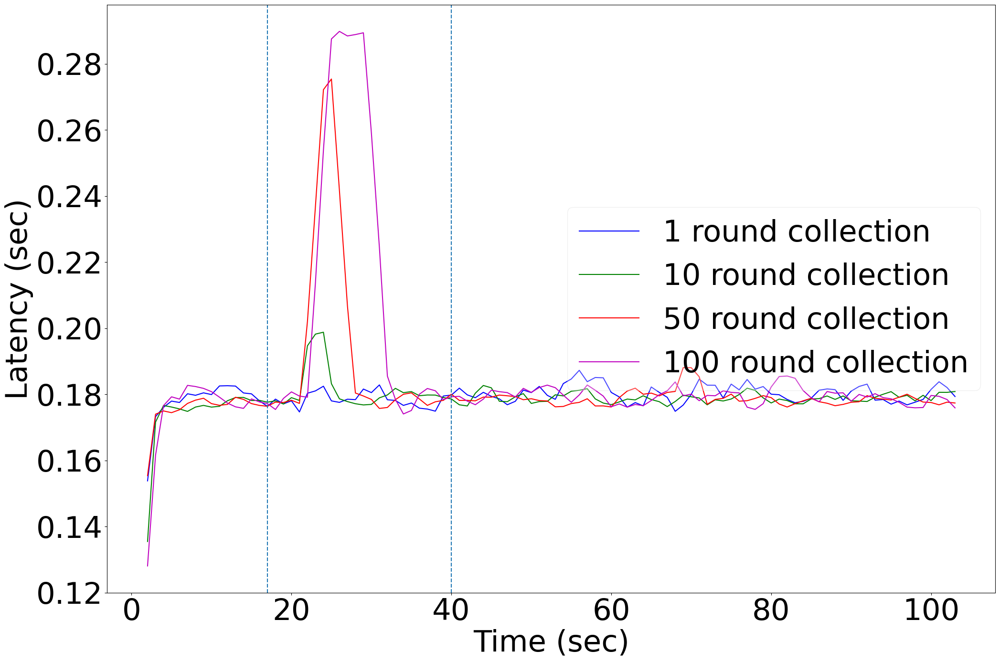

<Figure size 640x480 with 0 Axes>

In [29]:

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['1 round collection', '10 round collection', '50 round collection', '100 round collection']

for i in range(4):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # Align with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.axvline(107 - 67, ls='--')
pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_multi_collect_4node
11756.96
folder is  O2PRBC_multi_collect_4node


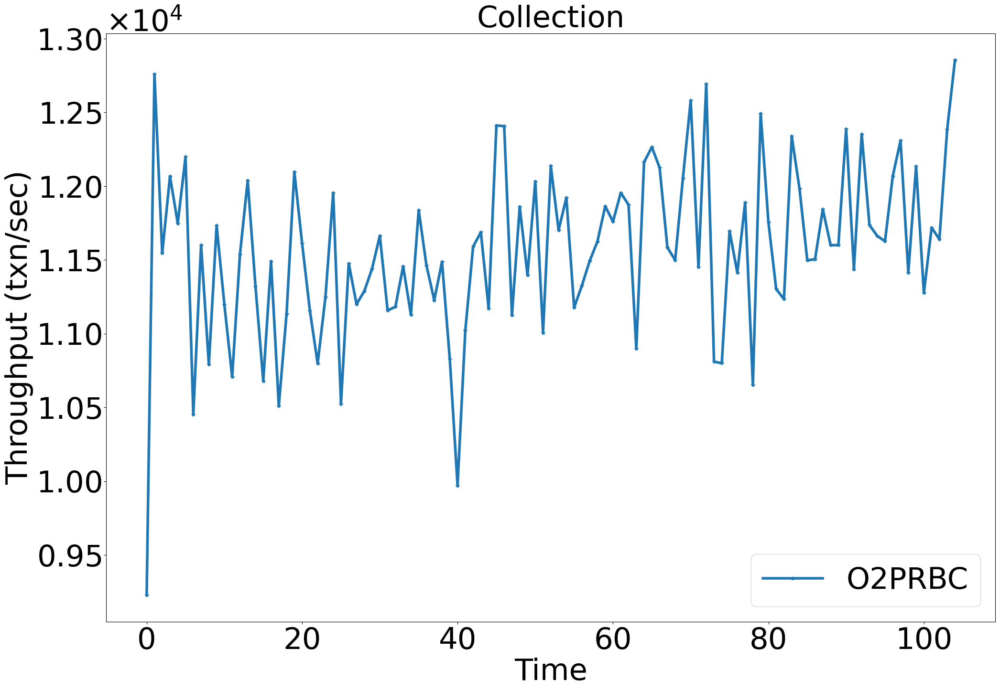

<Figure size 640x480 with 0 Axes>

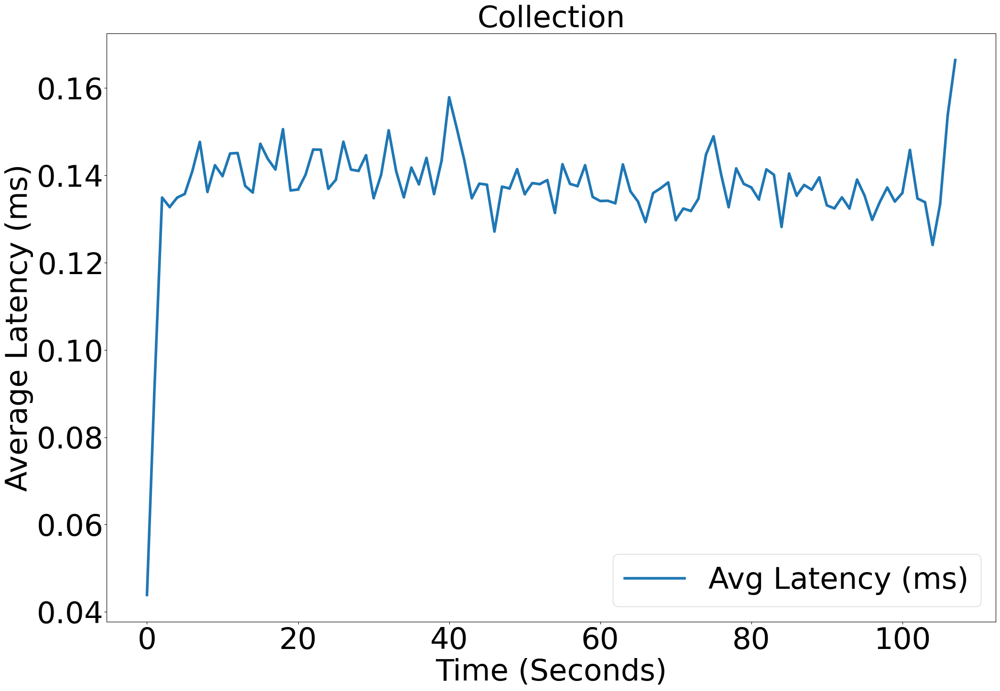

11744.072727272727 0.13665158683924739
../../Experiments/O2PRBC_multi_collect_8node
10009.36
folder is  O2PRBC_multi_collect_8node


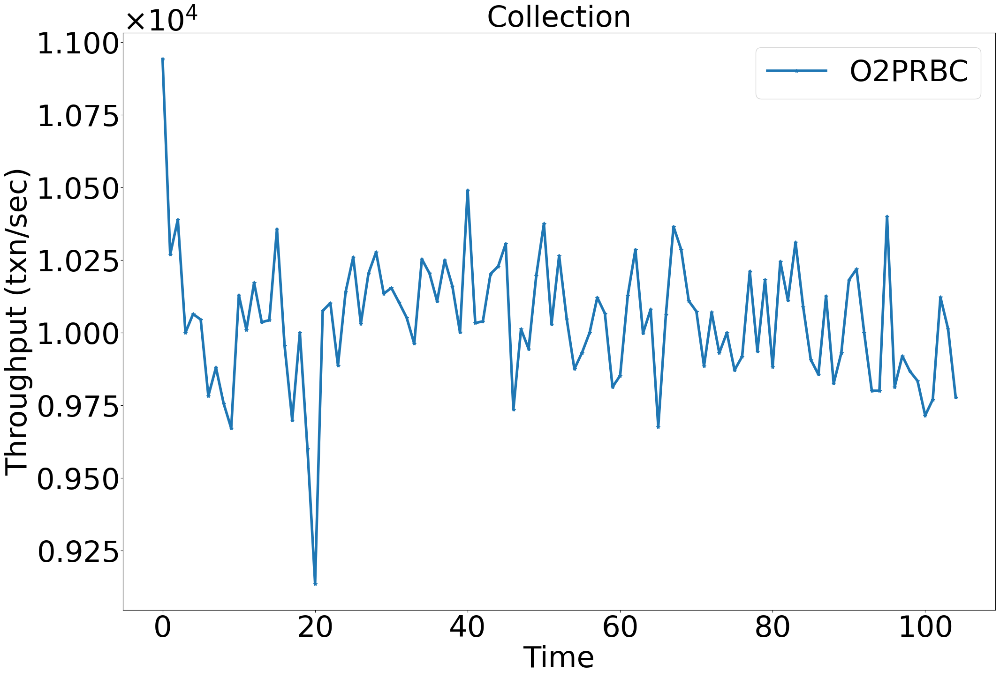

<Figure size 640x480 with 0 Axes>

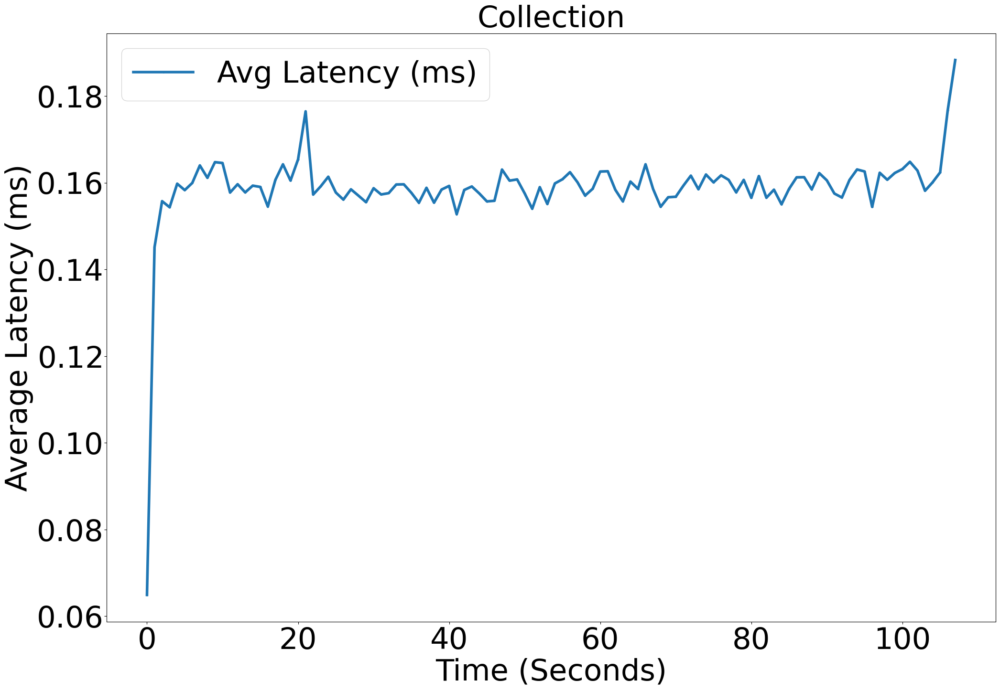

10031.781818181818 0.15958798350938017
../../Experiments/O2PRBC_multi_collect_16node
9395.2
folder is  O2PRBC_multi_collect_16node


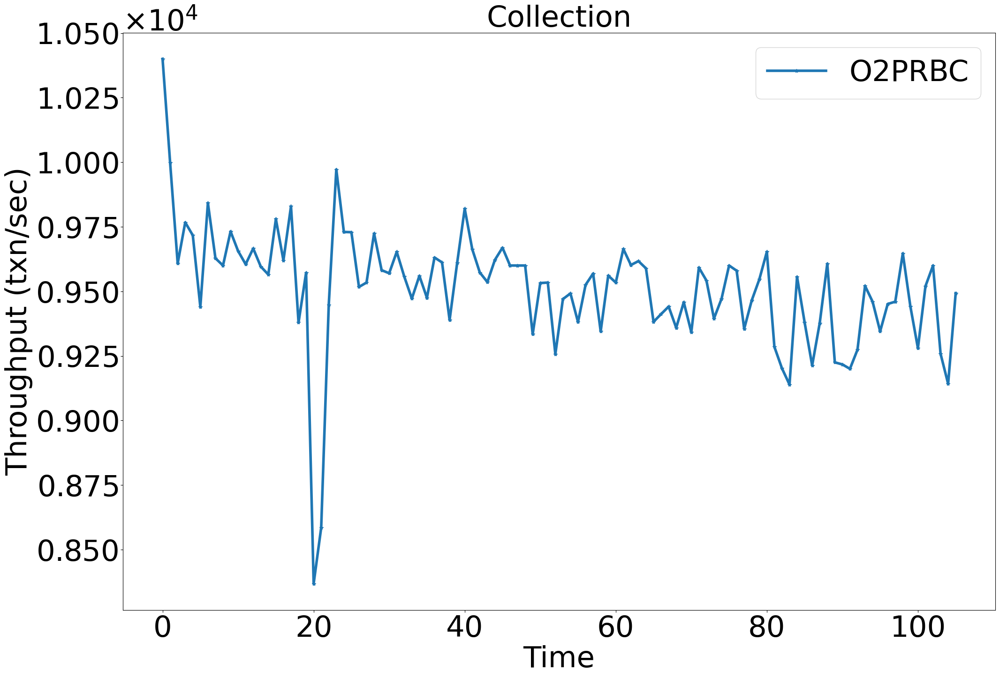

<Figure size 640x480 with 0 Axes>

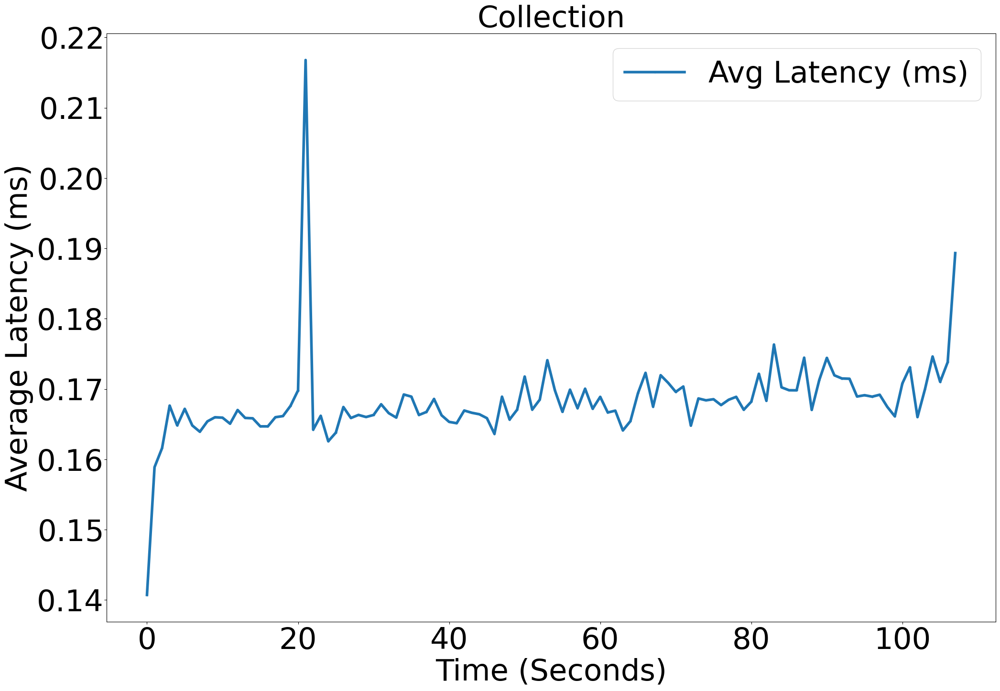

9448.727272727272 0.16924265583512724
../../Experiments/O2PRBC_multi_collect_test48
6192.0
folder is  O2PRBC_multi_collect_test48


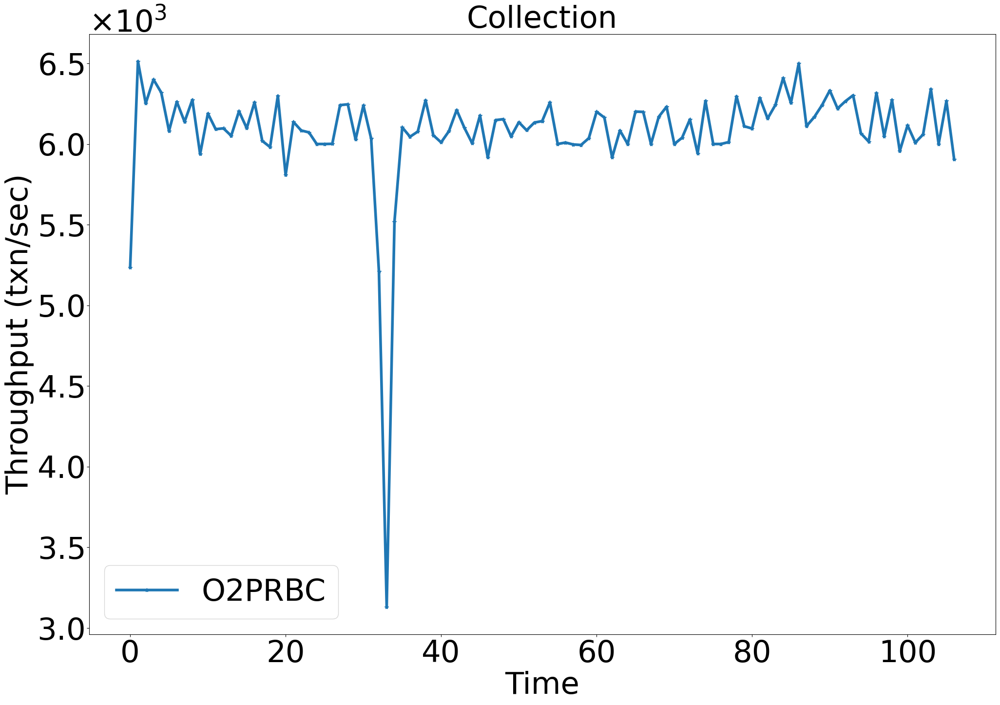

<Figure size 640x480 with 0 Axes>

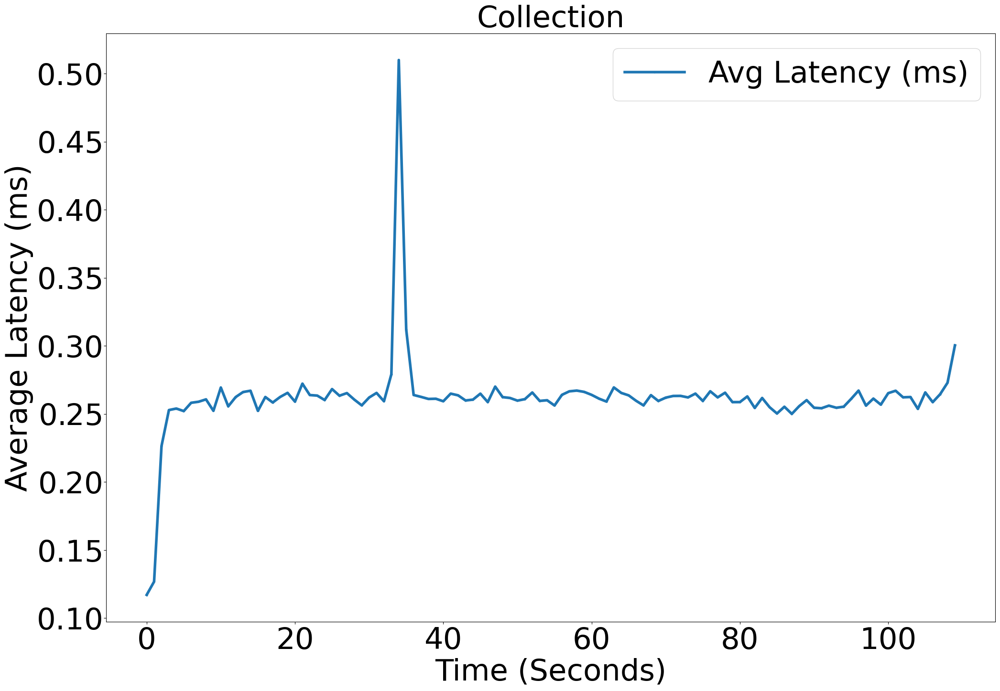

6136.4 0.2604797278252516
../../Experiments/O2PRBC_multi_collect_test96
3763.08
folder is  O2PRBC_multi_collect_test96


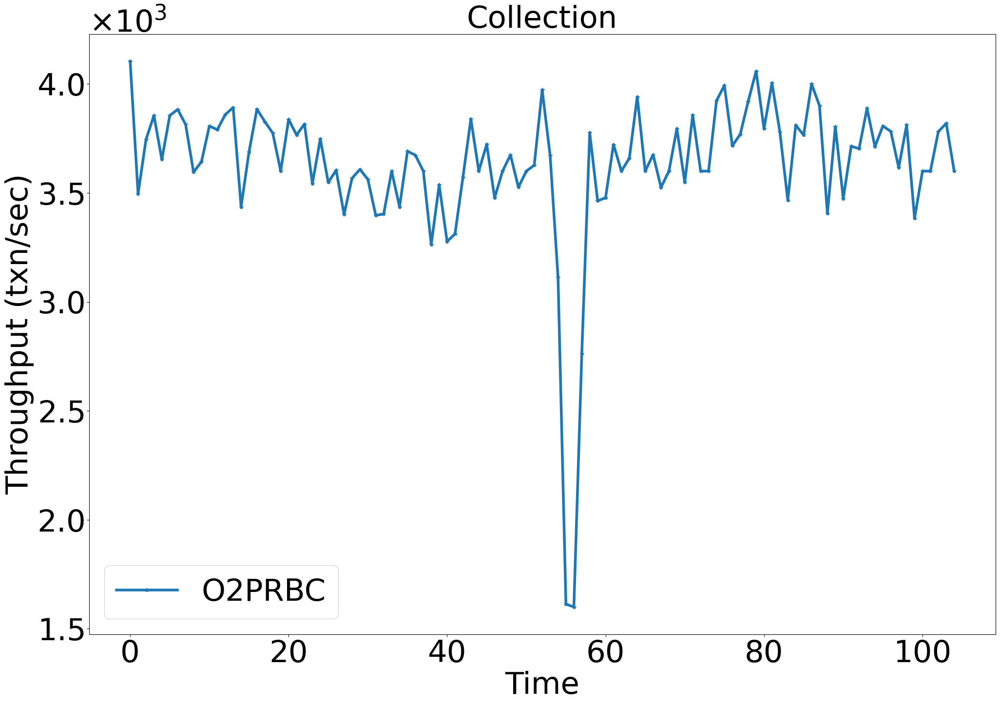

<Figure size 640x480 with 0 Axes>

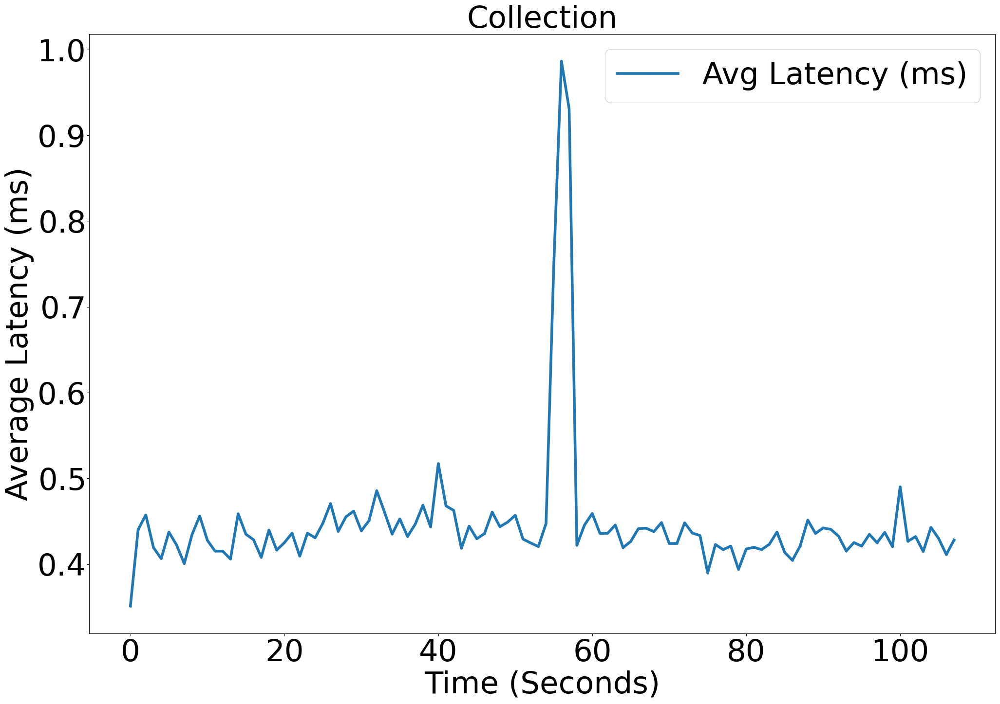

3607.2727272727275 0.45623045408224827


In [4]:
all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 


for folder in ['O2PRBC_multi_collect_4node',\
              'O2PRBC_multi_collect_8node',\
              'O2PRBC_multi_collect_16node',\
              'O2PRBC_multi_collect_test48',\
              'O2PRBC_multi_collect_test96']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)

    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))


    all_times_2.append(seconds)
    all_lats.append(avg_latency_per_sec)


        
    

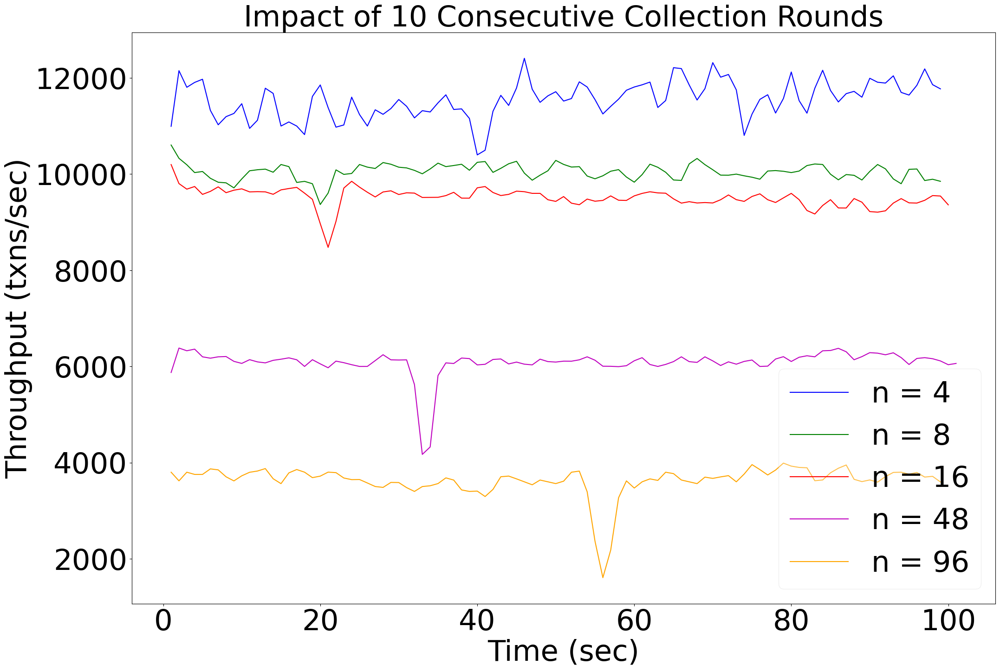

<Figure size 640x480 with 0 Axes>

In [5]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['n = 4', 'n = 8', 'n = 16', 'n = 48', 'n = 96']

for i in range(5):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 2
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


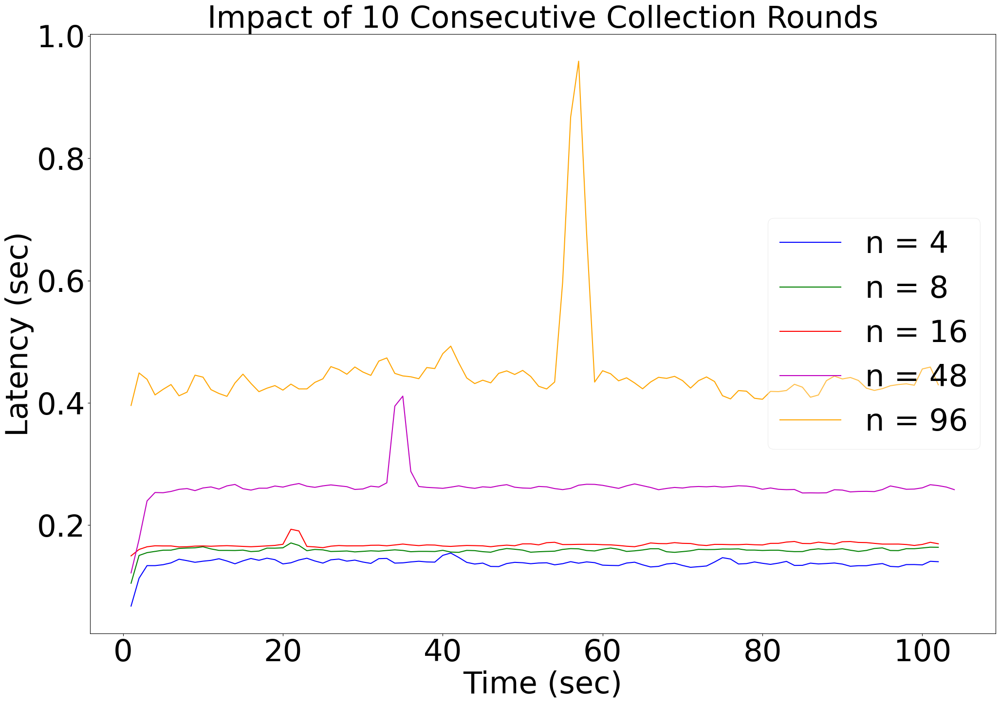

<Figure size 640x480 with 0 Axes>

In [6]:

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['n = 4', 'n = 8', 'n = 16', 'n = 48', 'n = 96']

for i in range(5):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 2
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # Align with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_multi_collect_latency16node0ms
8675.8
folder is  O2PRBC_multi_collect_latency16node0ms


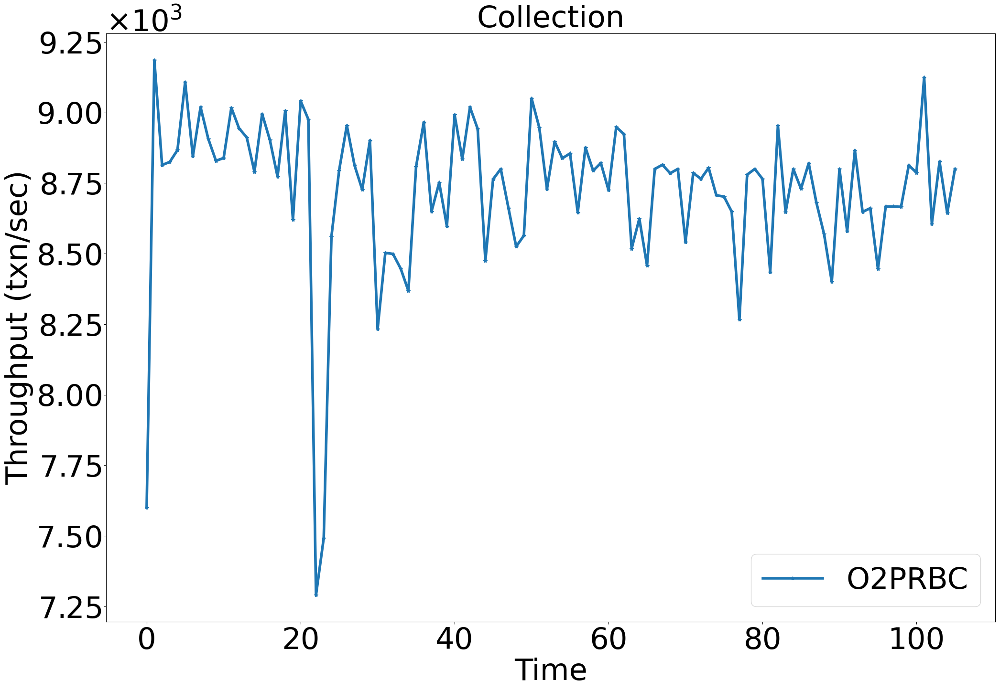

<Figure size 640x480 with 0 Axes>

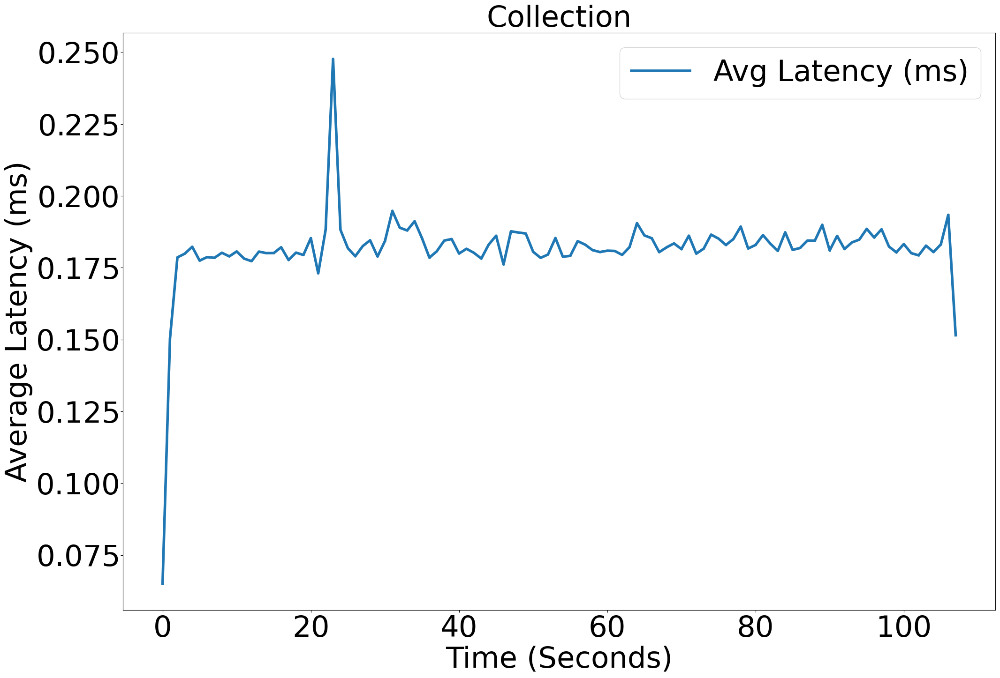

8720.0 0.18333184020926965
../../Experiments/O2PRBC_multi_collect_latency16node52ms
3632.0
folder is  O2PRBC_multi_collect_latency16node52ms


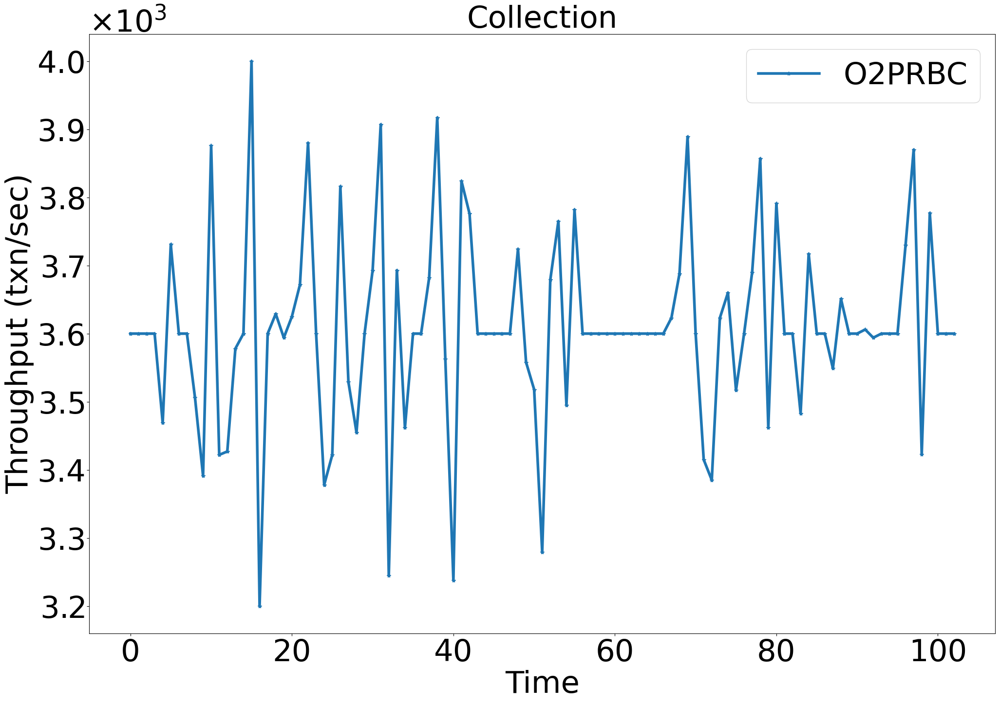

<Figure size 640x480 with 0 Axes>

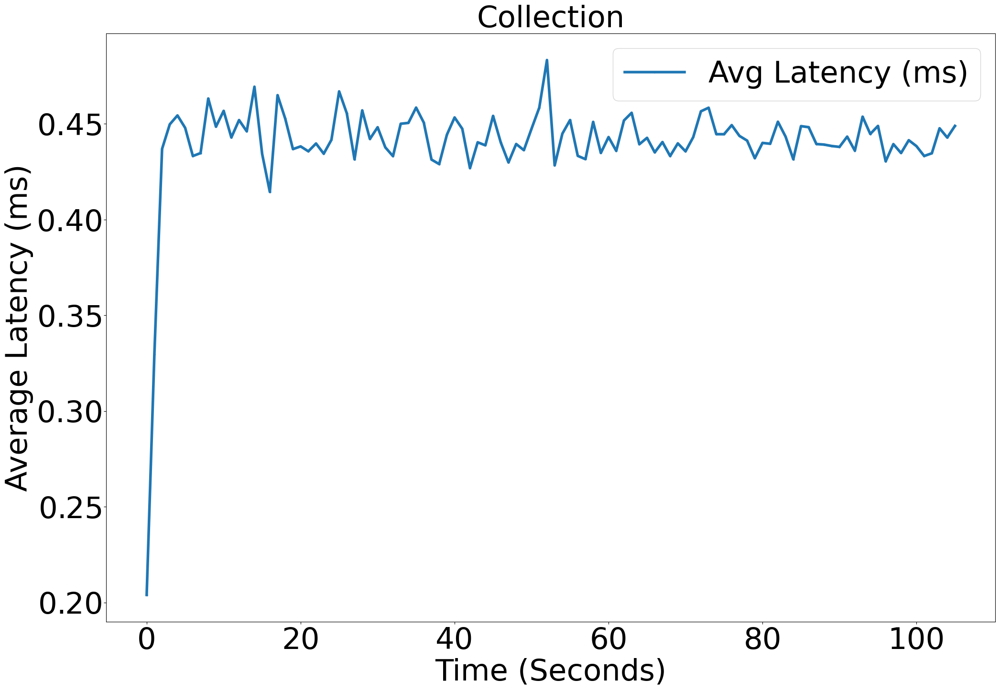

3614.5454545454545 0.44264213391582613
../../Experiments/O2PRBC_multi_collect_latency16node148ms
1368.36
folder is  O2PRBC_multi_collect_latency16node148ms


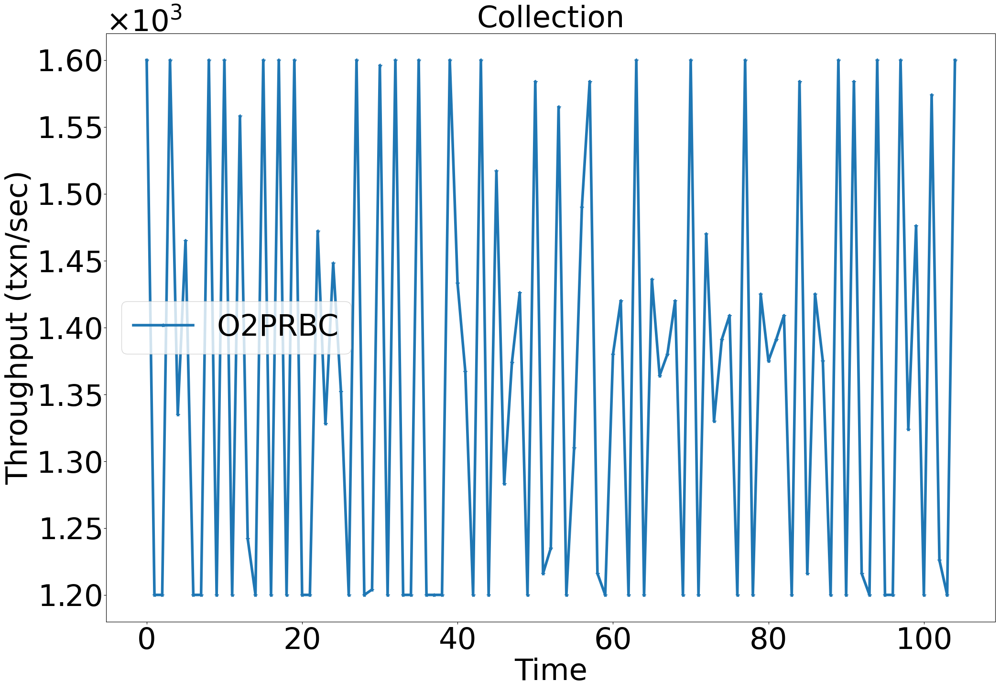

<Figure size 640x480 with 0 Axes>

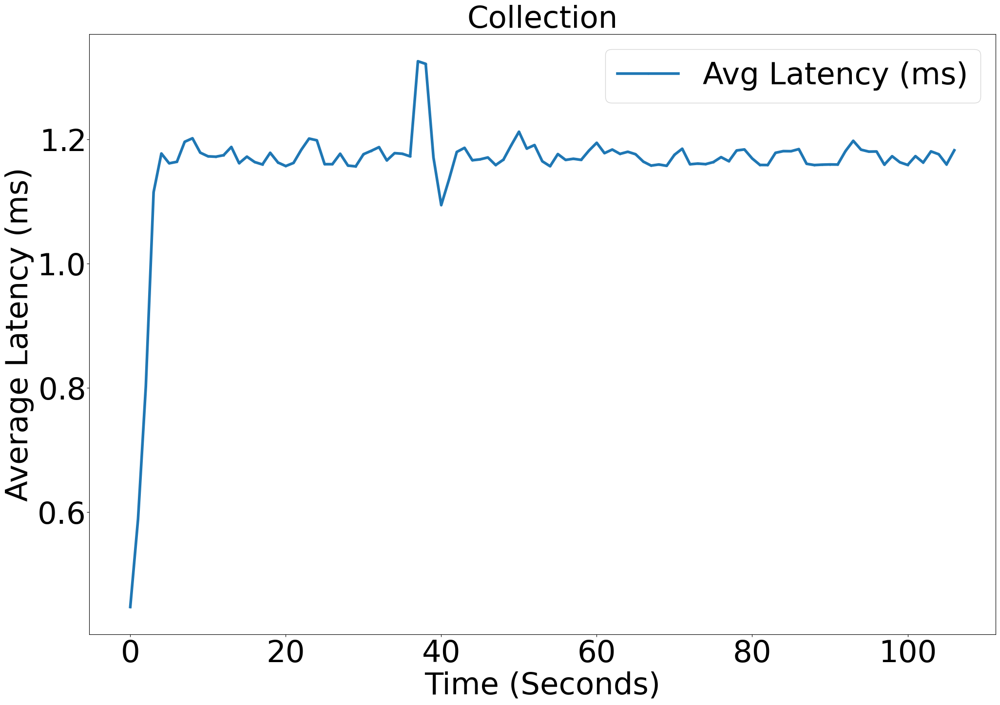

1367.2727272727273 1.172575895839464
../../Experiments/O2PRBC_multi_collect_latency16node214ms
915.08
folder is  O2PRBC_multi_collect_latency16node214ms


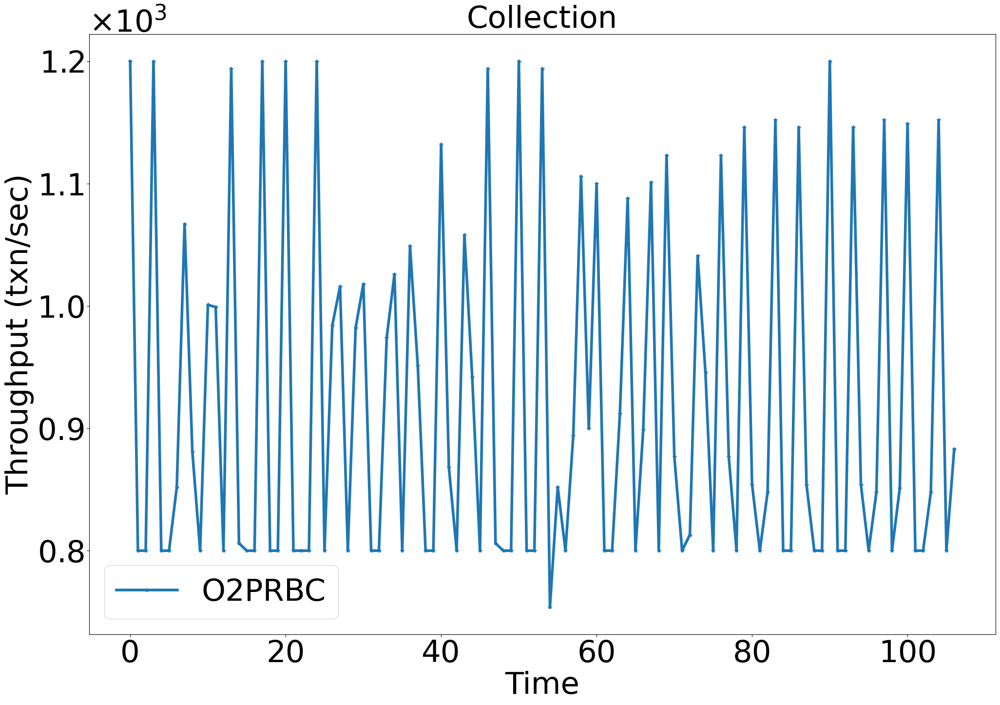

<Figure size 640x480 with 0 Axes>

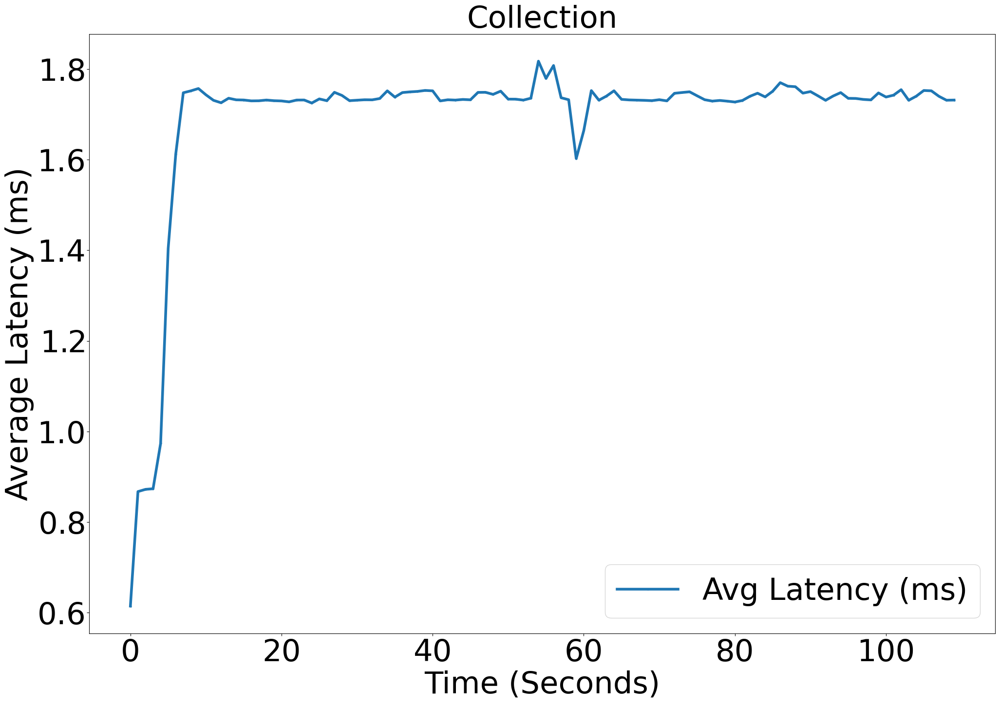

916.4727272727273 1.7392402146585777


In [31]:
all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 


for folder in ['O2PRBC_multi_collect_latency16node0ms', \
              'O2PRBC_multi_collect_latency16node52ms',\
              'O2PRBC_multi_collect_latency16node148ms',\
              'O2PRBC_multi_collect_latency16node214ms']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)

    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))


    all_times_2.append(seconds)
    all_lats.append(avg_latency_per_sec)


        
    

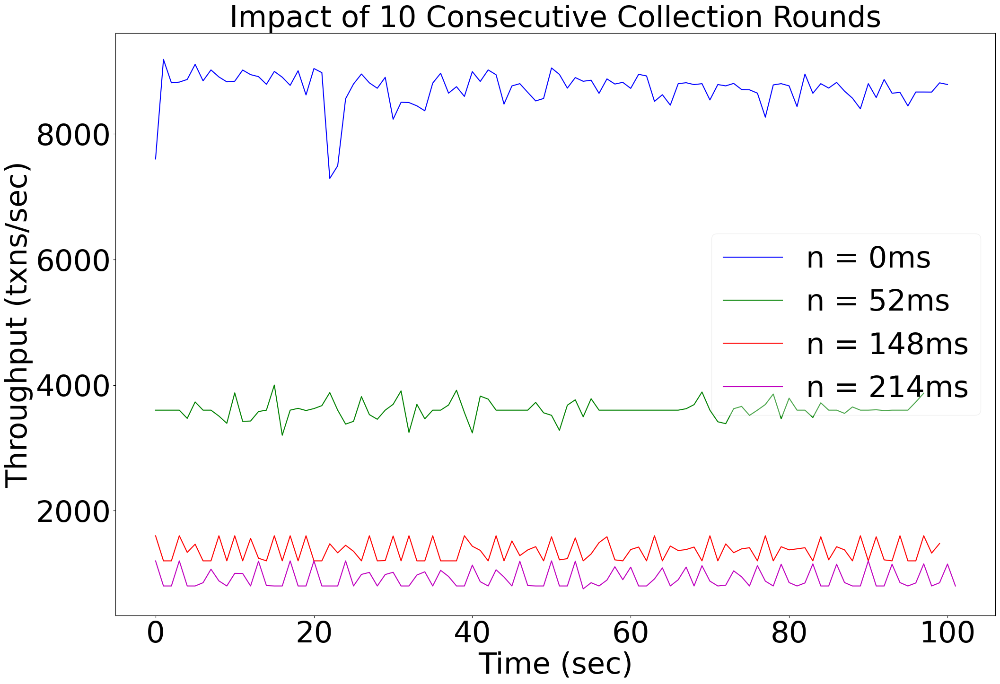

<Figure size 640x480 with 0 Axes>

In [34]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['n = 0ms', 'n = 52ms', 'n = 148ms', 'n = 214ms']

for i in range(len(labels)):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 1
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y


    # pl.plot(x_smooth, y_smooth/np.average(y_smooth[10:-10]), label=labels[i], color=colors[i])
    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


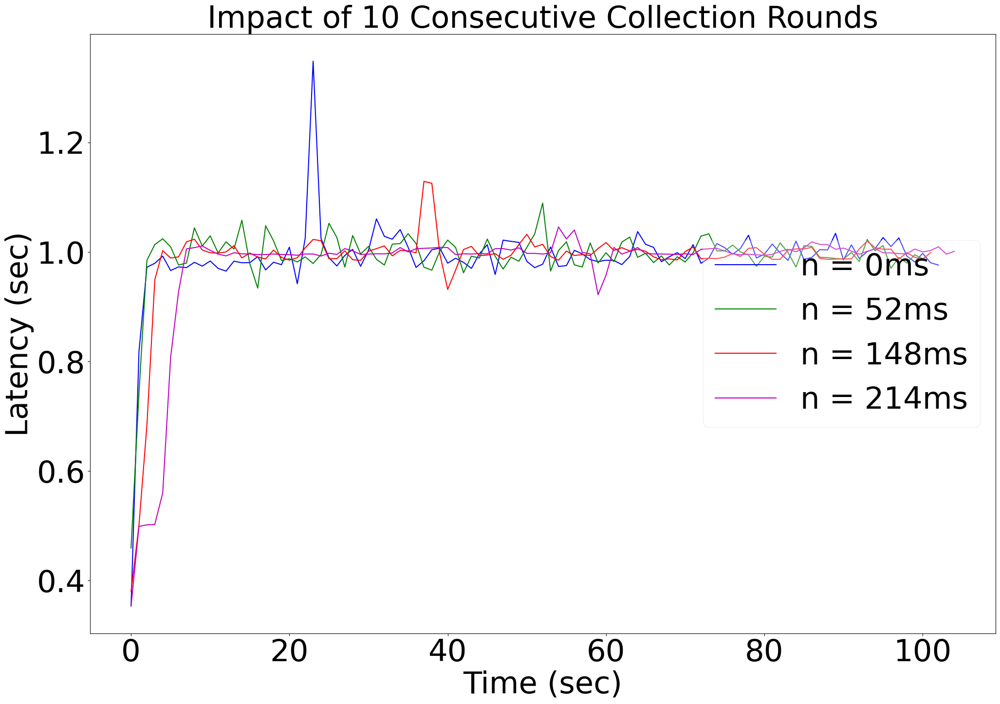

<Figure size 640x480 with 0 Axes>

In [35]:

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['n = 0ms', 'n = 52ms', 'n = 148ms', 'n = 214ms']


for i in range(len(labels)):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 1
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # Align with smoothed y

    pl.plot(x_smooth, y_smooth/np.average(y_smooth[10:-10]), label=labels[i], color=colors[i])
    # pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_multi_collect_latency48node
4886.68
folder is  O2PRBC_multi_collect_latency48node


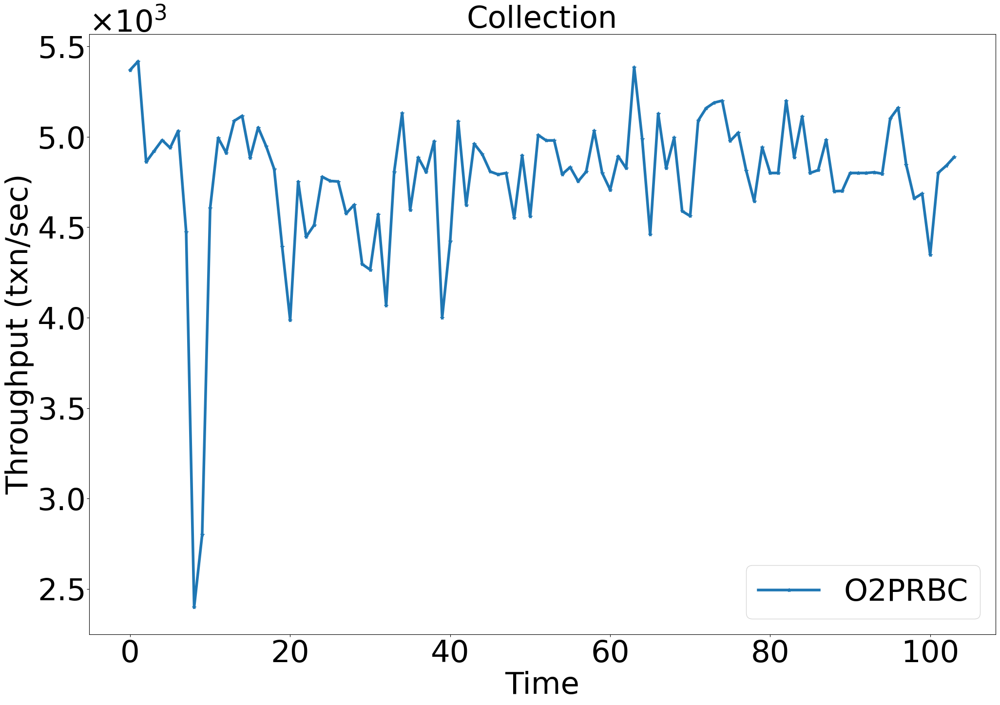

<Figure size 640x480 with 0 Axes>

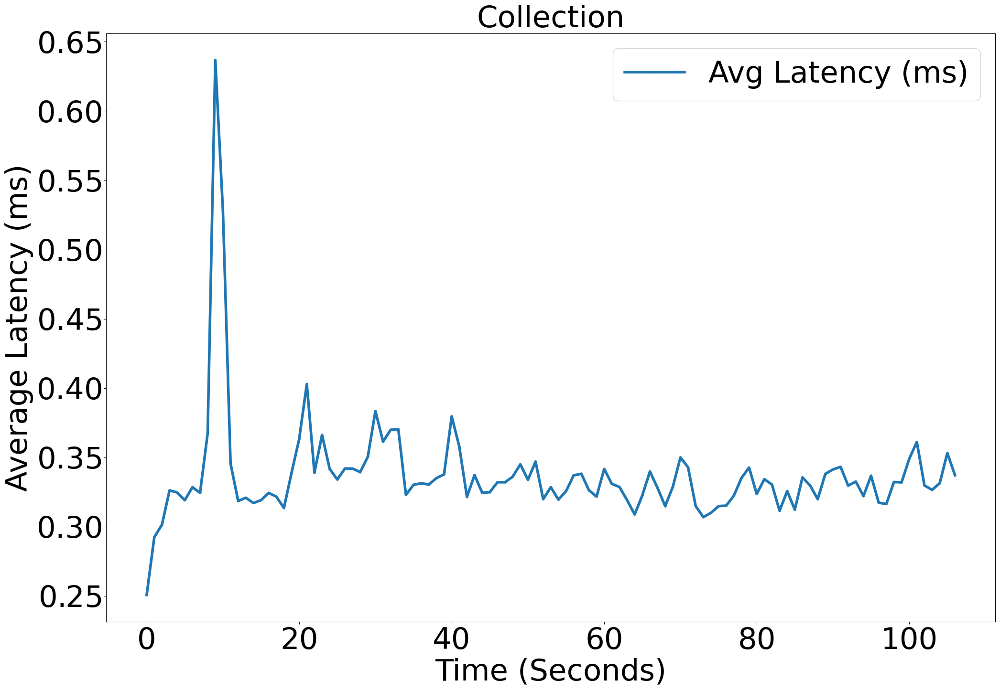

4877.672727272728 0.3290620457398867
../../Experiments/O2PRBC_multi_collect_latency48node52ms
3360.0
folder is  O2PRBC_multi_collect_latency48node52ms


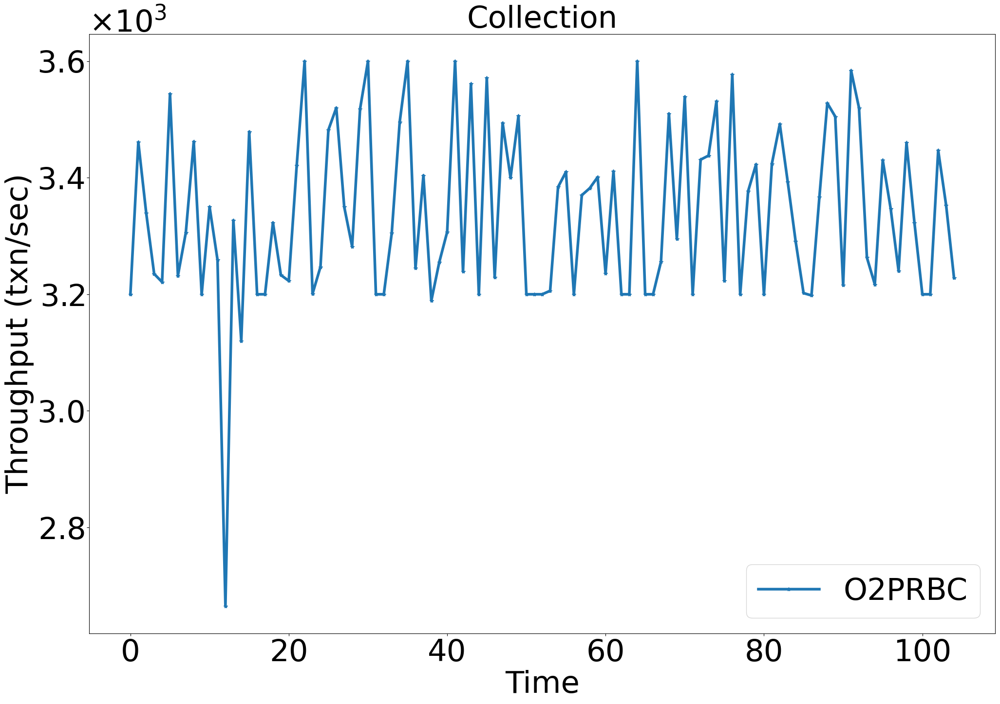

<Figure size 640x480 with 0 Axes>

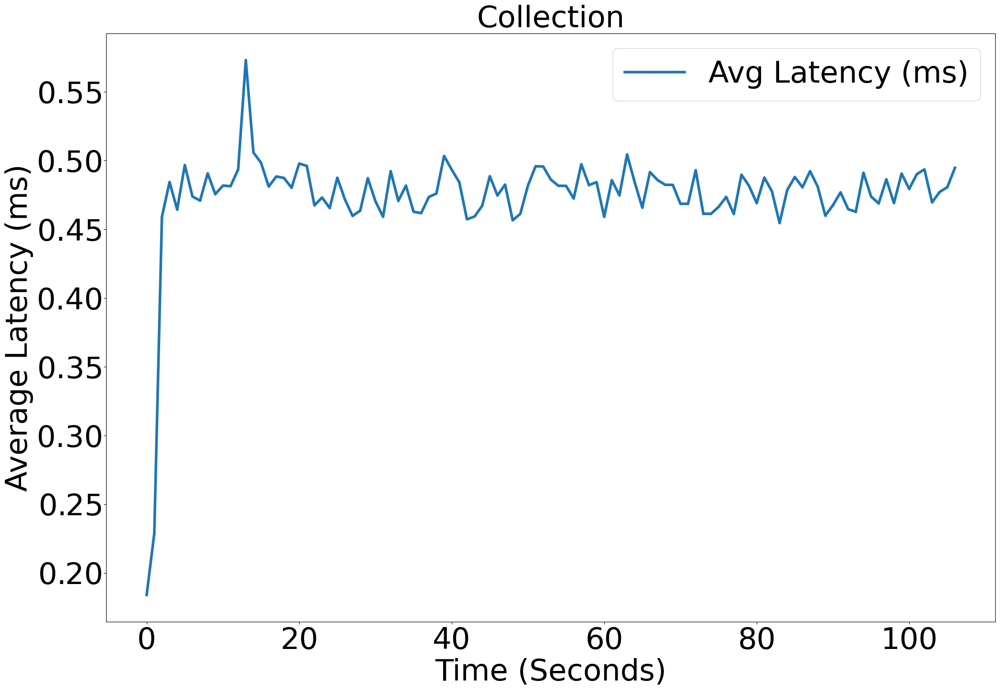

3352.7272727272725 0.47796914396449547
../../Experiments/O2PRBC_multi_collect_latency48node91ms
2128.04
folder is  O2PRBC_multi_collect_latency48node91ms


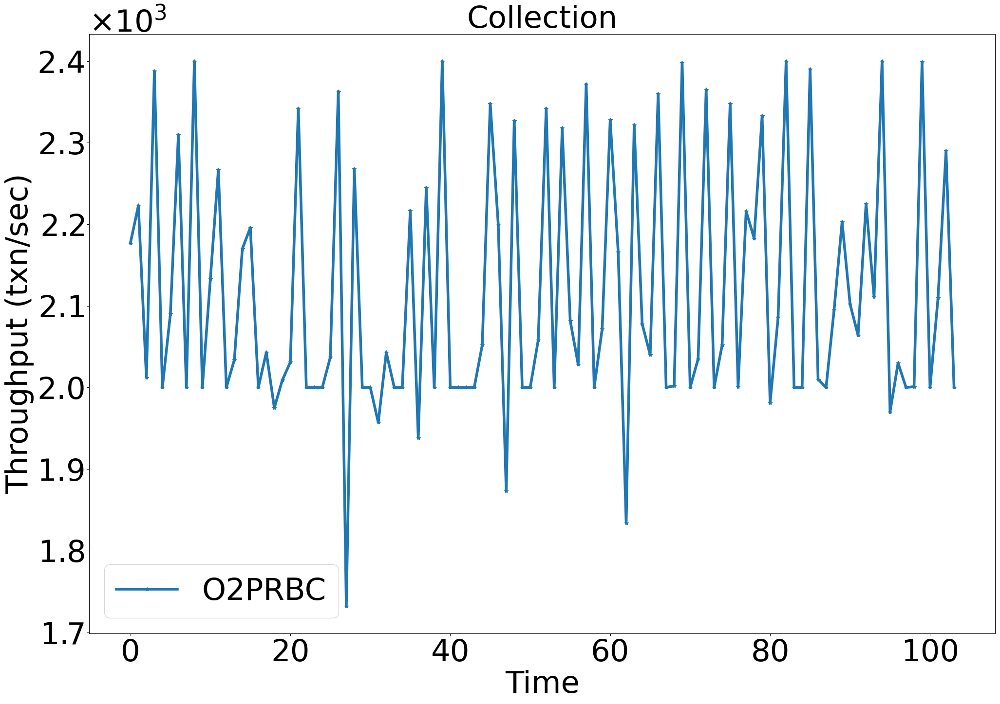

<Figure size 640x480 with 0 Axes>

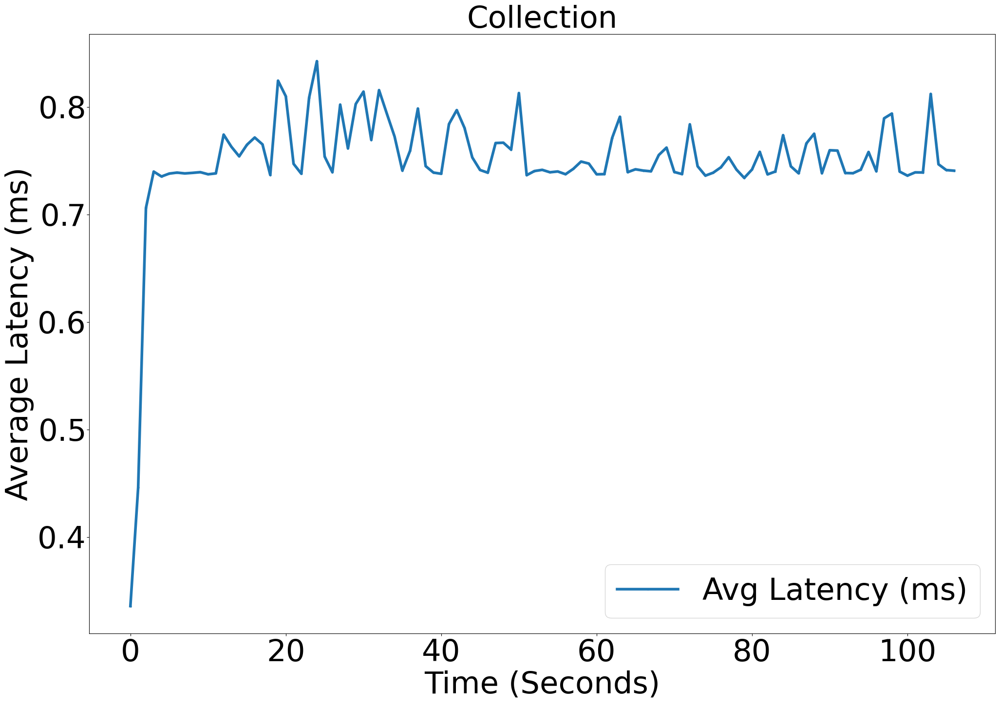

2130.927272727273 0.7507580350242014
../../Experiments/O2PRBC_multi_collect_latency48node148ms
1323.8
folder is  O2PRBC_multi_collect_latency48node148ms


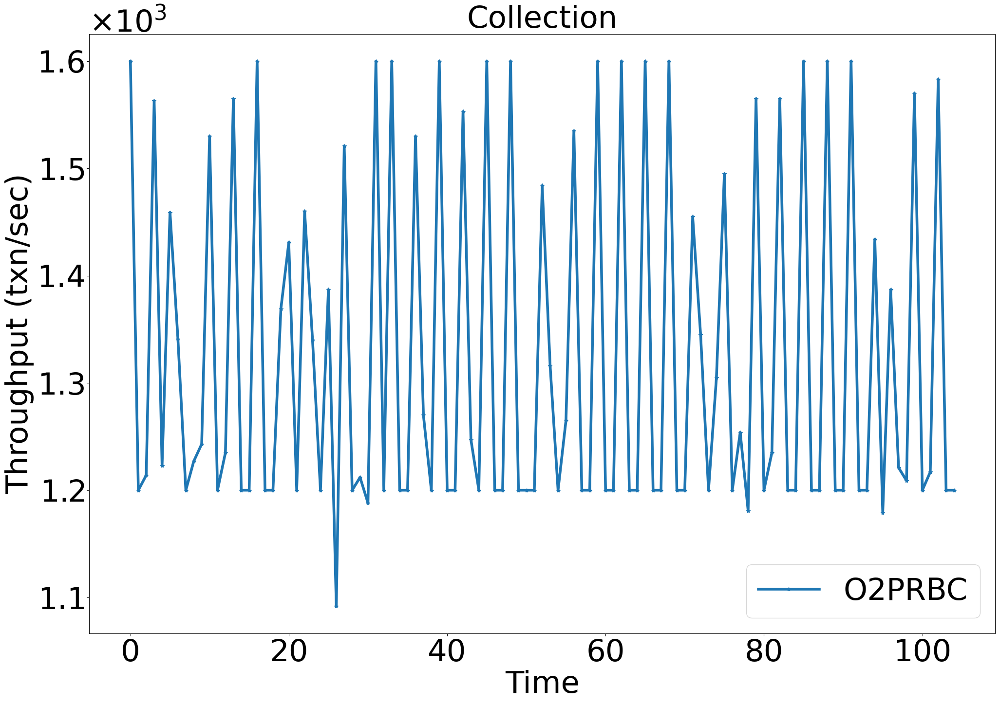

<Figure size 640x480 with 0 Axes>

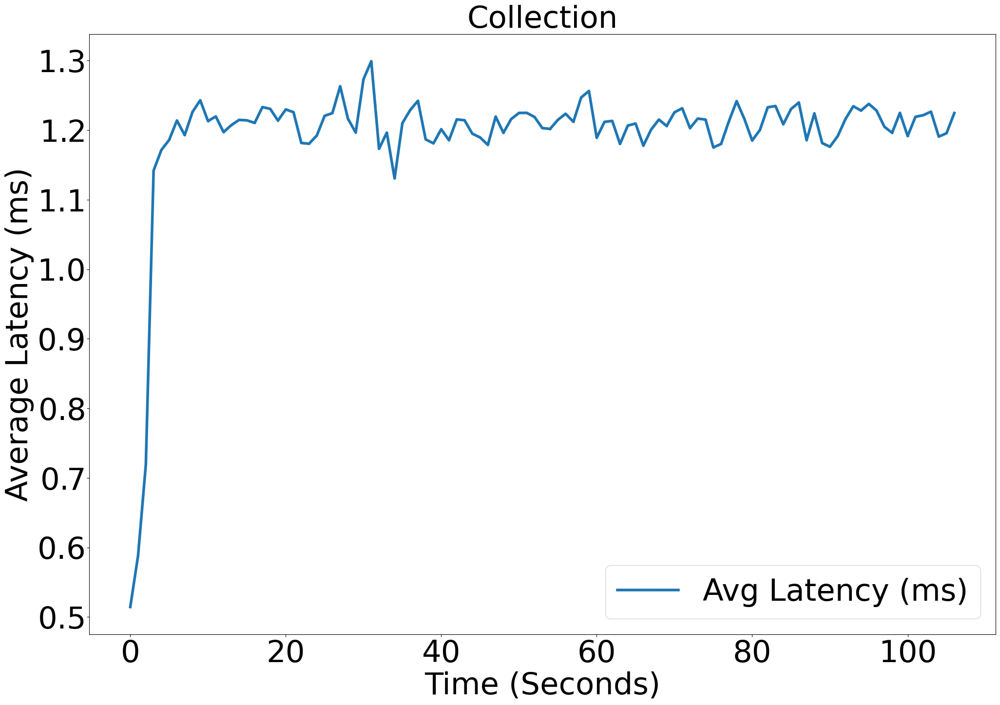

1323.6363636363637 1.211854605638611
../../Experiments/O2PRBC_multi_collect_latency48node214ms
896.0
folder is  O2PRBC_multi_collect_latency48node214ms


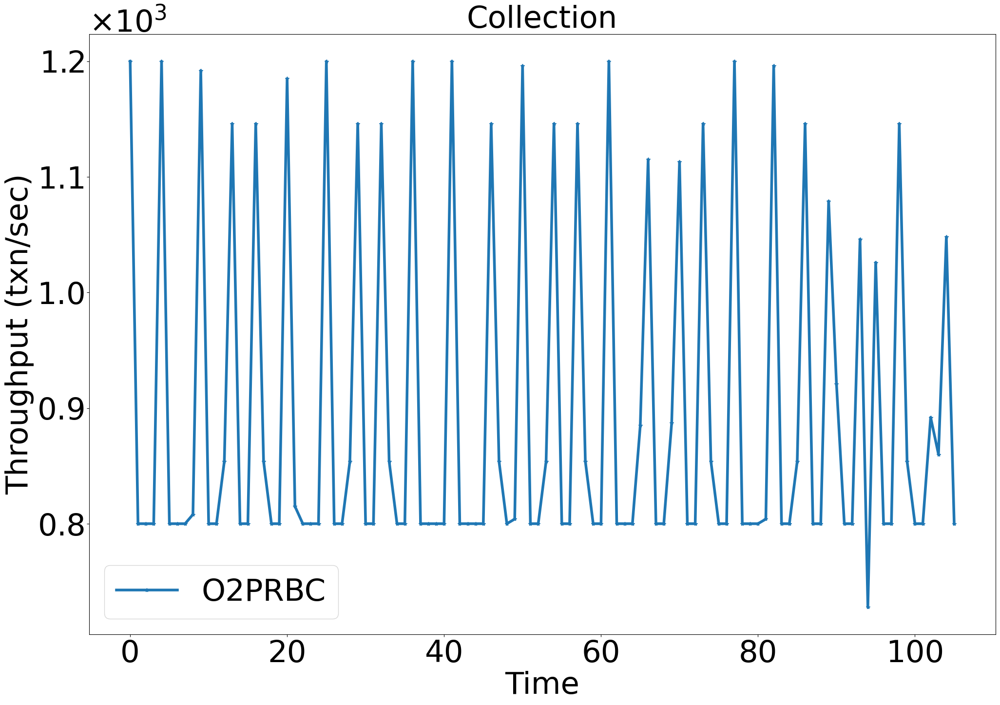

<Figure size 640x480 with 0 Axes>

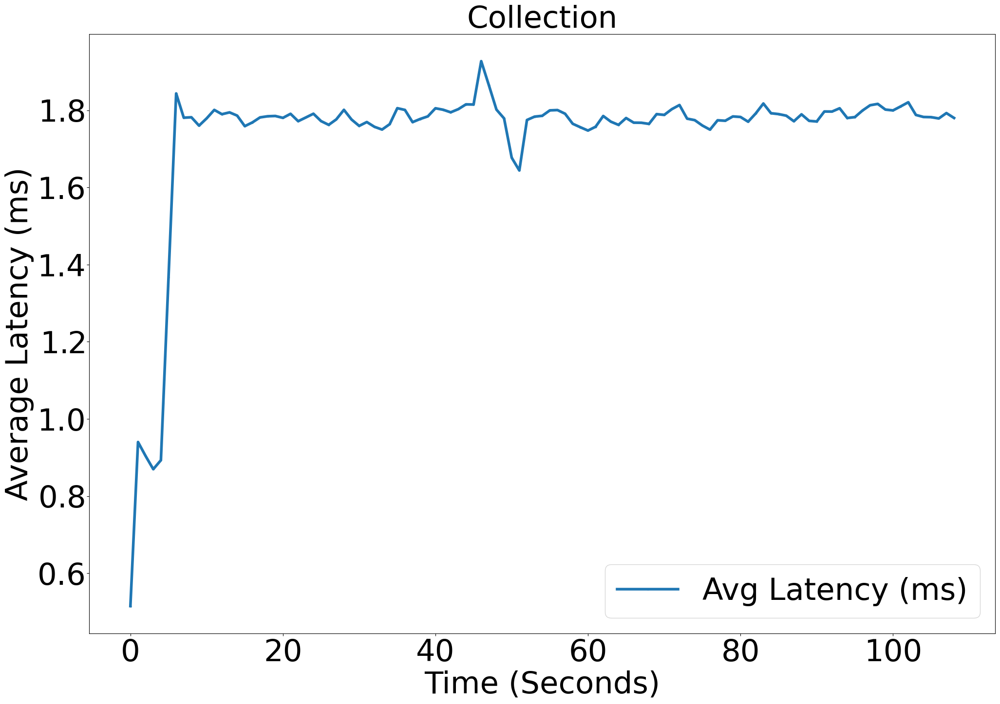

901.8181818181819 1.7799216009572114


In [41]:


all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 


for folder in ['O2PRBC_multi_collect_latency48node', 'O2PRBC_multi_collect_latency48node52ms', 'O2PRBC_multi_collect_latency48node91ms',\
              'O2PRBC_multi_collect_latency48node148ms','O2PRBC_multi_collect_latency48node214ms']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)

    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-60:-5]), np.average(avg_latency_per_sec[-60:-5]))


    all_times_2.append(seconds)
    all_lats.append(avg_latency_per_sec)


        
    

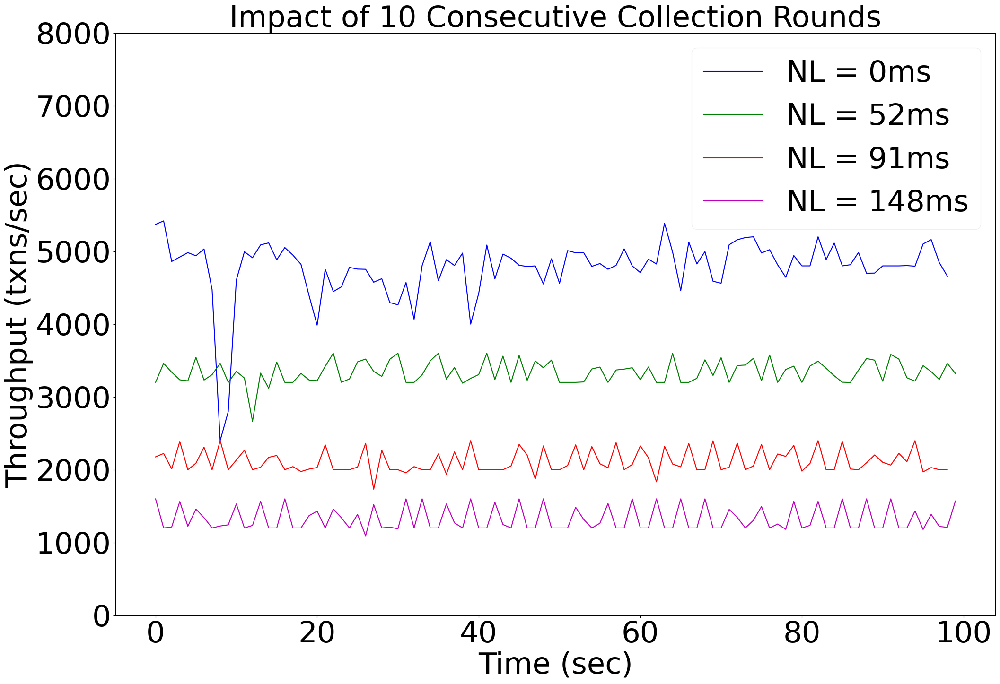

<Figure size 640x480 with 0 Axes>

In [50]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['NL = 0ms', 'NL = 52ms', 'NL = 91ms', 'NL = 148ms']

for i in range(len(labels)):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 1
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y


    # pl.plot(x_smooth, y_smooth/np.average(y_smooth[10:-10]), label=labels[i], color=colors[i])
    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
pl.ylim(0, 8000)
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection_NL.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


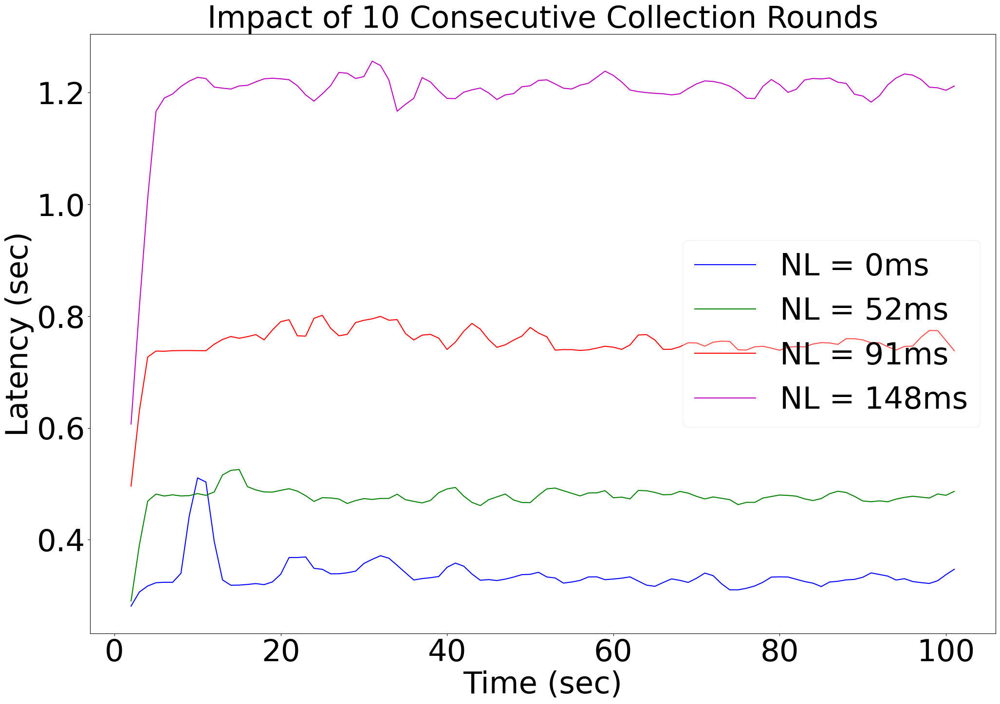

<Figure size 640x480 with 0 Axes>

In [51]:

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['NL = 0ms', 'NL = 52ms', 'NL = 91ms', 'NL = 148ms']

for i in range(len(labels)):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # Align with smoothed y

    # pl.plot(x_smooth, y_smooth/np.average(y_smooth[10:-10]), label=labels[i], color=colors[i])
    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection_NL.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_normalv2_16node
3912.0
folder is  O2PRBC_normalv2_16node


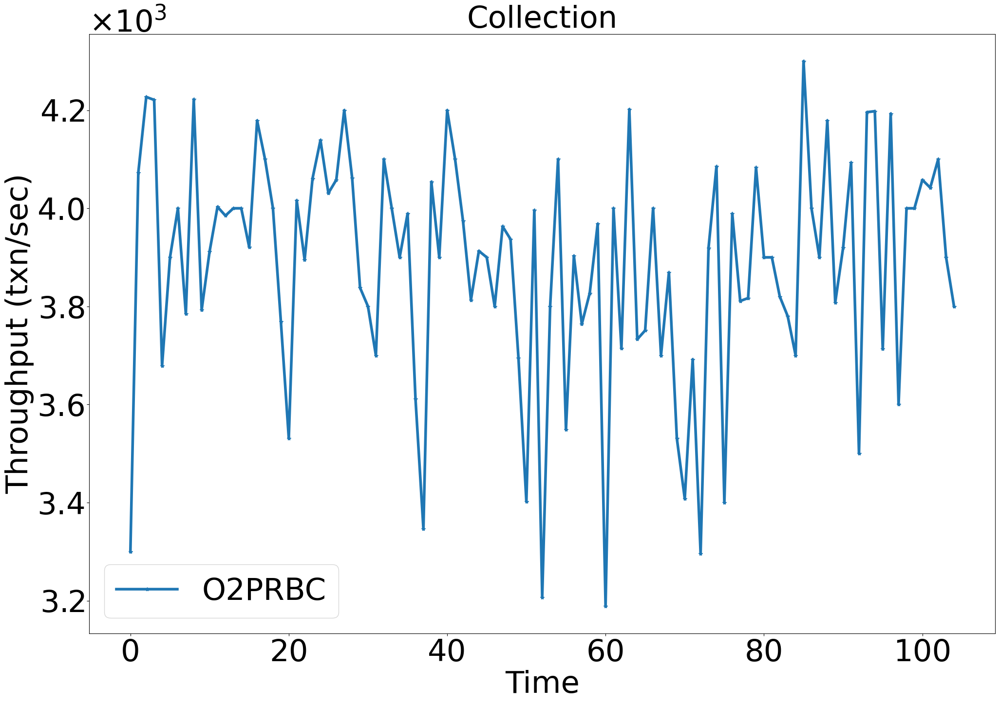

<Figure size 640x480 with 0 Axes>

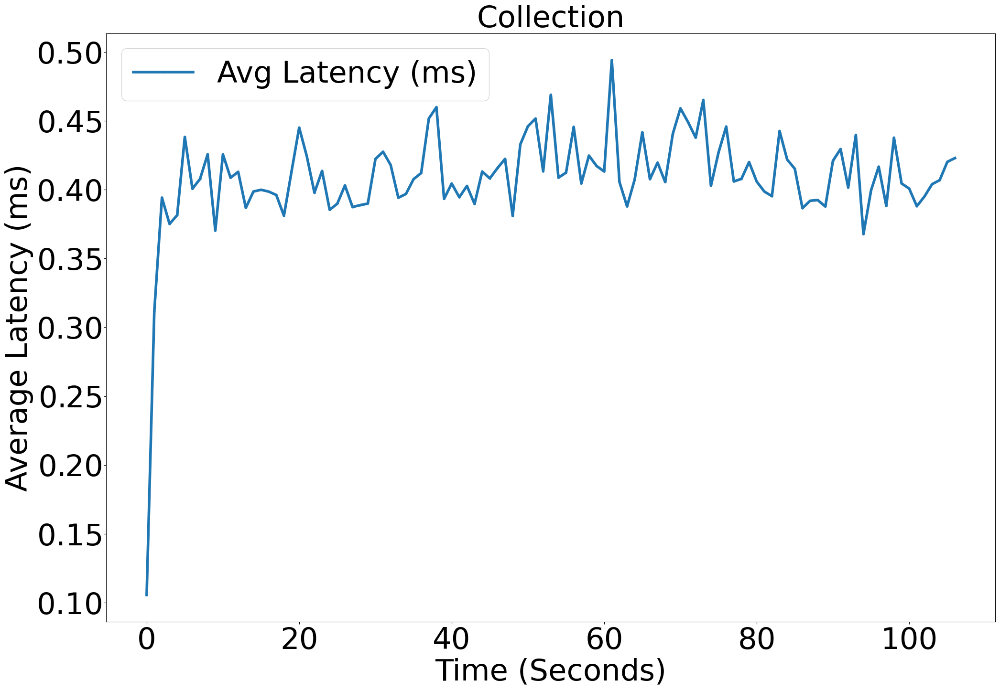

3857.1866666666665 0.4157647161245176


In [9]:


all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 


for folder in ['O2PRBC_normalv2_16node']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    int_times = Times.astype(int)

    # Find the range of seconds
    min_time, max_time = int_times.min(), int_times.max()
    num_seconds = max_time - min_time + 1

    # Compute sum of latencies per second
    latency_sums = np.bincount(int_times - min_time, weights=lats, minlength=num_seconds)

    # Compute count per second
    counts = np.bincount(int_times - min_time, minlength=num_seconds)

    # Avoid division by zero and compute average latency per second
    avg_latency_per_sec = np.divide(latency_sums, counts, where=(counts > 0))

    # Generate second timestamps
    seconds = np.arange(min_time, max_time + 1)
    seconds = seconds - seconds[0]
    # Plot the results
    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    pl.plot(seconds, avg_latency_per_sec, marker='o', linestyle='-', markersize=2, \
            label="Avg Latency (ms)", linewidth = 4)

    ax.yaxis.set_major_formatter(formatter)

    pl.xlabel("Time (Seconds)")
    pl.ylabel("Average Latency (ms)")
#         pl.ylim(0,0.02)
    pl.title('Collection')
    pl.legend()
#         pl.savefig('/home/tejas/Desktop/O2PRBC/collectlatsV2.png', dpi = 150, bbox_inches='tight' )

    pl.show()

    print(np.average(s2[-80:-5]), np.average(avg_latency_per_sec[-80:-5]))


    all_times_2.append(seconds)
    all_lats.append(avg_latency_per_sec)


        
    

In [5]:
def getThroughput(experiment):
    
    temp_lines = []

    result = subprocess.check_output('cat ../'+experiment+'/dump_files/nohup_client_*', shell=True)


    result = result.decode("utf-8") 

    lines = result.split('\n')

    commit_pat = re.compile(r'([^[].*) \[hotstuff info\] ([0-9.]*)$')
#     commit_pat = re.compile('([^[].*) \[hotstuff info\] got*')

    Times = []
    lats = []

    for line in lines:
        m = commit_pat.match(line)
        if m:
            try:
                temp_lines.append(line)
                time_item = float((line.split(' ')[1]).split(':')[0])*3600 + float((line.split(' ')[1]).split(':')[1])*60 + \
                float((line.split(' ')[1]).split(':')[2])
                Times.append(time_item)        

                lats.append(float(m.group(2)))
            except:
                continue


    begin_time = None
    values = []
    interval = 1
    cnt = 0
    
    # Get sorted indices
    sorted_indices = np.argsort(Times)

    # Apply sorting to both arrays
    
    
    Times = np.array(Times)[sorted_indices.astype(np.int32)]
    lats_sorted = np.array(lats)[sorted_indices.astype(np.int32)]
    
    for timestamp in Times:
        if begin_time is None:
            begin_time = timestamp
            next_begin_time = timestamp +interval

        while timestamp >= next_begin_time:
            begin_time = next_begin_time
            next_begin_time += interval
            values.append(cnt)
            cnt = 0
        cnt += 1
    values.append(cnt)

#     lats, _ = remove_outliers(lats)
#     print(len(values))


    return np.arange(len(values))*interval,np.array(values)/interval, lats_sorted, temp_lines, Times


../../Experiments/O2PRBC_multi_collect_latency48node
4886.68
folder is  O2PRBC_multi_collect_latency48node


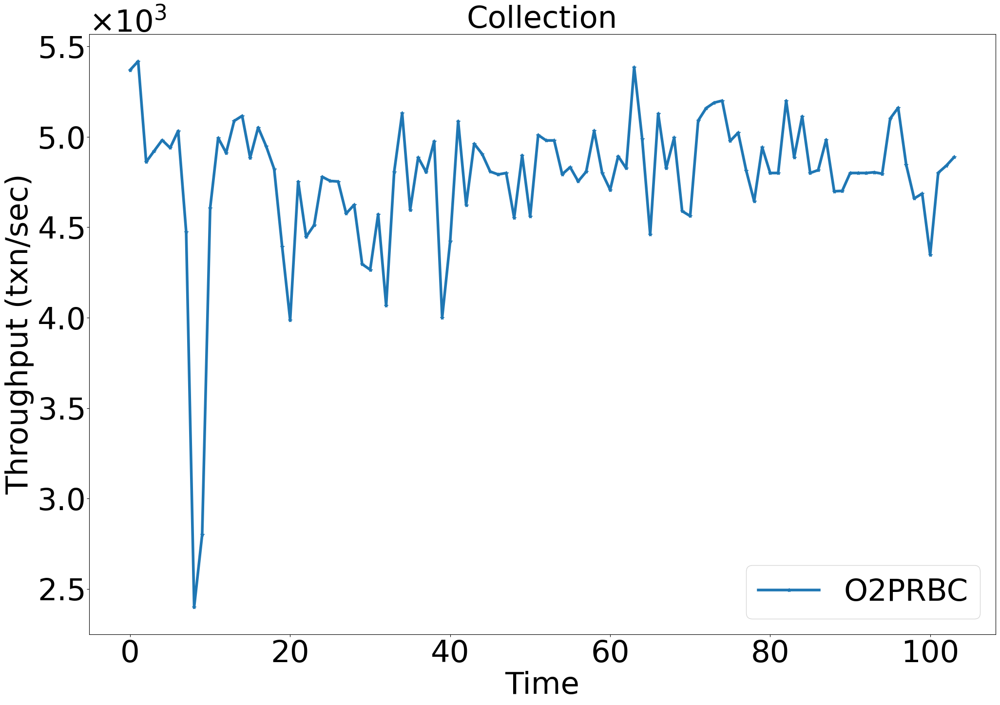

<Figure size 640x480 with 0 Axes>

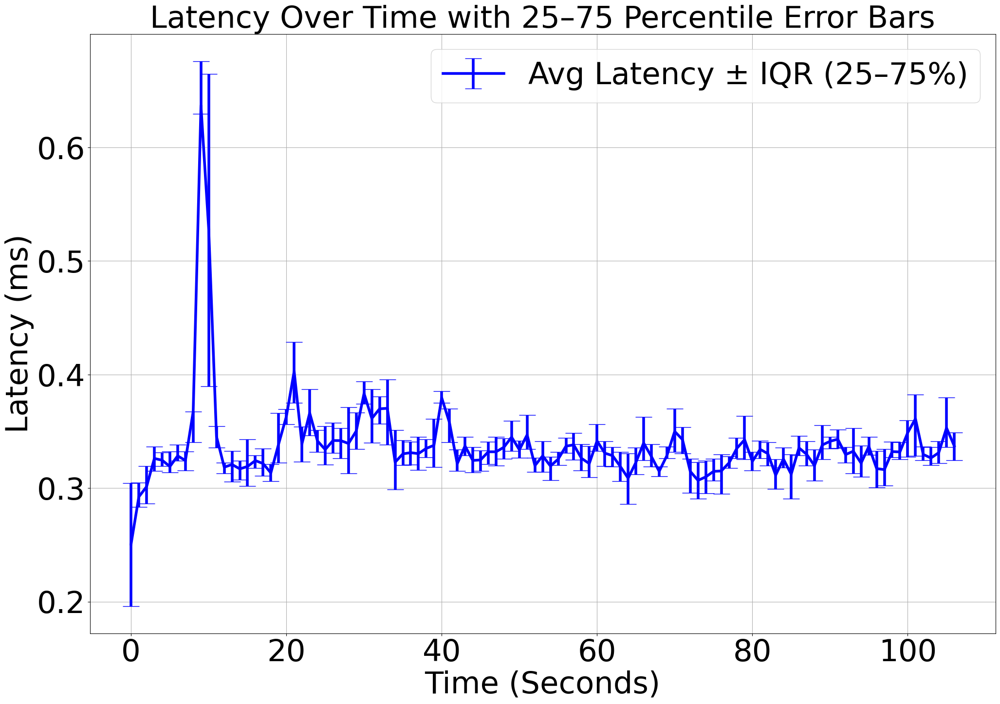

4877.672727272728 0.32906204573988673
../../Experiments/O2PRBC_multi_collect_latency48node52ms
3360.0
folder is  O2PRBC_multi_collect_latency48node52ms


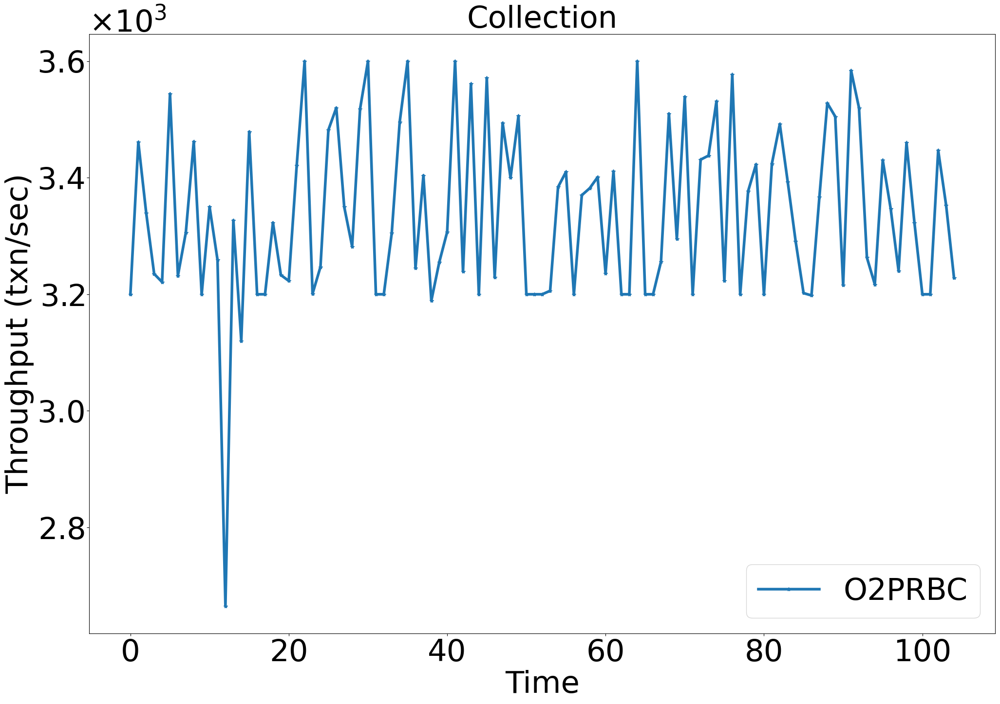

<Figure size 640x480 with 0 Axes>

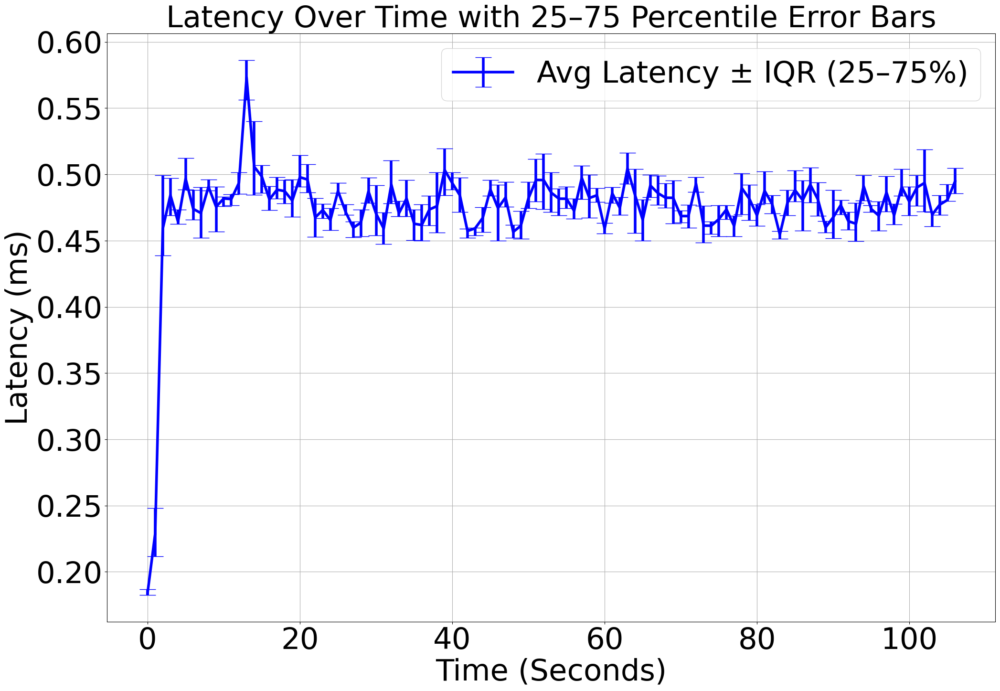

3352.7272727272725 0.47796914396449575
../../Experiments/O2PRBC_multi_collect_latency48node91ms
2128.04
folder is  O2PRBC_multi_collect_latency48node91ms


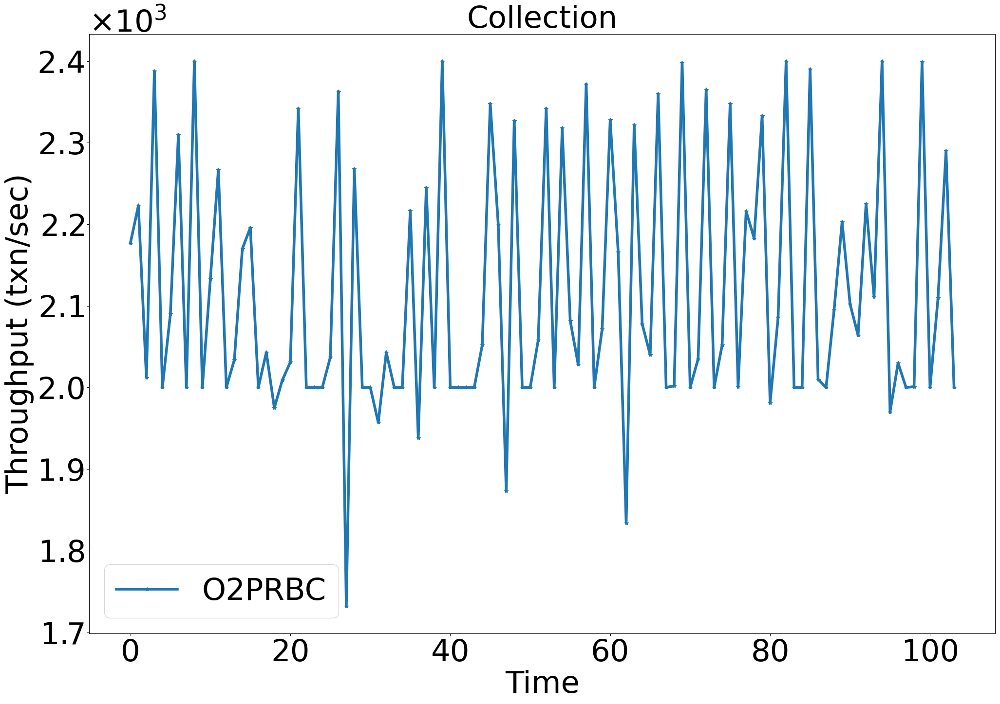

<Figure size 640x480 with 0 Axes>

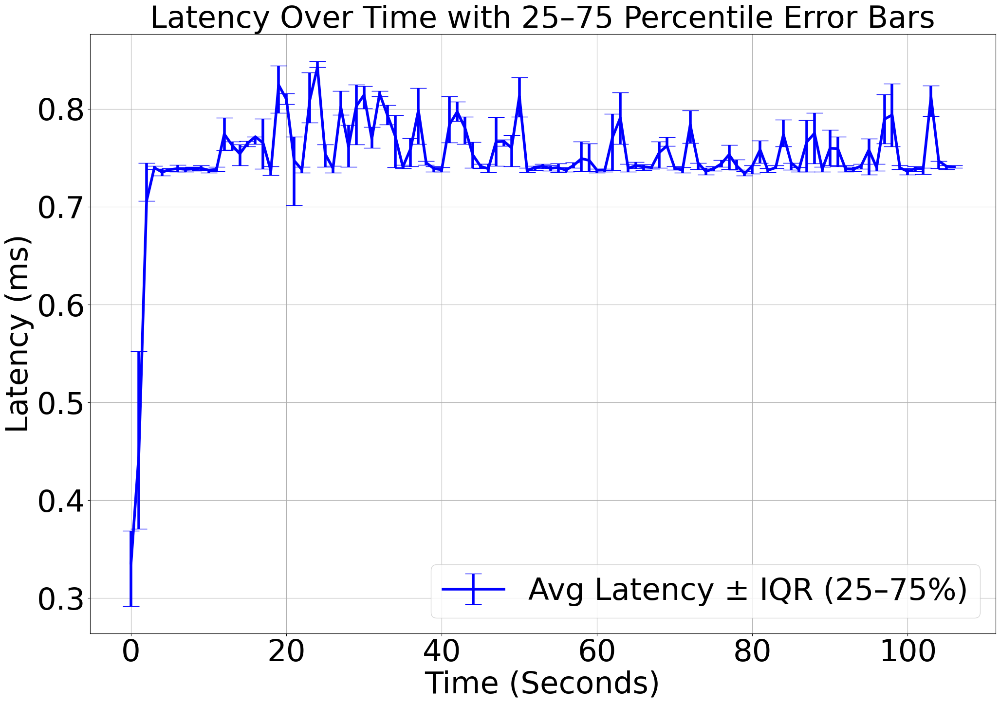

2130.927272727273 0.7507580350242015
../../Experiments/O2PRBC_multi_collect_latency48node148ms
1323.8
folder is  O2PRBC_multi_collect_latency48node148ms


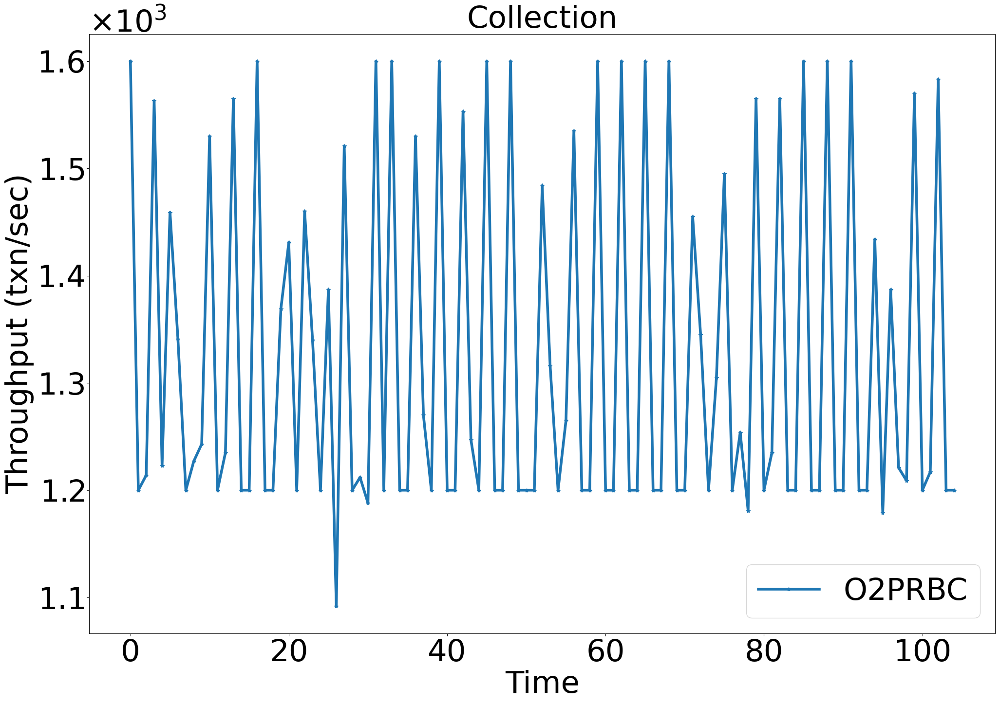

<Figure size 640x480 with 0 Axes>

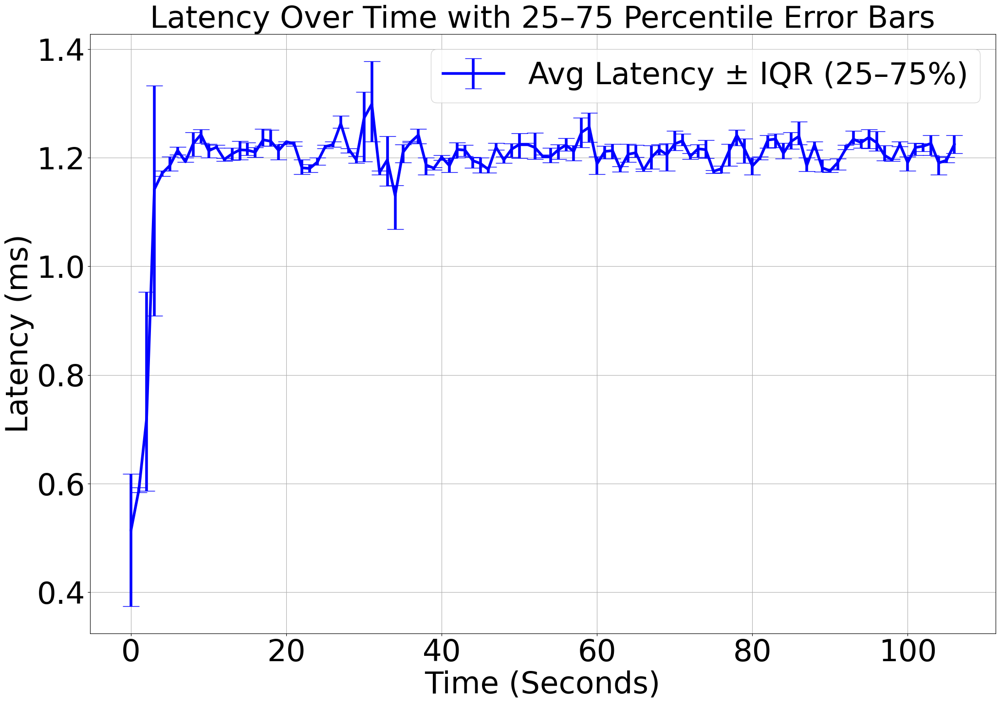

1323.6363636363637 1.2118546056386112
../../Experiments/O2PRBC_multi_collect_latency48node214ms
896.0
folder is  O2PRBC_multi_collect_latency48node214ms


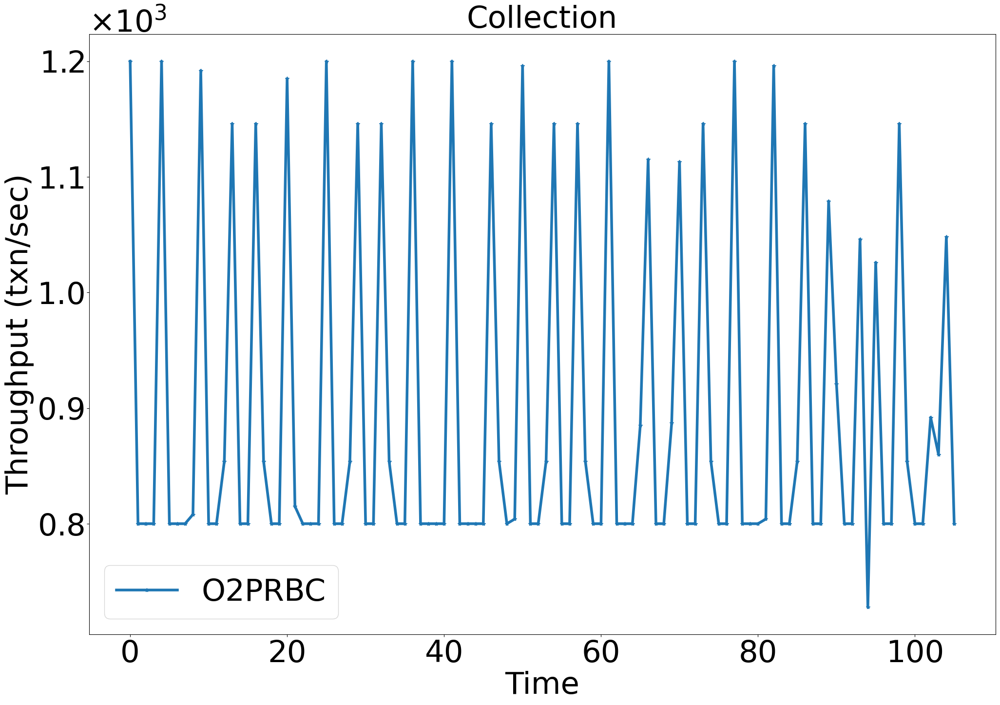

<Figure size 640x480 with 0 Axes>

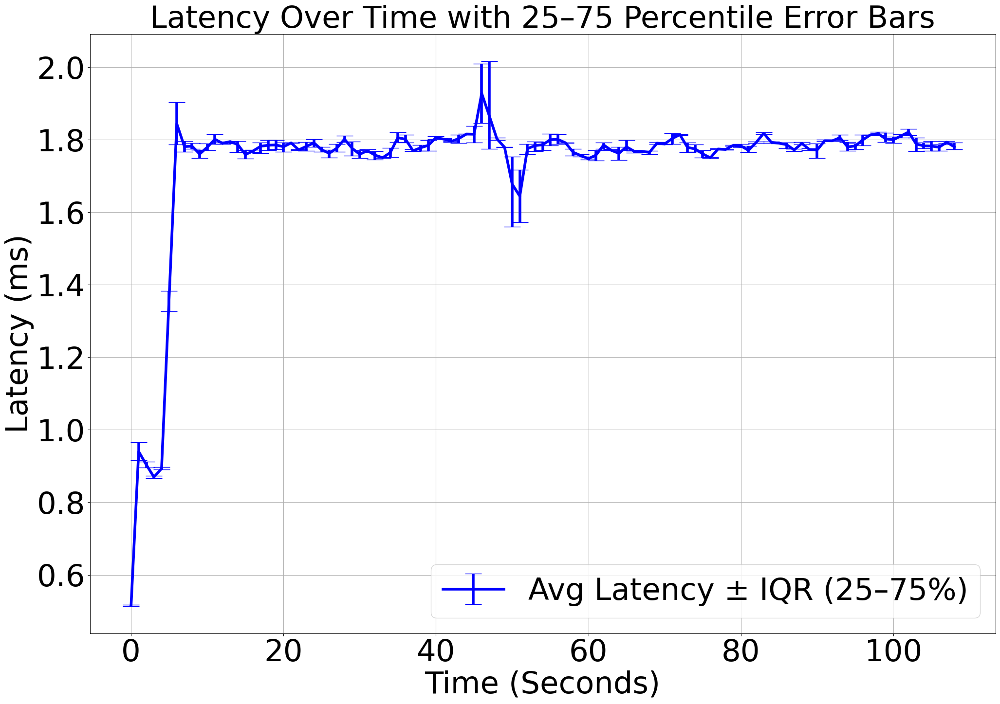

901.8181818181819 1.7799216009572114


In [43]:


all_times_1, all_times_2, all_thputs, all_lats,all_lowerr, all_higherr = [], [], [], [], [], [] 


for folder in ['O2PRBC_multi_collect_latency48node', 'O2PRBC_multi_collect_latency48node52ms', 'O2PRBC_multi_collect_latency48node91ms',\
              'O2PRBC_multi_collect_latency48node148ms','O2PRBC_multi_collect_latency48node214ms']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)

    
    
    int_times = Times.astype(int)
    min_time, max_time = int_times.min(), int_times.max()
    seconds = np.arange(min_time, max_time + 1)
    relative_seconds = seconds - seconds[0]
    
    # Group latency values by second
    latency_per_sec = defaultdict(list)
    for t, lat in zip(int_times, lats):
        latency_per_sec[t].append(lat)
    
    # Compute stats per second
    avg_latency = []
    lower_err = []  # avg - 25th
    upper_err = []  # 75th - avg
    
    for t in seconds:
        vals = latency_per_sec[t]
        if vals:
            vals = np.array(vals)
            mean = np.mean(vals)
            p25 = np.percentile(vals, 25)
            p75 = np.percentile(vals, 75)
    
            lower = max(mean - p25, 0)
            upper = max(p75 - mean, 0)
    
            avg_latency.append(mean)
            lower_err.append(lower)
            upper_err.append(upper)
        else:
            avg_latency.append(np.nan)
            lower_err.append(0)
            upper_err.append(0)
    
    # Plot with error bars
    fig, ax = pl.subplots(figsize=(24, 16))
    fig.patch.set_facecolor('white')
    
    ax.errorbar(relative_seconds, avg_latency,
                yerr=[lower_err, upper_err], fmt='o-', 
                markersize=2, linewidth=4, capsize=12,
                label="Avg Latency ± IQR (25–75%)", color='blue')
    
    pl.xlabel("Time (Seconds)")
    pl.ylabel("Latency (ms)")
    pl.title("Latency Over Time with 25–75 Percentile Error Bars")
    pl.legend()
    pl.grid(True)
    pl.show()



    print(np.average(s2[-60:-5]), np.average(avg_latency[-60:-5]))


    all_times_2.append(seconds-seconds[0])
    all_lats.append(avg_latency)
    all_lowerr.append(lower_err)
    all_higherr.append(upper_err)


        
    

In [44]:
all_lats[0][0], all_lats[1][0] 

(0.2506583266055046, 0.18395752999999998)

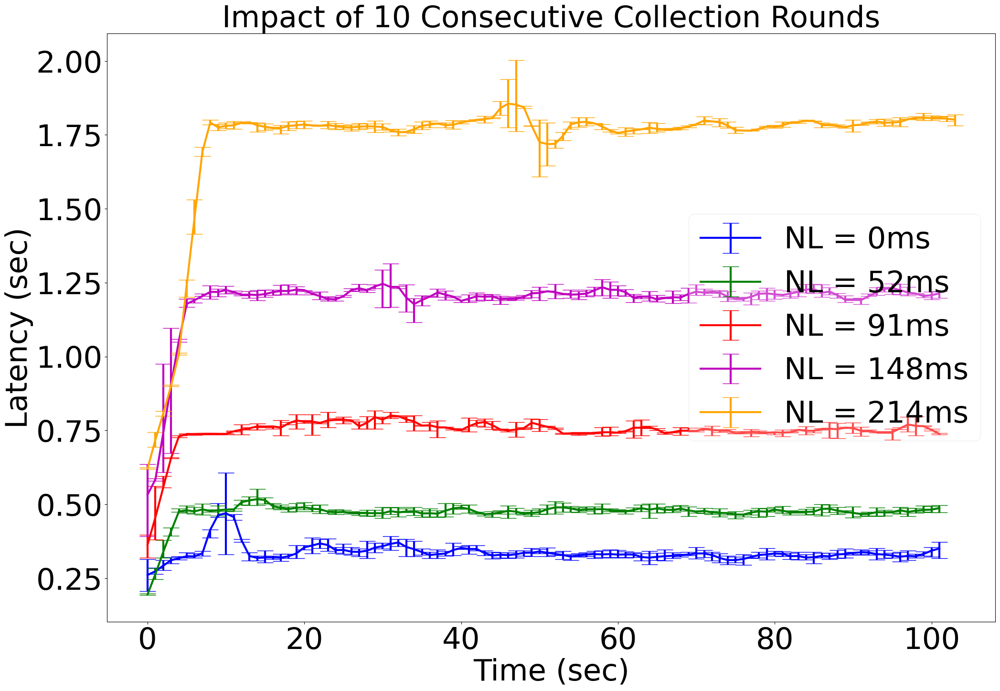

<Figure size 640x480 with 0 Axes>

In [56]:
def moving_average(y, window_size=3):
    pad_width = window_size // 2
    padded_y = np.pad(y, (pad_width, window_size - pad_width - 1), mode='edge')
    return np.convolve(padded_y, np.ones(window_size)/window_size, mode='valid')


fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['NL = 0ms', 'NL = 52ms', 'NL = 91ms', 'NL = 148ms', 'NL = 214ms']

for i in range(len(labels)):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 4
    y_smooth = moving_average(y, window_size)
    x_smooth = x#[window_size - 1:]  # Align with smoothed y

    # pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])
    pl.errorbar(x_smooth, y_smooth,
                yerr=np.array([all_lowerr[i][:-5], all_higherr[i][:-5]]), 
                markersize=2, linewidth=3, capsize=12,
                label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection_NL.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

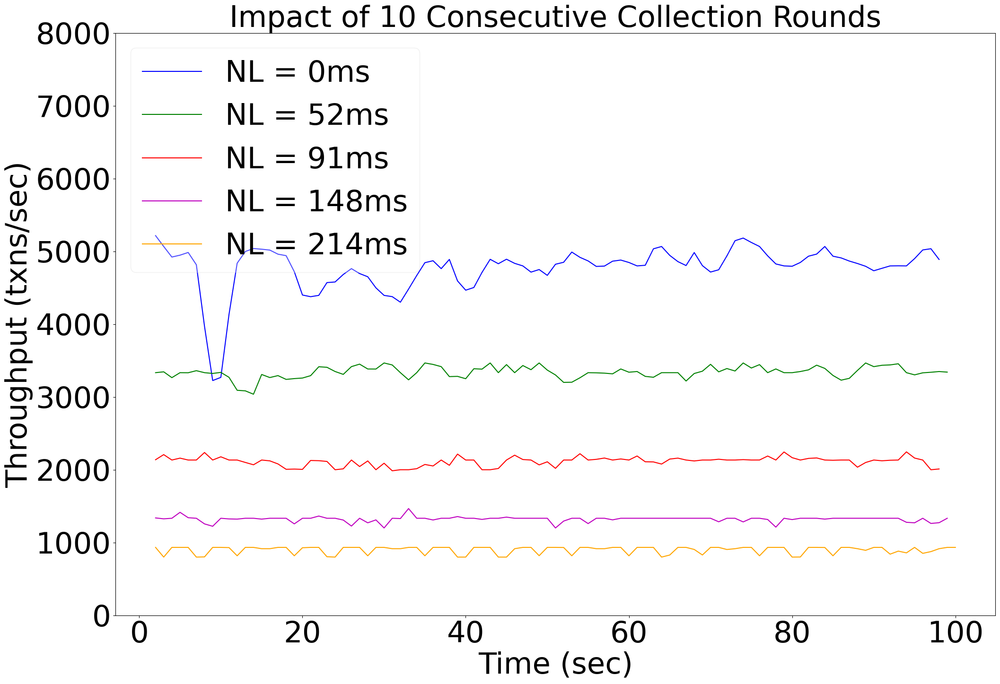

<Figure size 640x480 with 0 Axes>

In [58]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['NL = 0ms', 'NL = 52ms', 'NL = 91ms', 'NL = 148ms', 'NL = 214ms']

for i in range(len(labels)):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y


    # pl.plot(x_smooth, y_smooth/np.average(y_smooth[10:-10]), label=labels[i], color=colors[i])
    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
pl.ylim(0, 8000)
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection_NL.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


../../Experiments/O2PRBC_multi_collect_4node
11756.96
folder is  O2PRBC_multi_collect_4node


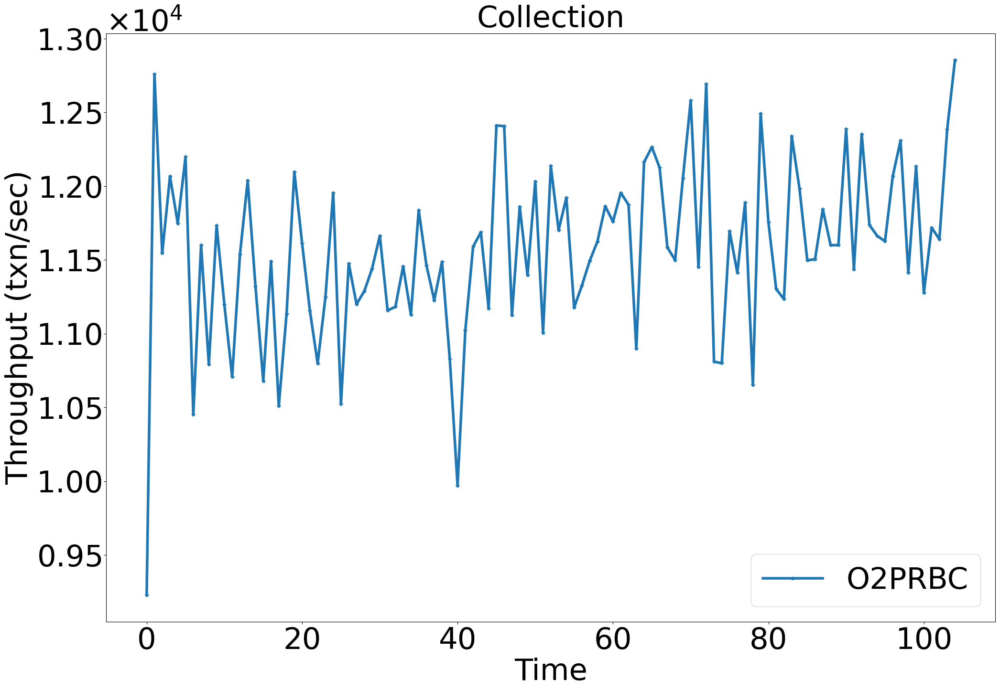

<Figure size 640x480 with 0 Axes>

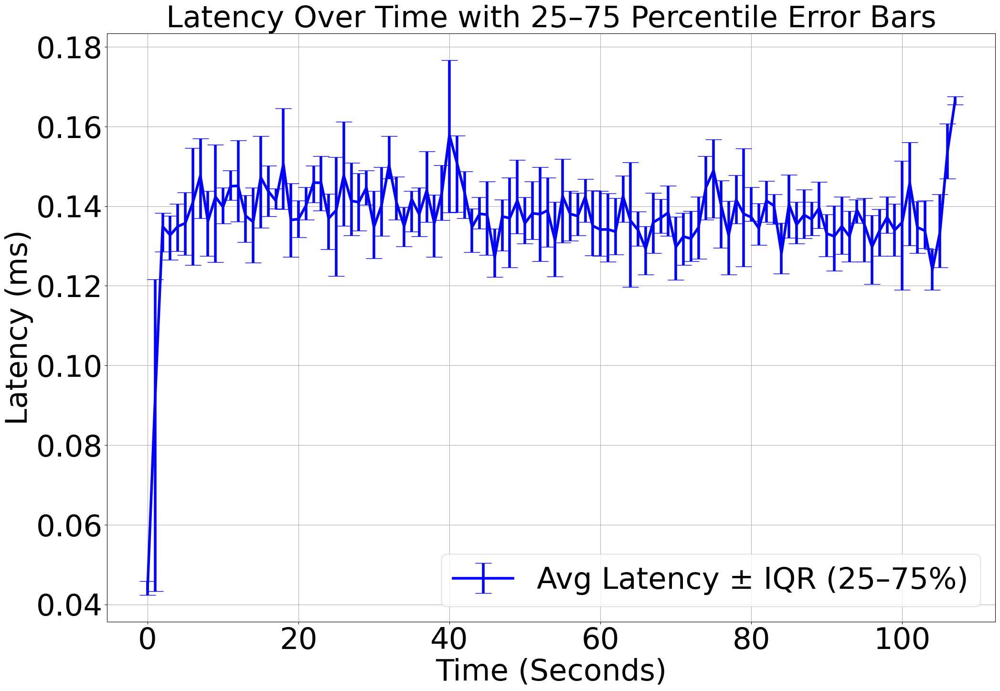

11744.072727272727 0.13665158683924733
../../Experiments/O2PRBC_multi_collect_8node
10009.36
folder is  O2PRBC_multi_collect_8node


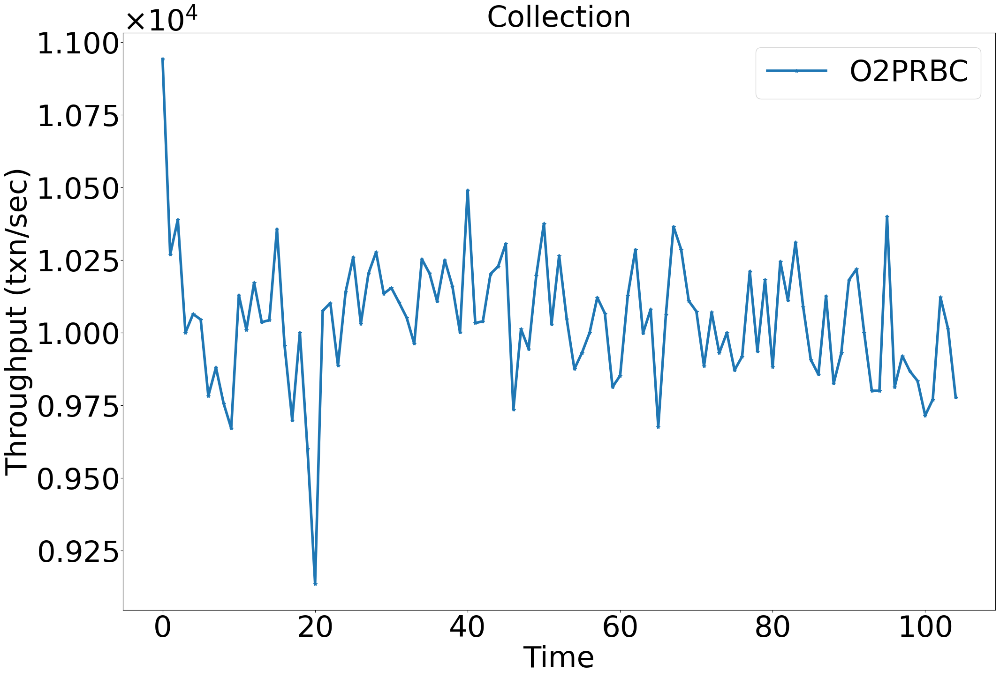

<Figure size 640x480 with 0 Axes>

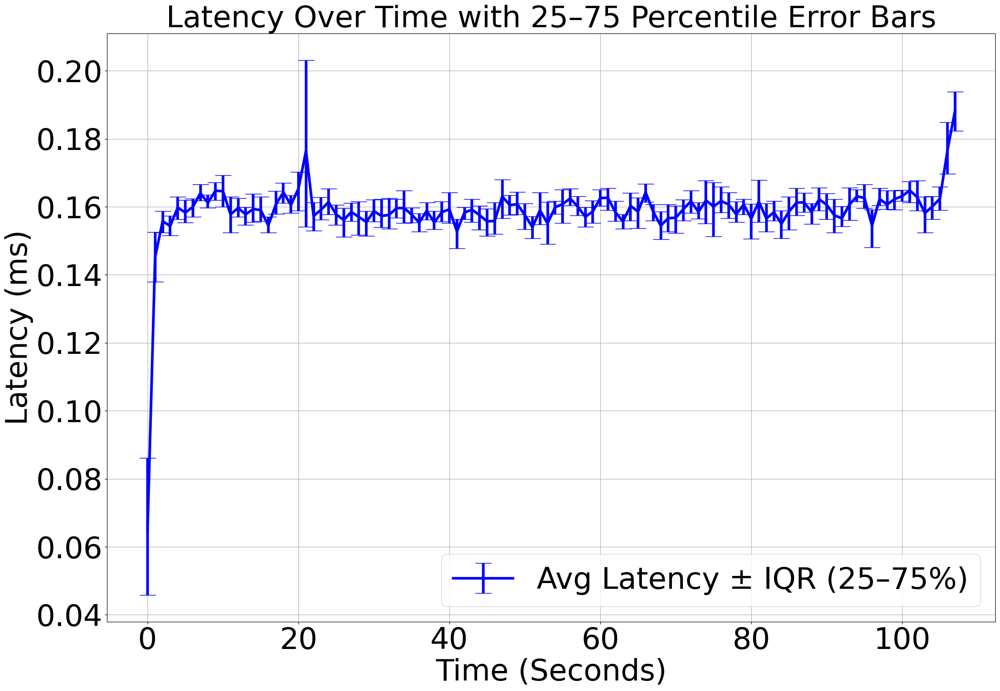

10031.781818181818 0.1595879835093802
../../Experiments/O2PRBC_multi_collect_16node
9395.2
folder is  O2PRBC_multi_collect_16node


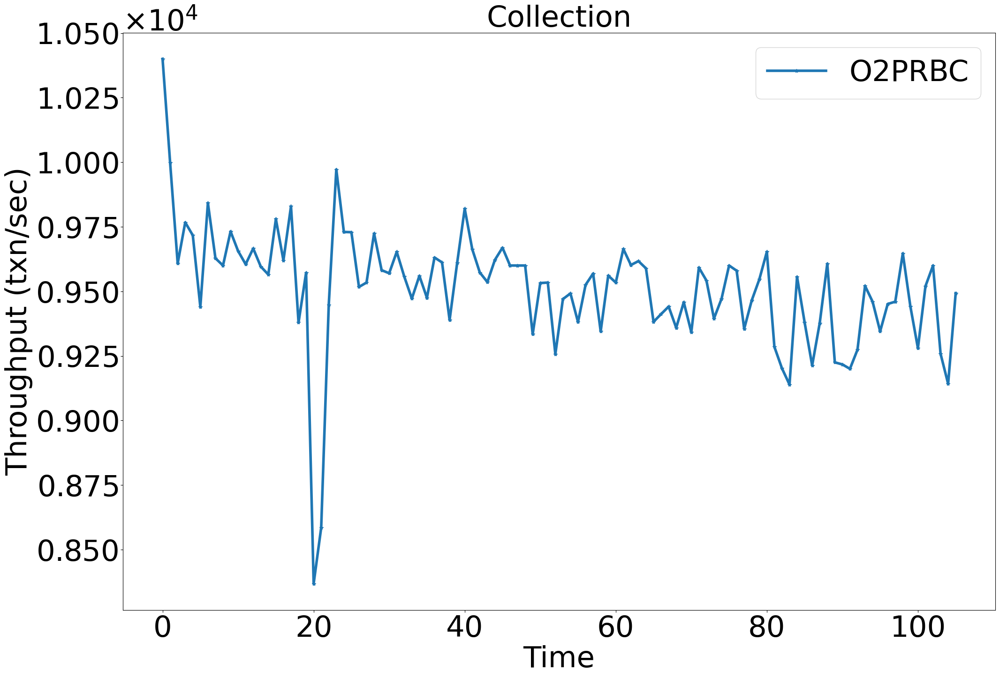

<Figure size 640x480 with 0 Axes>

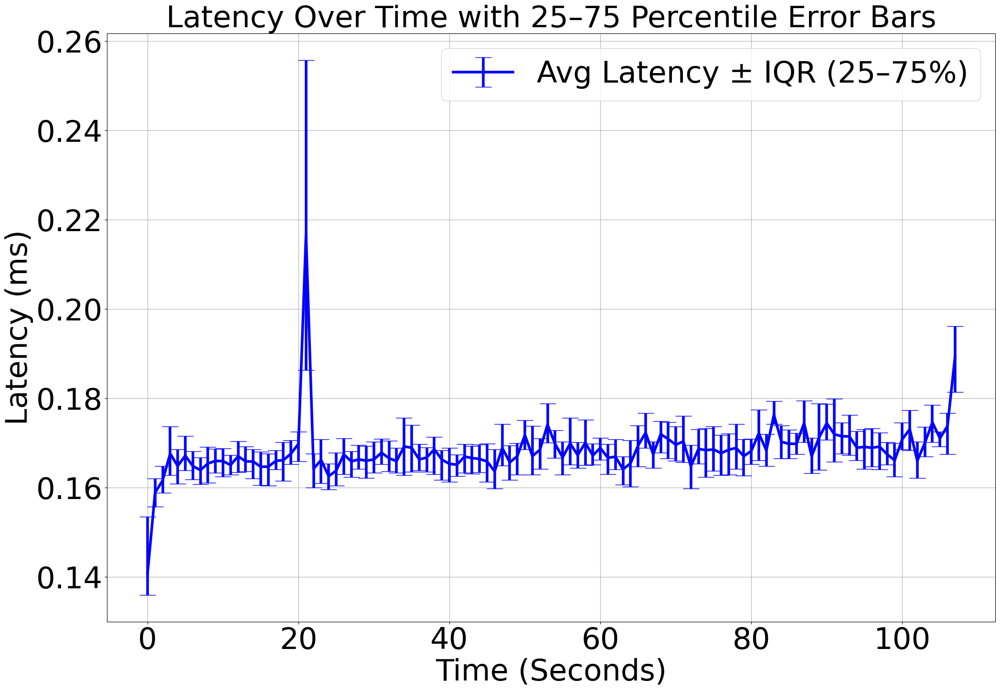

9448.727272727272 0.16924265583512726
../../Experiments/O2PRBC_multi_collect_test48
6192.0
folder is  O2PRBC_multi_collect_test48


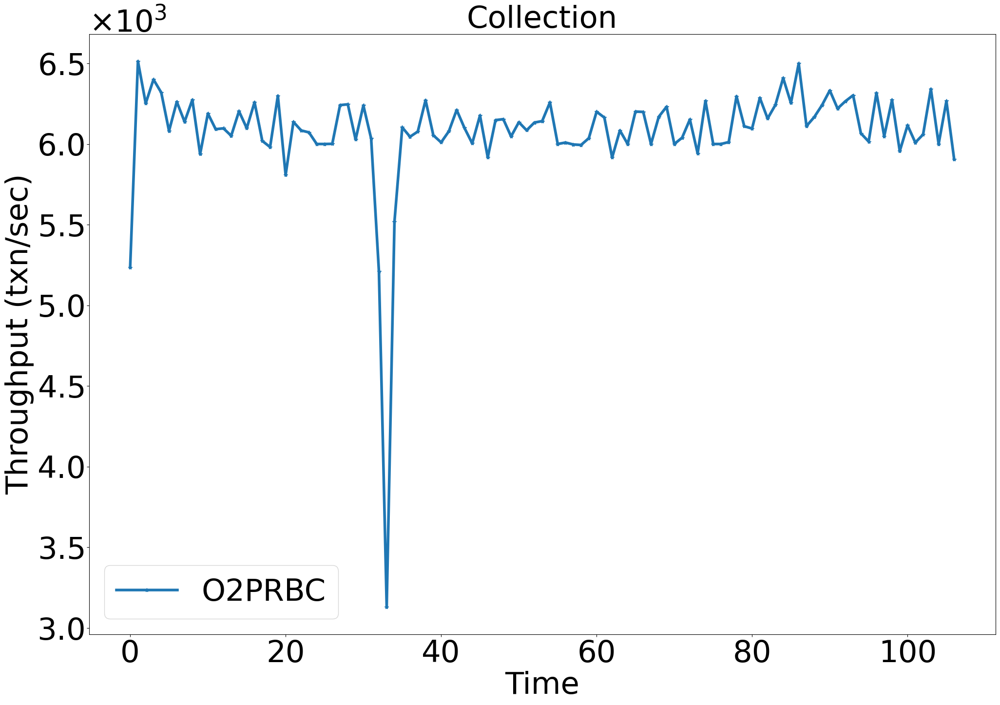

<Figure size 640x480 with 0 Axes>

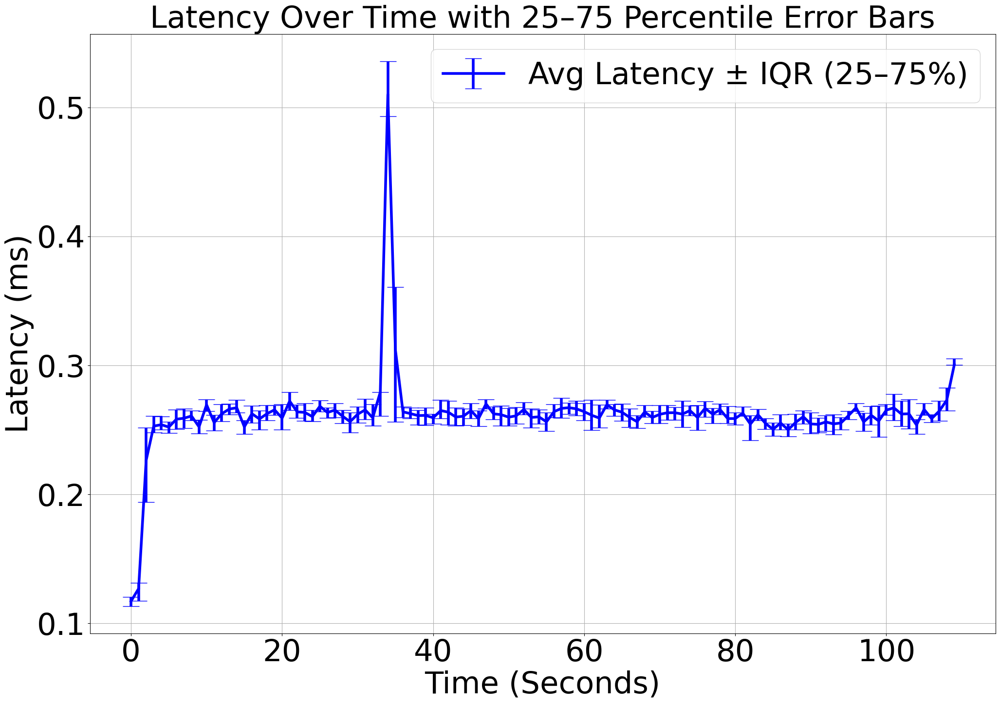

6136.4 0.26047972782525164
../../Experiments/O2PRBC_multi_collect_test96
3763.08
folder is  O2PRBC_multi_collect_test96


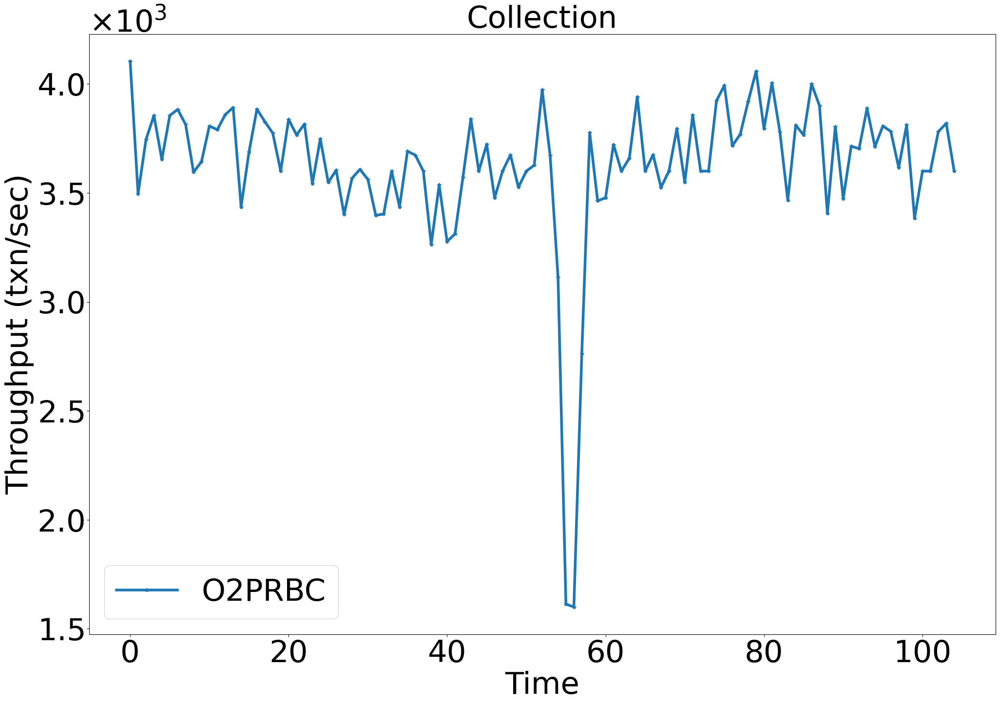

<Figure size 640x480 with 0 Axes>

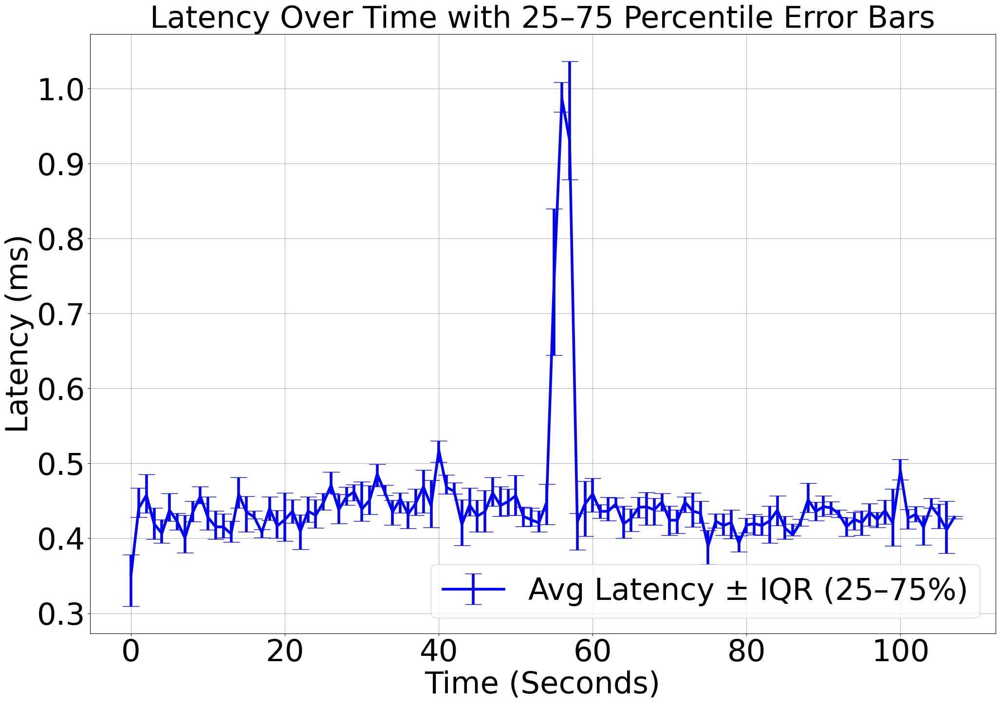

3607.2727272727275 0.4562304540822483


In [76]:
all_times_1, all_times_2, all_thputs, all_lats,all_lowerr, all_higherr = [], [], [], [], [], [] 


for folder in ['O2PRBC_multi_collect_4node',\
              'O2PRBC_multi_collect_8node',\
              'O2PRBC_multi_collect_16node',\
              'O2PRBC_multi_collect_test48',\
              'O2PRBC_multi_collect_test96']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    
    
    int_times = Times.astype(int)
    min_time, max_time = int_times.min(), int_times.max()
    seconds = np.arange(min_time, max_time + 1)
    relative_seconds = seconds - seconds[0]
    
    # Group latency values by second
    latency_per_sec = defaultdict(list)
    for t, lat in zip(int_times, lats):
        latency_per_sec[t].append(lat)
    
    # Compute stats per second
    avg_latency = []
    lower_err = []  # avg - 25th
    upper_err = []  # 75th - avg
    
    for t in seconds:
        vals = latency_per_sec[t]
        if vals:
            vals = np.array(vals)
            mean = np.mean(vals)
            # mean = np.percentile(vals, 50)
            
            p25 = np.percentile(vals, 25)
            p75 = np.percentile(vals, 75)
    
            lower = max(mean - p25, 0)
            upper = max(p75 - mean, 0)
    
            avg_latency.append(mean)
            lower_err.append(lower)
            upper_err.append(upper)
        else:
            avg_latency.append(np.nan)
            lower_err.append(0)
            upper_err.append(0)
    
    # Plot with error bars
    fig, ax = pl.subplots(figsize=(24, 16))
    fig.patch.set_facecolor('white')
    
    ax.errorbar(relative_seconds, avg_latency,
                yerr=[lower_err, upper_err], fmt='o-', 
                markersize=2, linewidth=4, capsize=12,
                label="Avg Latency ± IQR (25–75%)", color='blue')
    
    pl.xlabel("Time (Seconds)")
    pl.ylabel("Latency (ms)")
    pl.title("Latency Over Time with 25–75 Percentile Error Bars")
    pl.legend()
    pl.grid(True)
    pl.show()



    print(np.average(s2[-60:-5]), np.average(avg_latency[-60:-5]))


    all_times_2.append(seconds-seconds[0])
    all_lats.append(avg_latency)
    all_lowerr.append(lower_err)
    all_higherr.append(upper_err)


        
    

In [ ]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['n = 4', 'n = 8', 'n = 16', 'n = 48', 'n = 96']

for i in range(5):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 2
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_collection.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


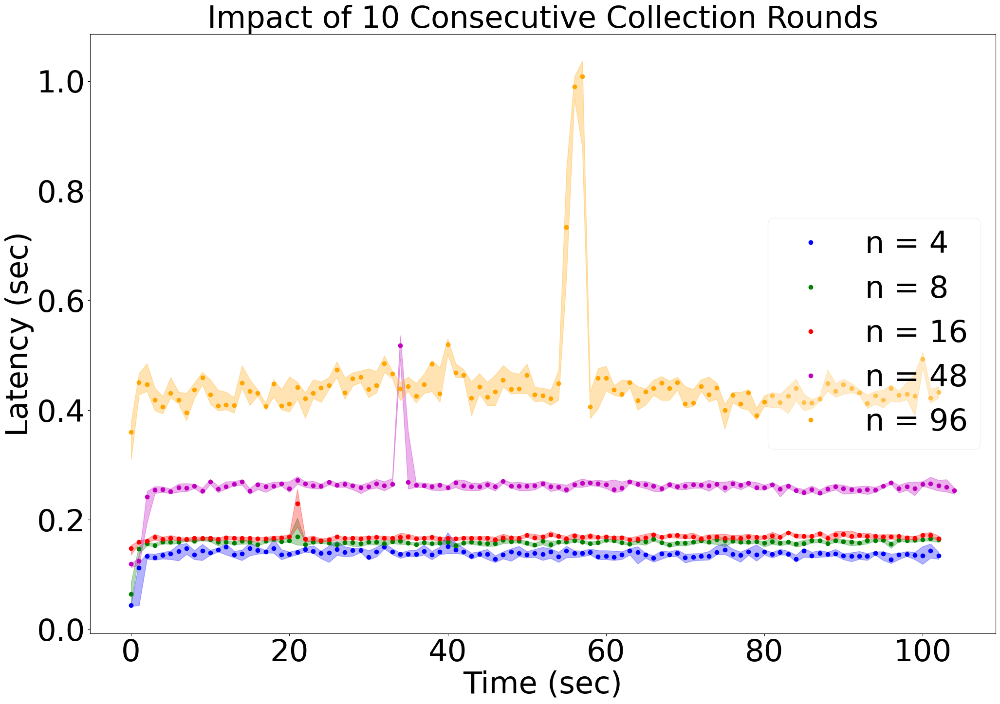

<Figure size 640x480 with 0 Axes>

In [75]:

def moving_average(y, window_size=3):
    pad_width = window_size // 2
    padded_y = np.pad(y, (pad_width, window_size - pad_width - 1), mode='edge')
    return np.convolve(padded_y, np.ones(window_size)/window_size, mode='valid')


colors = ['b', 'g', 'r', 'm', 'orange']
labels = ['n = 4', 'n = 8', 'n = 16', 'n = 48', 'n = 96']



fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

for i in range(5):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 1
    y_smooth = moving_average(y, window_size)
    x_smooth = x#[window_size - 1:]  # Align with smoothed y

    pl.plot(x_smooth, y_smooth, 'o', label=labels[i], color=colors[i])
    # pl.errorbar(x_smooth, y_smooth,
    #             yerr=np.array([all_lowerr[i][:-5], all_higherr[i][:-5]]), 
    #             markersize=2, linewidth=3, capsize=12,
    #             label=labels[i], color=colors[i])
    pl.fill_between(x_smooth, y_smooth - all_lowerr[i][:-5],y_smooth + all_higherr[i][:-5],color=colors[i], alpha=0.3)

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.title('Impact of 10 Consecutive Collection Rounds')
# pl.axvline(107 - 67, ls='--')
# pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend(loc='right', framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_collection.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_multi_collect_16node1round
8888.48
folder is  O2PRBC_multi_collect_16node1round


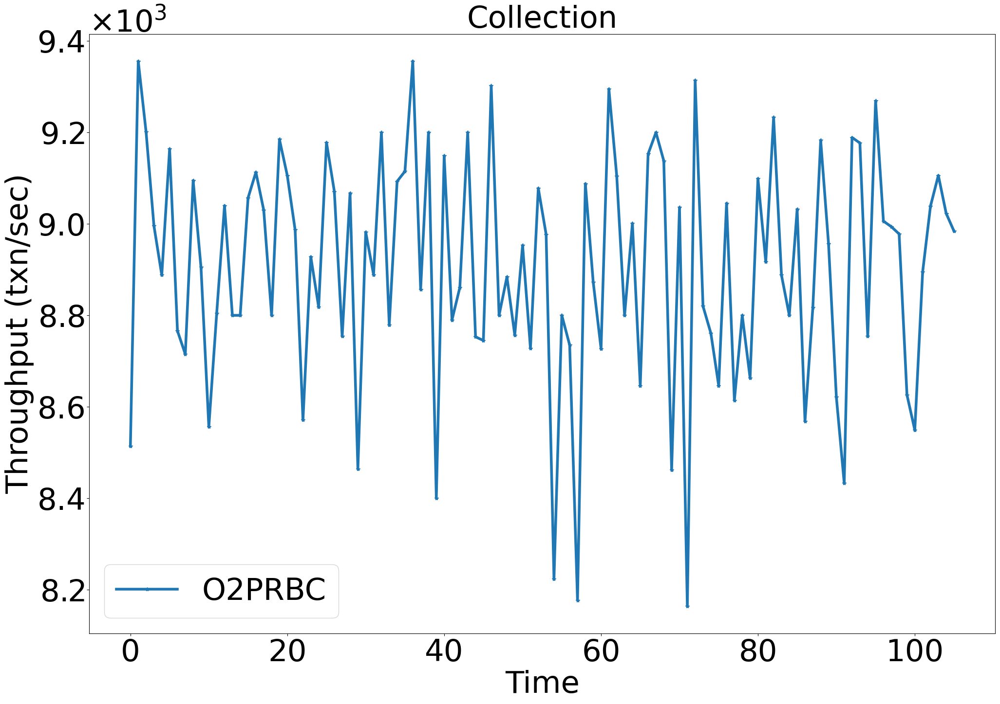

<Figure size 640x480 with 0 Axes>

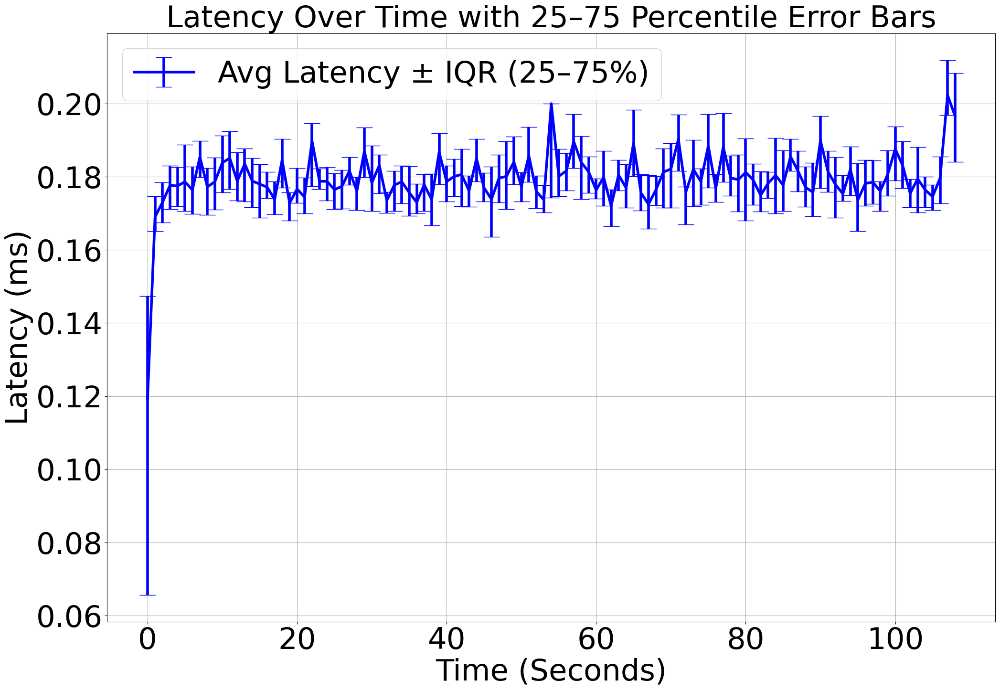

8870.09090909091 0.1804931515032919


In [62]:
all_times_1, all_times_2, all_thputs, all_lats,all_lowerr, all_higherr = [], [], [], [], [], [] 

# for folder in ['all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

# for folder in ['O2PRBC_multi_collect_16node1round',\
#               'O2PRBC_multi_collect_16node10round',\
#               'O2PRBC_multi_collect_16node50round',\
#               'O2PRBC_multi_collect_16node100round']:
    
for folder in ['O2PRBC_multi_collect_16node1round']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    
    int_times = Times.astype(int)
    min_time, max_time = int_times.min(), int_times.max()
    seconds = np.arange(min_time, max_time + 1)
    relative_seconds = seconds - seconds[0]
    
    # Group latency values by second
    latency_per_sec = defaultdict(list)
    for t, lat in zip(int_times, lats):
        latency_per_sec[t].append(lat)
    
    # Compute stats per second
    avg_latency = []
    lower_err = []  # avg - 25th
    upper_err = []  # 75th - avg
    
    for t in seconds:
        vals = latency_per_sec[t]
        if vals:
            vals = np.array(vals)
            mean = np.mean(vals)
            # mean = np.percentile(vals, 50)
            
            p25 = np.percentile(vals, 25)
            p75 = np.percentile(vals, 75)
    
            lower = max(mean - p25, 0)
            upper = max(p75 - mean, 0)
    
            avg_latency.append(mean)
            lower_err.append(lower)
            upper_err.append(upper)
        else:
            avg_latency.append(np.nan)
            lower_err.append(0)
            upper_err.append(0)
    
    # Plot with error bars
    fig, ax = pl.subplots(figsize=(24, 16))
    fig.patch.set_facecolor('white')
    
    ax.errorbar(relative_seconds, avg_latency,
                yerr=[lower_err, upper_err], fmt='o-', 
                markersize=2, linewidth=4, capsize=12,
                label="Avg Latency ± IQR (25–75%)", color='blue')
    
    pl.xlabel("Time (Seconds)")
    pl.ylabel("Latency (ms)")
    pl.title("Latency Over Time with 25–75 Percentile Error Bars")
    pl.legend()
    pl.grid(True)
    pl.show()



    print(np.average(s2[-60:-5]), np.average(avg_latency[-60:-5]))


    all_times_2.append(seconds-seconds[0])
    all_lats.append(avg_latency)
    all_lowerr.append(lower_err)
    all_higherr.append(upper_err)


        
    

In [64]:
print(np.average(np.array(latency_per_sec[78317+22])), np.average(np.array(latency_per_sec[78317+50])))
# latency_per_sec

0.18981272240644242 0.17734644475602918


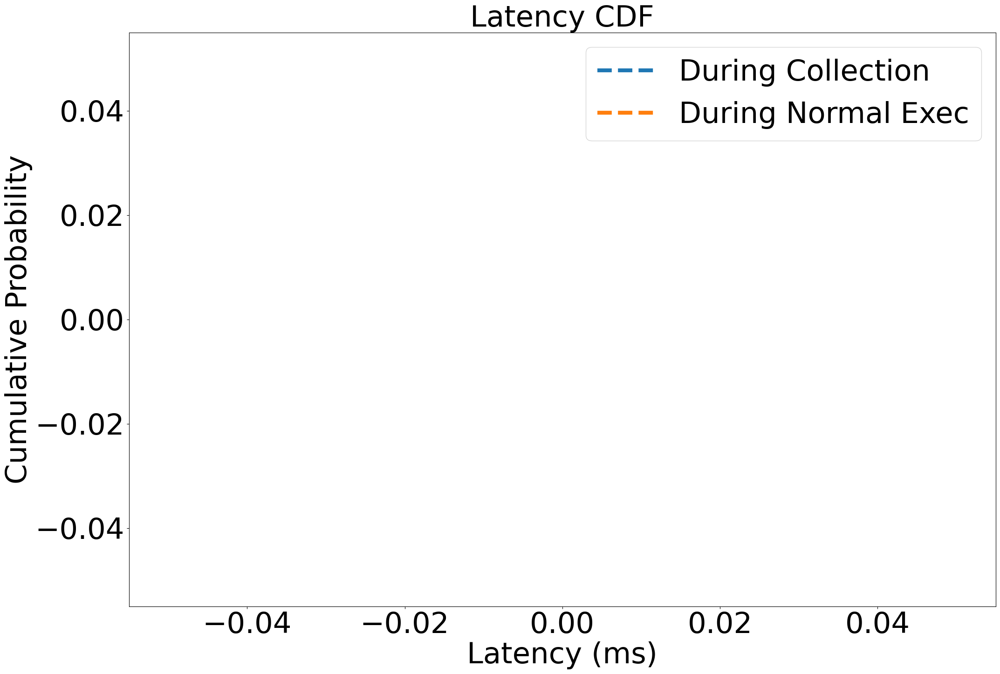

In [65]:
# Step 1: Sort the latencies
latencies_sorted = np.sort(np.array(latency_per_sec[78905+26]))

# Step 2: Compute the cumulative probabilities
cdf = np.arange(1, len(latencies_sorted)+1) / len(latencies_sorted)


# Step 1: Sort the latencies
latencies_sorted2 = np.sort(np.array(latency_per_sec[78905+50]))

# Step 2: Compute the cumulative probabilities
cdf2 = np.arange(1, len(latencies_sorted2)+1) / len(latencies_sorted2)


# Step 3: Plot
pl.figure(figsize=(24, 16))
pl.plot(latencies_sorted, cdf, '--', lw = 6, label= 'During Collection')
pl.plot(latencies_sorted2, cdf2, '--', lw = 6, label= 'During Normal Exec')

pl.xlabel('Latency (ms)')
pl.ylabel('Cumulative Probability')
pl.title('Latency CDF')
pl.legend()

pl.savefig('/home/tejas/Desktop/CDF2.png', dpi = 150, bbox_inches = 'tight')

# pl.grid(True)
pl.show()



# # Step 3: Plot
# pl.figure(figsize=(24, 16))
# # pl.plot(latencies_sorted, cdf, '--', label= 'During Collection')
# pl.plot(latencies_sorted2, cdf2, '--', label= 'During Normal Exec')

# pl.xlabel('Latency (ms)')
# pl.ylabel('Cumulative Probability')
# pl.title('Latency CDF')
# pl.legend()
# pl.savefig('/home/tejas/Desktop/CDF1.png', dpi = 150, bbox_inches = 'tight')

# # pl.grid(True)
# pl.show()

In [53]:
from statsmodels.distributions.empirical_distribution import ECDF

ecdf = ECDF(np.array(latency_per_sec[78905+26]))
ecdf2 = ECDF(np.array(latency_per_sec[78905+50]))


pl.figure(figsize=(24, 16))
pl.step(ecdf.x, ecdf.y, where='post', label = 'During Collection')
# pl.step(ecdf2.x, ecdf2.y, where='post')

pl.xlabel('Latency (ms)')
pl.ylabel('Cumulative Probability')
pl.title('Latency CDF (Empirical)')
pl.grid(True)
pl.legend()
pl.savefig('/home/tejas/Desktop/CDF1.png', dpi = 150, bbox_inches = 'tight')

pl.show()

pl.figure(figsize=(24, 16))
# pl.step(ecdf.x, ecdf.y, where='post')
pl.step(ecdf2.x, ecdf2.y, where='post', label = 'Normal Exec')

pl.xlabel('Latency (ms)')
pl.ylabel('Cumulative Probability')
pl.title('Latency CDF (Empirical)')
pl.grid(True)
pl.legend()
pl.savefig('/home/tejas/Desktop/CDF2.png', dpi = 150, bbox_inches = 'tight')

pl.show()



ZeroDivisionError: float division by zero

In [ ]:
# Simple Moving Average Function
def moving_average(y, window_size=3):
    return np.convolve(y, np.ones(window_size)/window_size, mode='valid')

fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['1 round collection', '10 round collection', '50 round collection', '100 round collection']

for i in range(4):
    x = np.array(all_times_1[i][:-5])
    y = np.array(all_thputs[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x[window_size - 1:]  # align x with smoothed y

    pl.plot(x_smooth, y_smooth, label=labels[i], color=colors[i])

pl.xlabel('Time (sec)')
pl.ylabel('Throughput (txns/sec)')
pl.axvline(107 - 67, ls='--')
pl.axvline(105 - 88, ls='--')
pl.legend(framealpha=0.3)
pl.savefig('/home/tejas/Desktop/thputs_multiround.png', dpi = 150, bbox_inches = 'tight')
pl.show()
pl.clf()


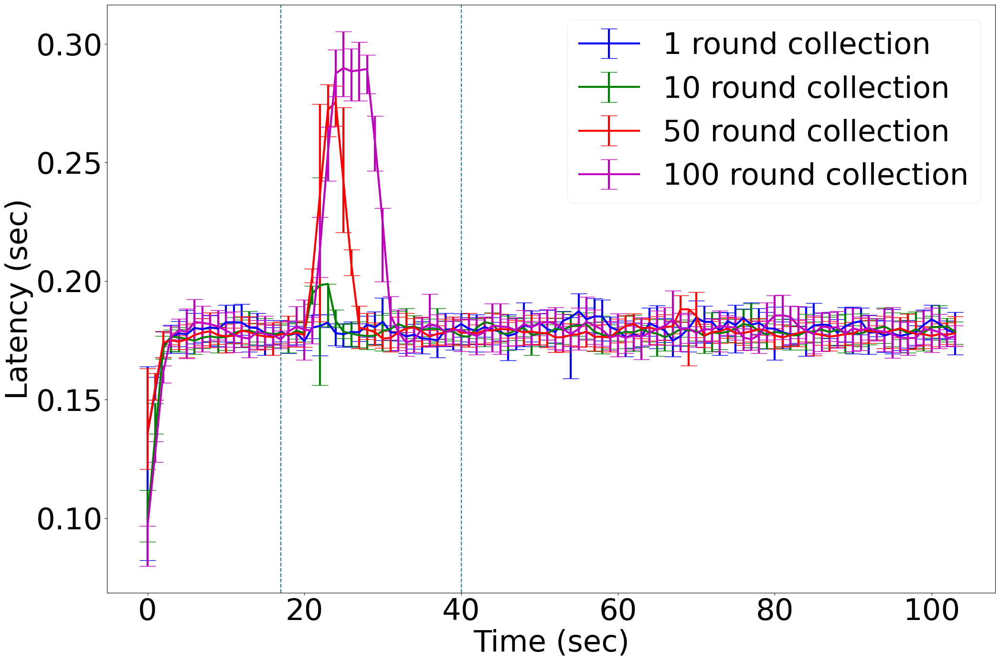

<Figure size 640x480 with 0 Axes>

In [79]:

def moving_average(y, window_size=3):
    pad_width = window_size // 2
    padded_y = np.pad(y, (pad_width, window_size - pad_width - 1), mode='edge')
    return np.convolve(padded_y, np.ones(window_size)/window_size, mode='valid')




fig, ax = pl.subplots(figsize=(24, 16))
fig.patch.set_facecolor('white')

colors = ['b', 'g', 'r', 'm']
labels = ['1 round collection', '10 round collection', '50 round collection', '100 round collection']

for i in range(4):
    x = np.array(all_times_2[i][:-5])
    y = np.array(all_lats[i][:-5])

    window_size = 3
    y_smooth = moving_average(y, window_size)
    x_smooth = x#[window_size - 1:]  # Align with smoothed y

    # pl.plot(x_smooth, y_smooth, 'o', label=labels[i], color=colors[i])
    pl.errorbar(x_smooth, y_smooth,
                yerr=np.array([all_lowerr[i][:-5], all_higherr[i][:-5]]), 
                markersize=2, linewidth=3, capsize=12,
                label=labels[i], color=colors[i])
    # pl.fill_between(x_smooth, y_smooth - all_lowerr[i][:-5],y_smooth + all_higherr[i][:-5],color=colors[i], alpha=0.3)

pl.xlabel('Time (sec)')
pl.ylabel('Latency (sec)')
pl.axvline(107 - 67, ls='--')
pl.axvline(105 - 88, ls='--')
# pl.axvline(111 - 70, ls='--', label='48')

pl.legend( framealpha=0.3)
pl.savefig('/home/tejas/Desktop/lats_multiround.png', dpi = 150, bbox_inches = 'tight')

pl.show()
pl.clf()

../../Experiments/O2PRBC_normal_converted_4node
9883.64
folder is  O2PRBC_normal_converted_4node


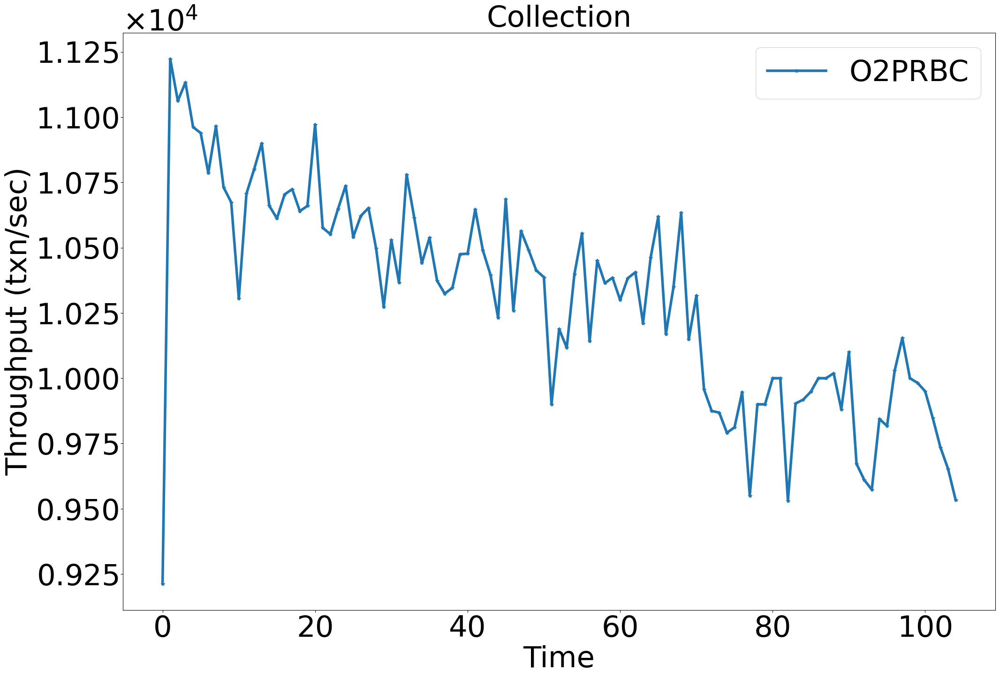

<Figure size 640x480 with 0 Axes>

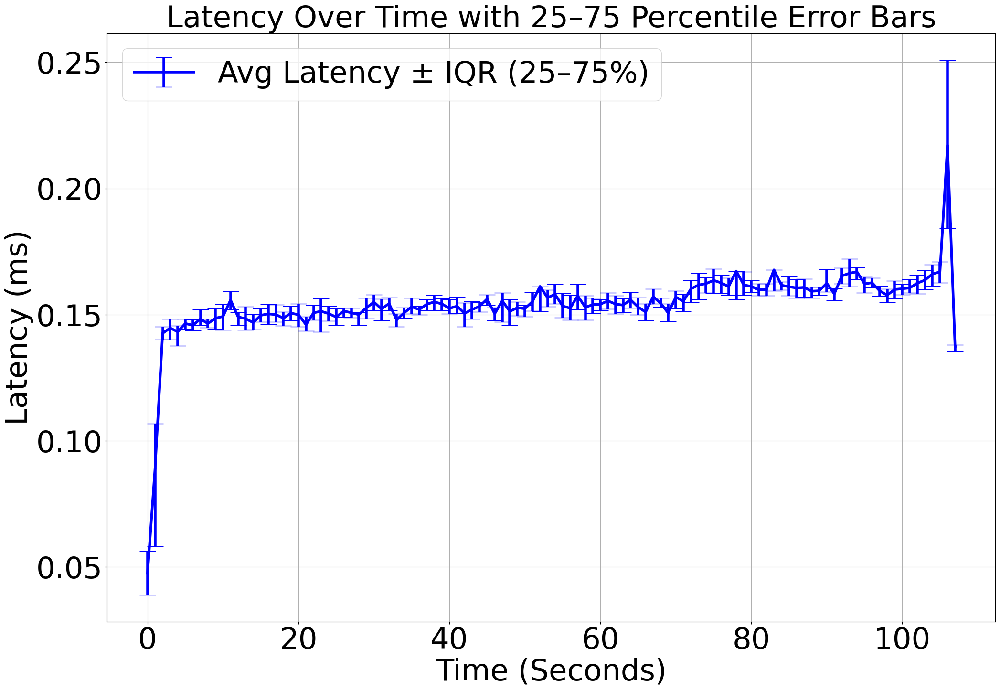

10106.945454545454 0.1586746102466762


In [15]:
all_times_1, all_times_2, all_thputs, all_lats,all_lowerr, all_higherr = [], [], [], [], [], [] 

# for folder in ['all_times_1, all_times_2, all_thputs, all_lats = [], [], [], [] 

for folder in ['O2PRBC_normal_converted_4node']:

# for folder in [\
#               'O2PRBC_normal_converted_16node']:
        


    experiment = '../../Experiments/' + folder 
    print(experiment)
    X,Y, lats, temp, Times = getThroughput(experiment)



#         cluster_number = 

    # Y = Y * cluster_number

    lats

    np.sum(Y)

    s1, s2 = X[:-2],Y[:-2]

    print(np.average(s2[-30:-5]))
    np.average(lats[-33:-3])

    len(lats)

    2*18923.433333333334


    experiment = folder
    print('folder is ', folder)

    if not os.path.exists('../../../Experiments/'+experiment):
        os.mkdir('../../../Experiments/'+experiment)


    fig,ax = pl.subplots(figsize = (24, 16))
    fig.patch.set_facecolor('white')
    fig.patch.set_facecolor('white')
    pl.plot(s1,s2, '-*', label = 'O2PRBC', linewidth = 4)
    ax.yaxis.set_major_formatter(formatter)

    pl.legend()
    pl.xlabel('Time')
    pl.ylabel('Throughput (txn/sec)')
    pl.title('Collection')

#         pl.ylim(8000,14000)
#     pl.savefig('/home/tejas/Desktop/O2PRBC/collectthputsV2.png', dpi = 150, bbox_inches='tight' )
    pl.show()
    pl.clf()

    all_times_1.append(s1)
    all_thputs.append(s2)


    
    int_times = Times.astype(int)
    min_time, max_time = int_times.min(), int_times.max()
    seconds = np.arange(min_time, max_time + 1)
    relative_seconds = seconds - seconds[0]
    
    # Group latency values by second
    latency_per_sec = defaultdict(list)
    for t, lat in zip(int_times, lats):
        latency_per_sec[t].append(lat)
    
    # Compute stats per second
    avg_latency = []
    lower_err = []  # avg - 25th
    upper_err = []  # 75th - avg
    
    for t in seconds:
        vals = latency_per_sec[t]
        if vals:
            vals = np.array(vals)
            mean = np.mean(vals)
            # mean = np.percentile(vals, 50)
            
            p25 = np.percentile(vals, 25)
            p75 = np.percentile(vals, 75)
    
            lower = max(mean - p25, 0)
            upper = max(p75 - mean, 0)
    
            avg_latency.append(mean)
            lower_err.append(lower)
            upper_err.append(upper)
        else:
            avg_latency.append(np.nan)
            lower_err.append(0)
            upper_err.append(0)
    
    # Plot with error bars
    fig, ax = pl.subplots(figsize=(24, 16))
    fig.patch.set_facecolor('white')
    
    ax.errorbar(relative_seconds, avg_latency,
                yerr=[lower_err, upper_err], fmt='o-', 
                markersize=2, linewidth=4, capsize=12,
                label="Avg Latency ± IQR (25–75%)", color='blue')
    
    pl.xlabel("Time (Seconds)")
    pl.ylabel("Latency (ms)")
    pl.title("Latency Over Time with 25–75 Percentile Error Bars")
    pl.legend()
    pl.grid(True)
    pl.show()



    print(np.average(s2[-60:-5]), np.average(avg_latency[-60:-5]))


    all_times_2.append(seconds-seconds[0])
    all_lats.append(avg_latency)
    all_lowerr.append(lower_err)
    all_higherr.append(upper_err)


        
    

In [16]:
7917, 3934,  3190
0.20, 0.40, 0.50

(0.2, 0.4, 0.5)